## Compute graph metrics 
### Used in Jimenez et al., 2020

### Jack Berry
### 2/15/2020

In [7]:
import os
import sys
sys.path.append(os.path.abspath(os.path.join("../..")))

import itertools
#import scipy as ss
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
#from sklearn import cluster
#from analysis.entropy import *
from analysis.analysis_utils import Mouse, find_file
#from analysis.resampling import Resampler
#from analysis.sig_proc import Deconvoluter
from analysis.graph_analysis_utils import NeuronNetwork
from IPython.core.interactiveshell import InteractiveShell

In [3]:
%matplotlib inline
InteractiveShell.ast_node_interactivity = "all"
#plt.style.use('C:/Users/berryja/Hen_Lab/jebstyle.mplstyle')

In [4]:
#Function to return dictionary of weights given a dataframe correlation matrix

def corrdf_to_dict(dataframe,cutoff):
    connections = {}
    
    for neuron_pair in itertools.combinations(dataframe.columns, 2):
       
        #corrcoef = np.corrcoef(dataframe[neuron_pair[0]].values, dataframe[neuron_pair[1]].values)[0][1]
        
        #need to subtract 1, since the column names start at 1
        corrcoef = dataframe.loc[neuron_pair[0],neuron_pair[1]]
        if corrcoef >= cutoff:
            connections[neuron_pair] = corrcoef
        
    return connections

## Import Correlation Matrices into Dictionary of Dataframes

### Correlation Matrices are created by correlated_pairs_Rthresh.m script and saved as .csv matrix. Here, we load the corr matrices and store in a dict in order to create the graphs.

In [8]:
mouse_ids = pd.read_csv(find_file("Hen_Lab/Jess_CFC_all/Mice_Tones","Mouse_IDs_Tone.csv"), header=0).applymap(str)
mice_ids = list(mouse_ids.Mouse)

fear_tone_mice_df = mouse_ids.loc[mouse_ids['Tone_Group'] == 'Fear_Tone']
fear_tone_mice_ids = list(fear_tone_mice_df.Mouse)

neutral_tone_mice_df = mouse_ids.loc[mouse_ids['Tone_Group'] == 'Neutral_Tone']
neutral_tone_mice_ids = list(neutral_tone_mice_df.Mouse)

fear_ctx_mice_df = mouse_ids.loc[mouse_ids['Ctx_Group'] == 'Fear']
fear_ctx_mice_ids = list(fear_ctx_mice_df.Mouse)

neutral_ctx_mice_df = mouse_ids.loc[mouse_ids['Ctx_Group'] == 'Neutral']
neutral_ctx_mice_ids = list(neutral_ctx_mice_df.Mouse)

corr_df = dict()
corr_dict = dict()
connections = dict()
threshold = 0.3
session = ['D1','D2','D3','D3_tone']

for m in mice_ids:
    mouse_name = 'mouse_' + m
    corr_df[mouse_name] = {}
    corr_dict[mouse_name] = {}
    
    for s in session:
        if s == 'D3_tone':
            corr = pd.read_csv(find_file("Hen_Lab/Jess_CFC_all/Mice_Tones", mouse_name + "_D3_corr_tone.csv".format(s)), header=None)
        else:
            corr = pd.read_csv(find_file("Hen_Lab/Jess_CFC_all/Mice", mouse_name + "_{}_corr.csv".format(s)), header=None)
        corr = corr.fillna(0)
        corr.columns = [x+1 for x in corr.columns]
        corr.index = [x+1 for x in corr.index]
        
        if s == 'D3':
            k='D3_Ctx'
        elif s == 'D3_tone':
            k='D3_Tone'
        else:
            k=s
        
        corr_df[mouse_name][k] = corr
        corr_dict[mouse_name][k] = corrdf_to_dict(corr, threshold)

In [9]:
def sample_df(corr_df, num_cells, seed=0):
    np.random.seed(seed)
    df = corr_df.sample(num_cells, axis=1)
    df = df.loc[df.columns,:]
    return df 

In [10]:
def sample_mouse_corrs(corr_dict, num_cells, seed=0):
    new_dict = {}
    for k,v in corr_dict.items():
        new_dict[k] = sample_df(v, num_cells, seed = seed)
    return new_dict

In [11]:
def make_graph(matrix, threshold):
    connections = corrdf_to_dict(matrix, threshold)
    g = NeuronNetwork(matrix.columns,connections)   
    
    return g

def make_graphs(corr_matrices, threshold):
    graphs = {}
    for k,v in corr_matrices.items():
        graphs[k] = make_graph(v, threshold)
    return graphs

In [12]:
def get_metrics(g):
    # Get metrics for one graph

    
    #degree centrality (unweighted degree- requires thresholding)
    dc = list(nx.degree_centrality(g.network).values())
    degree_cent = pd.Series(data=nx.degree_centrality(g.network))

    #unweighted clustering coefficient
    uw_cc = pd.Series(data=nx.clustering(g.network))
    
    return degree_cent, uw_cc

def graph_metrics_simple(graphs):
    metrics = pd.DataFrame()
    for k,v in graphs.items():
        dc,cc = get_metrics(v)
        df = pd.DataFrame(data={'Degree_Centrality': dc, 'Unweighted_CC':cc, 'Day':k})
        df.index.name='Neuron'
#         metrics.loc[:,'Degree_Centrality'] = dc
#         metrics.loc[:,'Unweighted_CC'] = cc
#         metrics.loc[:,'Mouse'] = k
        metrics = pd.concat([metrics,df])
    return metrics.reset_index()
    

In [13]:
corr_df.keys()

dict_keys(['mouse_7', 'mouse_211', 'mouse_35', 'mouse_16', 'mouse_212', 'mouse_22', 'mouse_32', 'mouse_33', 'mouse_40', 'mouse_41', 'mouse_43', 'mouse_45', 'mouse_48', 'mouse_53', 'mouse_55', 'mouse_4', 'mouse_10', 'mouse_12', 'mouse_20'])

In [17]:
true_metrics_df = pd.DataFrame()
for m in corr_df.keys():
    total_cells = len(corr_df[m]['D1'].columns)


    mouse_metrics_df = pd.DataFrame()

    sampled = sample_mouse_corrs(corr_df[m],num_cells = total_cells,seed=0)
    sampled_graphs = make_graphs(sampled,.3)
    df = graph_metrics_simple(sampled_graphs)
    #df.loc[:,'iter'] = 0
    df.loc[:,'num_cells'] = 'total'
    #df.loc[:,'num_cells'] = n
        
    df.loc[:,'Mouse'] = m 
    true_metrics_df = pd.concat([true_metrics_df, df])

In [18]:
true_metrics_df.head()

,Neuron,Degree_Centrality,Unweighted_CC,Day,num_cells,Mouse
0,27,0.057971,0.500000,D1,total,mouse_7
1,28,0.028986,0.000000,D1,total,mouse_7
2,49,0.000000,0.000000,D1,total,mouse_7
3,23,0.000000,0.000000,D1,total,mouse_7
4,31,0.043478,0.333333,D1,total,mouse_7


In [750]:
#m = 'mouse_16'
iterations = 5

all_metrics_df = pd.DataFrame()
for m in corr_df.keys():
    total_cells = len(corr_df[m]['D1'].columns)
    
    if total_cells<20:
        print('skipping {}, has fewer than 50 cells'.format(m))
        continue
    num_cells = [5,10,15,20]

    mouse_metrics_df = pd.DataFrame()
    for n in num_cells:
        
        metrics_df = pd.DataFrame()
        for i in range(iterations):
            sampled = sample_mouse_corrs(corr_df[m],num_cells = n,seed=i)
            sampled_graphs = make_graphs(sampled,.3)
            df = graph_metrics_simple(sampled_graphs)
            df.loc[:,'iter'] = i
            metrics_df = pd.concat([metrics_df, df])
        
        if n == total_cells:
            metrics_df.loc[:,'num_cells'] = 'total'
        metrics_df.loc[:,'num_cells'] = n
        mouse_metrics_df = pd.concat([mouse_metrics_df, metrics_df])
        
    mouse_metrics_df.loc[:,'Mouse'] = m 
    all_metrics_df = pd.concat([all_metrics_df, mouse_metrics_df])   

In [746]:
for k,v in corr_df.items():
    print(k,len(v['D1'].columns))

mouse_7 70
mouse_211 45
mouse_35 72
mouse_16 88
mouse_212 39
mouse_22 38
mouse_32 140
mouse_33 146
mouse_40 66
mouse_41 27
mouse_43 94
mouse_45 23
mouse_48 38
mouse_53 26
mouse_55 45
mouse_4 47
mouse_10 103
mouse_12 40
mouse_20 68


In [766]:
def get_diffs(df, name, shock_cells, shock_neighbors, ns_cells, d1='D1',d2='D2'):
    df1 = df[d1]
    df2 = df[d2]

    order = shock_cells + shock_neighbors + ns_cells

    df3 = df2 - df1
    df3 = df3[order]
    df3 = df3.reindex(order)

    for i in df3.columns:
        df3.loc[i,i] = 0

    return df3

def get_celltypes(neurons, ctx_shock_cells, ctx_shock_neighbors, name):
    shock_cells = ctx_shock_cells[name]
    shock_neighbors = list(ctx_shock_neighbors[name])
    ns_cells = list(set(neurons) - set(shock_cells) - set(shock_neighbors))
    
    return shock_cells, shock_neighbors, ns_cells

shock_diff:  0.005971068331721472
shock_neighbor_diff:  0.013945048776595742
nonshock_diff:  0.0006380293816489371


Text(3.0, -0.2, 'shock')

Text(18.0, -0.2, '   shock \nneighbors')

Text(38.0, -0.2, '  shock \nunrelated')

(array([ 0.5,  6.5, 12.5, 18.5, 24.5, 30.5, 36.5, 42.5, 48.5, 54.5, 60.5,
        66.5, 72.5, 78.5, 84.5, 90.5]), <a list of 16 Text xticklabel objects>)

(array([ 0.5,  6.5, 12.5, 18.5, 24.5, 30.5, 36.5, 42.5, 48.5, 54.5, 60.5,
        66.5, 72.5, 78.5, 84.5, 90.5]), <a list of 16 Text yticklabel objects>)

C:\Users\berryja\AppData\Local\Continuum\anaconda2\envs\henlabenv\lib\site-packages\matplotlib\figure.py:2359: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


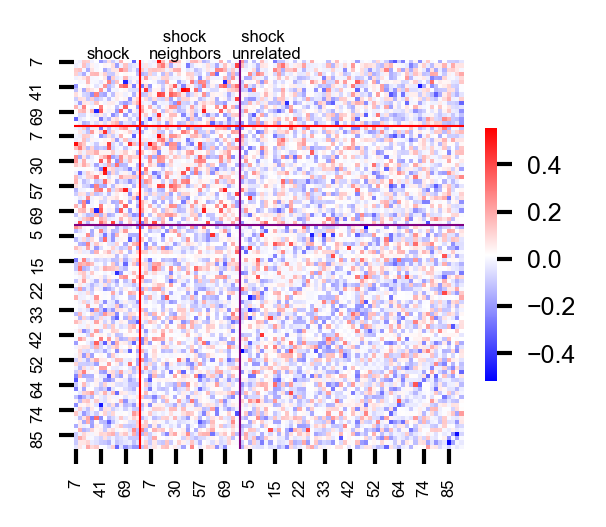

In [783]:
diff_dict={}
for m in fear_ctx_mice_ids:
    name = 'mouse_'+m
    shock_cells, shock_neighbors,ns_cells = get_celltypes(corr_df[name]['D1'].columns, ctx_shock_cells, ctx_shock_neighbors, name)
    diff_dict[name] = get_diffs(corr_df[name], name, shock_cells, shock_neighbors, ns_cells)

m = 'mouse_16'   
df3 = diff_dict[m]
shock_cells, shock_neighbors,ns_cells = get_celltypes(corr_df[name]['D1'].columns, ctx_shock_cells, ctx_shock_neighbors, m)

print('shock_diff: ', df3[shock_cells].mean().mean())
print('shock_neighbor_diff: ', df3[shock_neighbors].mean().mean())

print('nonshock_diff: ', df3[ns_cells].mean().mean())

from matplotlib.colors import LinearSegmentedColormap
mycmap = LinearSegmentedColormap.from_list('mycmap', [(0, 'b'),(0.5,'w'),(1,'r')])

ax = sns.heatmap(df3, cmap = mycmap,cbar_kws={'fraction':.03})
ax.axhline(y=len(shock_cells),linewidth=.5,color='r')
ax.axvline(x=len(shock_cells),linewidth=.5, color = 'r')
ax.axhline(y=len(shock_cells+shock_neighbors),linewidth=.5,color='purple')
ax.axvline(x=len(shock_cells+shock_neighbors),linewidth=.5, color = 'purple')

fontsize=4
ax.text(len(shock_cells)/2-5,-.2,'shock',fontsize=fontsize)
ax.text(len(shock_cells) + len(shock_neighbors)/2-10,-.2,'   shock \nneighbors',fontsize=fontsize)
ax.text(len(shock_cells + shock_neighbors) + len(ns_cells)/2-10,-.2,'  shock \nunrelated',fontsize=fontsize)
plt.xticks(fontsize=fontsize)
plt.yticks(fontsize=fontsize)


ax.set_aspect('equal')

In [795]:
def get_connections(df, which_cells):
    df1 = df.loc[:,~df.columns.duplicated()]
    df1 = df1.loc[which_cells,which_cells].drop_duplicates()
    connections = {}
    for a,i in enumerate(df1.index):
        for b,j in enumerate(df1.columns):
            if a<b:
                connections[i,j] = df1.loc[i,j]
    return list(connections.values())

def get_diffs_long(df, name):
    shock_cells, shock_neighbors,ns_cells = get_celltypes(df.columns, ctx_shock_cells, ctx_shock_neighbors, name)

    shock_diffs = get_connections(df, shock_cells)
    ns_diffs = get_connections(df,ns_cells)
    sn_diffs = get_connections(df,shock_neighbors)
    df = pd.concat([pd.Series(shock_diffs,name='shock'),pd.Series(ns_diffs,name='ns'),
                    pd.Series(sn_diffs,name='sn')],axis=1).melt(var_name='type',value_name='diff')
    return df

In [51]:
#Make Graphs
neurons=dict()
graph = dict()

for m in mice_ids:
    mouse_name = 'mouse_' + m
    neurons[mouse_name] = list(corr_df[mouse_name]['D3_Ctx'].keys()) 
    
    graph[mouse_name] = dict()
    
    for k in corr_dict[mouse_name].keys():
        graph[mouse_name][k] = NeuronNetwork(neurons[mouse_name],corr_dict[mouse_name][k])

## Get Context Shock (D1) and Tone Shock (D2) cells

### Get Context Shock Cells

In [52]:
ctx_shock_cells = dict()
#fear_mice_df = mouse_ids.loc[mouse_ids['Group'] == 'Fear']
#fear_mice_ids = list(fear_mice_df.Mouse)

for m in fear_ctx_mice_ids:
    mouse_name = 'mouse_' + m
    this_mouse_ctx_shock = pd.read_csv(find_file("Hen_Lab/Jess_CFC_all/Mice", mouse_name + "_shockcells.csv"), header=None)
    ctx_shock_cells[mouse_name] = this_mouse_ctx_shock.iloc[:,0].tolist()

### Get Tone Shock Cells

In [53]:
# Get footshock cells from fear mice only and store in a dict of lists

tone_shock_cells = dict()
#fear_mice_df = mouse_ids.loc[mouse_ids['Group'] == 'Fear']
#fear_mice_ids = list(fear_mice_df.Mouse)

for m in fear_tone_mice_ids:
    mouse_name = 'mouse_' + m
    this_mouse_shock = pd.read_csv(find_file("Hen_Lab/Jess_CFC_all/Mice_Tones", mouse_name + "_tone_shockcells.csv"), header=None)
    tone_shock_cells[mouse_name] = this_mouse_shock.iloc[:,0].tolist()

### Get Context Only, Tone Only, and Contex AND Tone Shock Cells

In [54]:
ctx_only_shock_cells = dict()
tone_only_shock_cells = dict()
ctx_tone_shock_cells = dict()

for k,v in ctx_shock_cells.items():
    tone_cells = tone_shock_cells[k]
    ctx_cells = ctx_shock_cells[k]
    
    ctx_only_shock_cells[k] = list(set(ctx_cells) - set(tone_cells))
    tone_only_shock_cells[k] = list(set(tone_cells) - set(ctx_cells))
    ctx_tone_shock_cells[k] = list(set(tone_cells) & set(ctx_cells))

In [55]:
#Confirm set operations worked as anticipated
#ctx_shock_cells['mouse_16']
#tone_shock_cells['mouse_16']
#ctx_only_shock_cells['mouse_16']
#tone_only_shock_cells['mouse_16']
#ctx_tone_shock_cells['mouse_16']

In [56]:
def get_neighbors(g=None,neurons=None):
    """
    Returns a list of neighbors of a list of nodes
    
    inputs:
    g: graph with which to search for neighbors
    neurons: list of nodes to find neighbors of
    
    outputs:
    neighbors: list of neighbors
    
    """
    
    neighbors = []
    for n in g.neurons:
        if n in neurons:

            try:
                neighbors.extend(list(g.network.neighbors(n)))
            except KeyError:
                neighbors = list(g.network.neighbors(n))
    neighbors = set(neighbors)
    return neighbors

### Get Context Shock Neighbors (Day 2)

In [57]:
ctx_shock_neighbors = dict()

for m in fear_ctx_mice_ids:
    mouse_name = 'mouse_' + m
    g = graph[mouse_name]['D2']
    this_ctx_shock_cells = ctx_shock_cells[mouse_name]
    ctx_shock_neighbors[mouse_name] = get_neighbors(g,this_ctx_shock_cells)

### Get Tone-Shock Neighbors (Day 3 Tone)

In [58]:
tone_shock_neighbors = dict()

for m in fear_tone_mice_ids:
    mouse_name = 'mouse_' + m
    g = graph[mouse_name]['D3_Tone']
    this_tone_shock_cells = tone_shock_cells[mouse_name]
    tone_shock_neighbors[mouse_name] = get_neighbors(g,this_tone_shock_cells)

### Get Ctx-Only Shock Neighbors (Day 2)

In [59]:
ctx_only_shock_neighbors = dict()

for m in fear_ctx_mice_ids:
    mouse_name = 'mouse_' + m
    g = graph[mouse_name]['D2']
    this_ctx_only_shock_cells = ctx_only_shock_cells[mouse_name]
    ctx_only_shock_neighbors[mouse_name] = get_neighbors(g,this_ctx_only_shock_cells)

### Get Tone-Only Shock Neighbors (Day 3 Tone)

In [60]:
tone_only_shock_neighbors = dict()

for m in fear_ctx_mice_ids:
    mouse_name = 'mouse_' + m
    g = graph[mouse_name]['D3_Tone']
    this_tone_only_shock_cells = tone_only_shock_cells[mouse_name]
    tone_only_shock_neighbors[mouse_name] = get_neighbors(g,this_tone_only_shock_cells)

### Get Ctx_Tone (Shock Shock, SS) Neighbors

In [61]:

ctx_tone_shock_neighbors = dict()

for m in fear_ctx_mice_ids:
    mouse_name = 'mouse_' + m
    g = graph[mouse_name]['D3_Tone']
    this_ctx_tone_shock_cells = ctx_tone_shock_cells[mouse_name]
    ctx_tone_shock_neighbors[mouse_name] = get_neighbors(g,this_ctx_tone_shock_cells)

In [62]:
#tone_shock_neighbors
#ctx_shock_neighbors
#ctx_tone_shock_neighbors

In [63]:
"""
def color_list(neuronlist, sublist1, color1,color2):
    
    returns a list of colors for plotting graphs
    
    inputs: 
        -a list of all the neurons, and a subset to be colored 
        -2 colors
    
   
    
    c_list = []
    for n in range(0,len(neuronlist)):
        if neuronlist[n] in sublist1:
            c_list.append(color1)
        else:
            c_list.append(color2) 
    return c_list   
"""

'\ndef color_list(neuronlist, sublist1, color1,color2):\n    \n    returns a list of colors for plotting graphs\n    \n    inputs: \n        -a list of all the neurons, and a subset to be colored \n        -2 colors\n    \n   \n    \n    c_list = []\n    for n in range(0,len(neuronlist)):\n        if neuronlist[n] in sublist1:\n            c_list.append(color1)\n        else:\n            c_list.append(color2) \n    return c_list   \n'

In [64]:
def label_list(neuronlist, *sublists, labels=['red','blue'],both="purple"):
    """
    returns a list of labels for plotting graphs
    Does NOT Currently handle cases where a neuron is in both sublists (eg. tone-shock and context-shock)
    
    inputs: 
        neuronlist: a list of all the neurons
        sublists: 1 or 2 lists of neurons to be labeled 
        labels: 2 or 3 labels to apply to the lists, and neurons not in either list (there must be 1 more label then there are lists)
    outputs:
        list of labels corresponding to the neurons in neuronlist    
    """
    
    if (len(labels) -1 != len(sublists)):
        raise ValueError('Please enter 1 more color than sublists')
   
    c_list = []

    if len(sublists)==1:
        
        c1 = labels[0]
        c2 = labels[1]
        s1 = sublists[0]
        
        for i,n in enumerate(neuronlist):
            if n in s1:
                c_list.append(c1)
            else:
                c_list.append(c2) 
        #return c_list 
    
    elif len(sublists)==2:
    
        c1=labels[0]
        c2=labels[1]
        c3=labels[2]
        
        s1 = sublists[0]
        s2 = sublists[1]
        
        for i,n in enumerate(neuronlist):
            if n in s1:
                if n in s2:
                    c_list.append(both)
                else:
                    c_list.append(c1)
            elif n in s2:
                c_list.append(c2) 
            else:
                c_list.append(c3)
            
    return c_list   

# Plot Graphs

### Chrimson Mice

mouse_7
D1


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network
C:\Users\berryja\AppData\Local\Continuum\anaconda2\envs\henlabenv\lib\site-packages\networkx\drawing\nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):
C:\Users\berryja\AppData\Local\Continuum\anaconda2\envs\henlabenv\lib\site-packages\matplotlib\figure.py:2359: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "


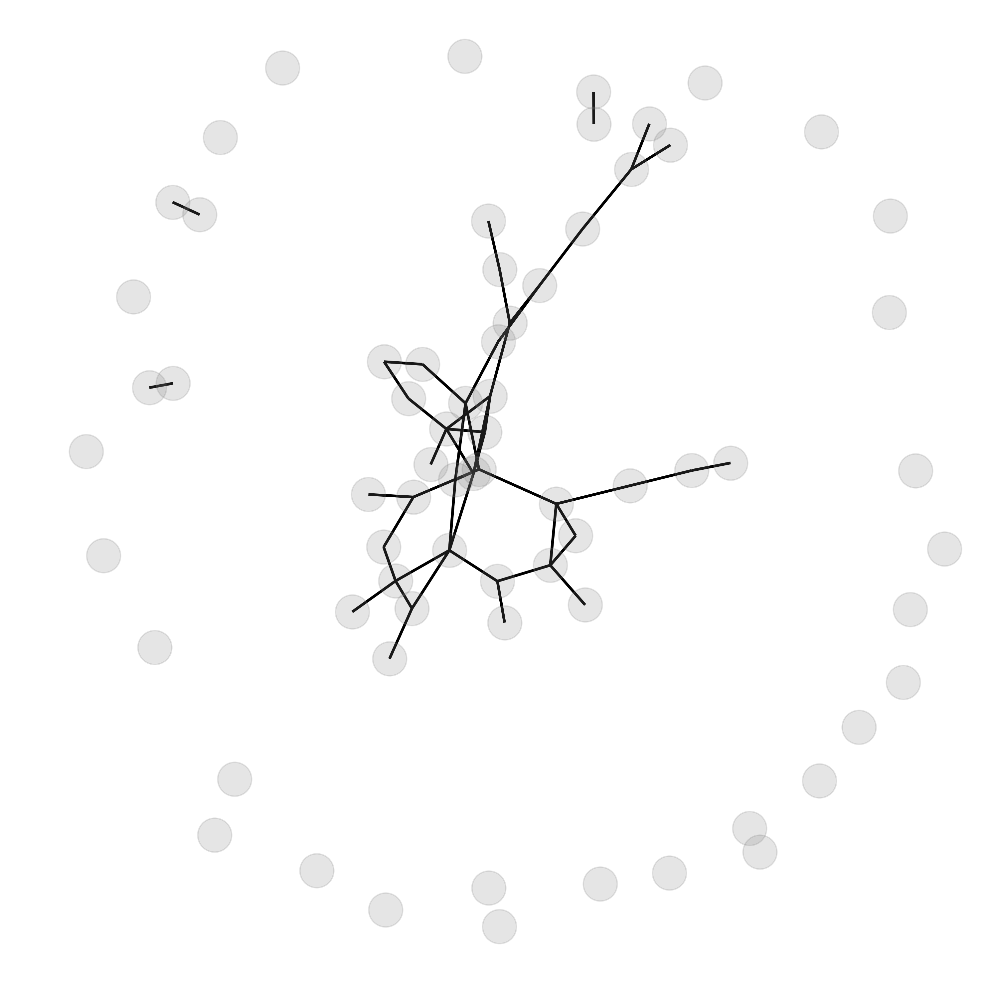

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D2


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


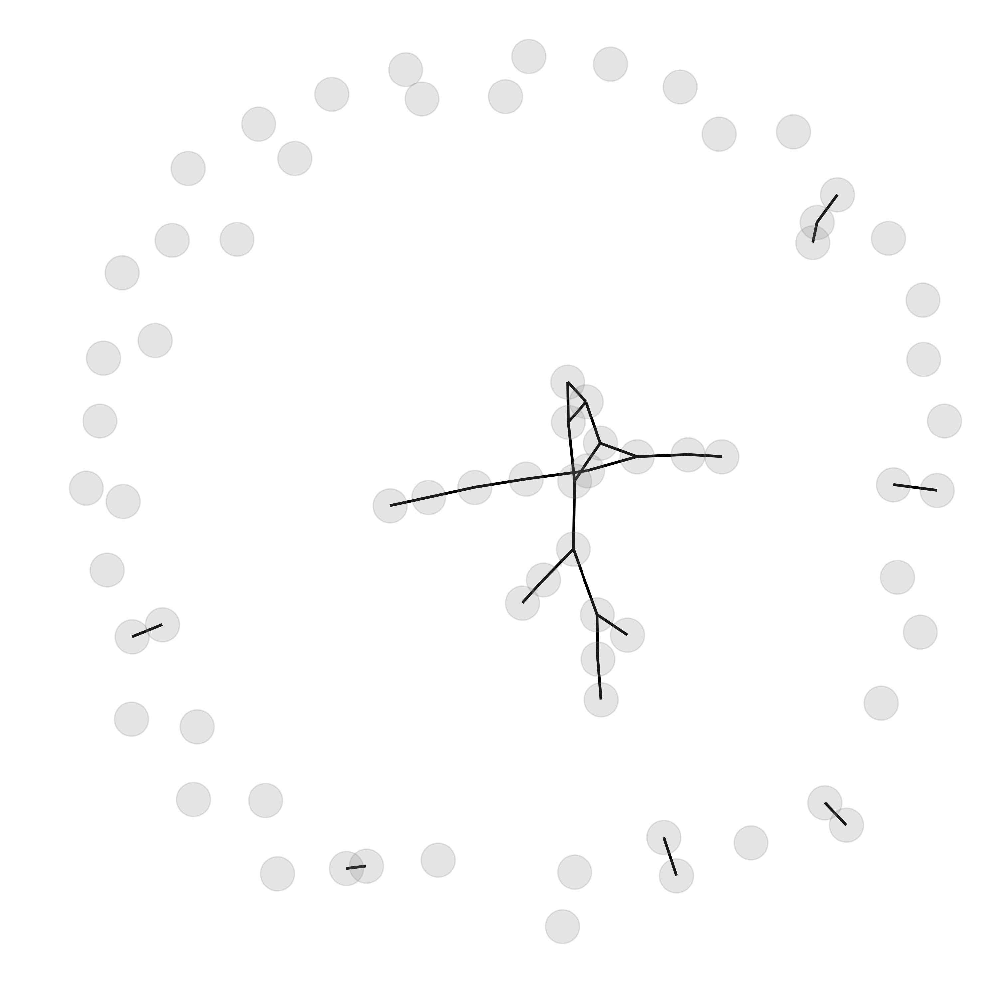

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Ctx


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


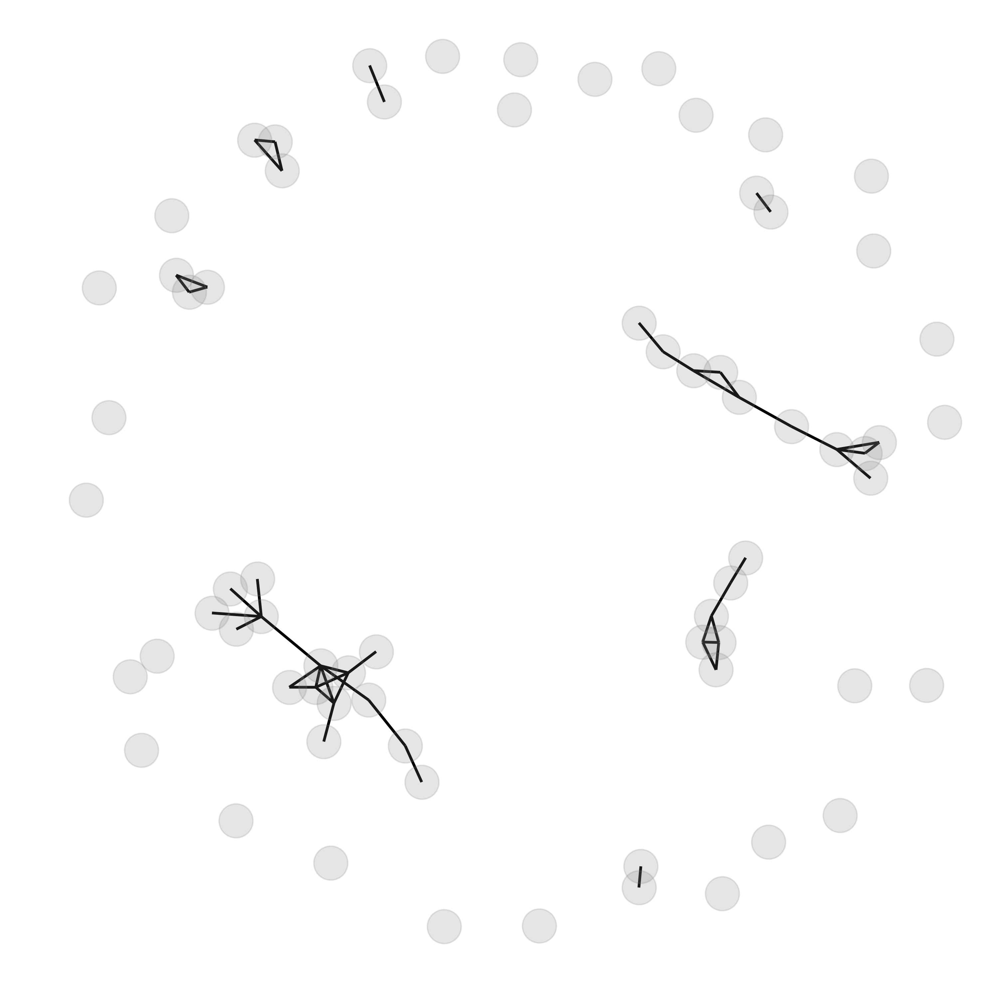

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Tone


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


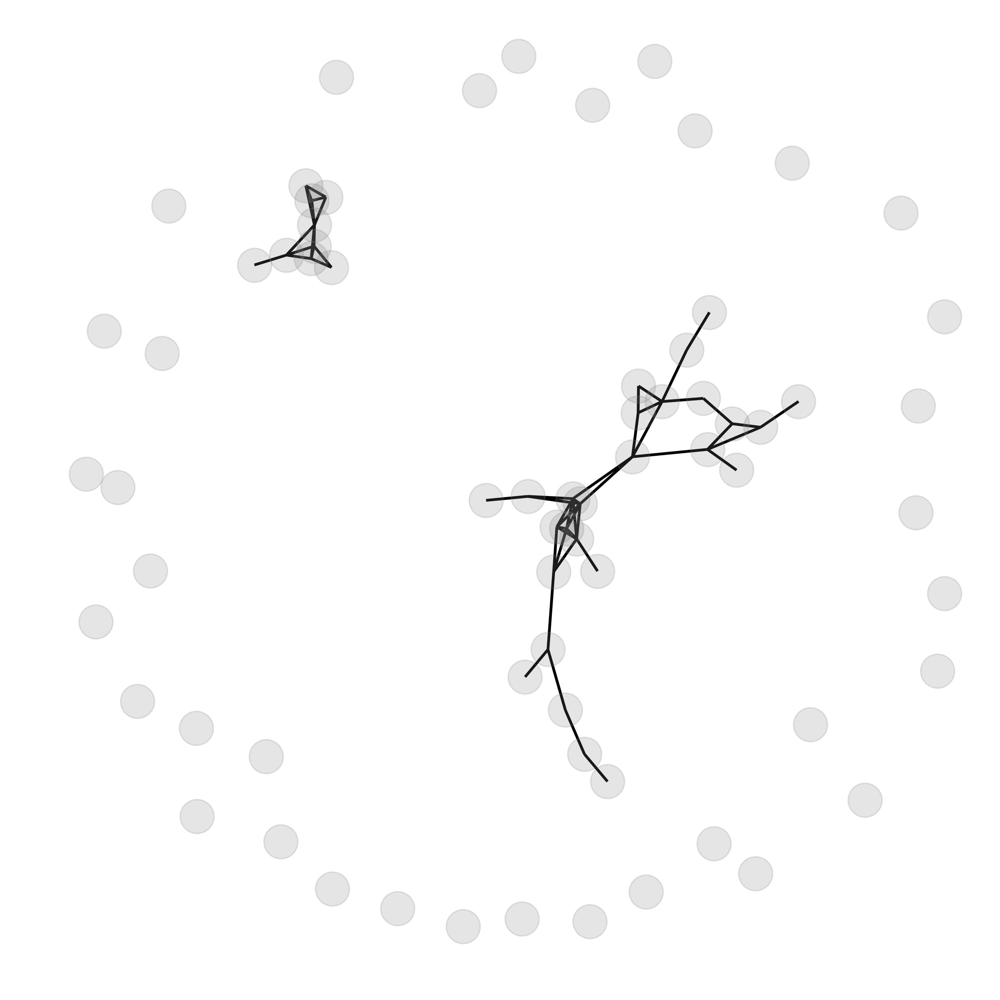

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

mouse_211
D1


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


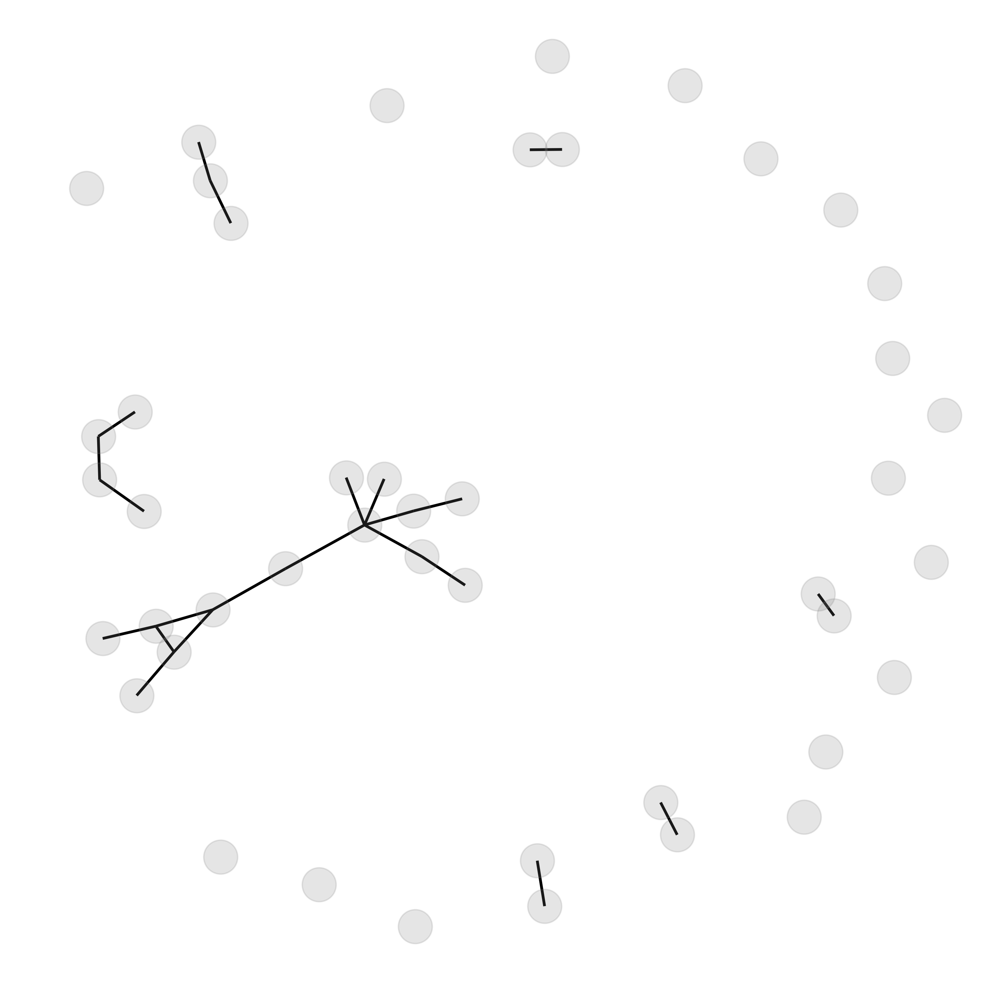

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D2


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


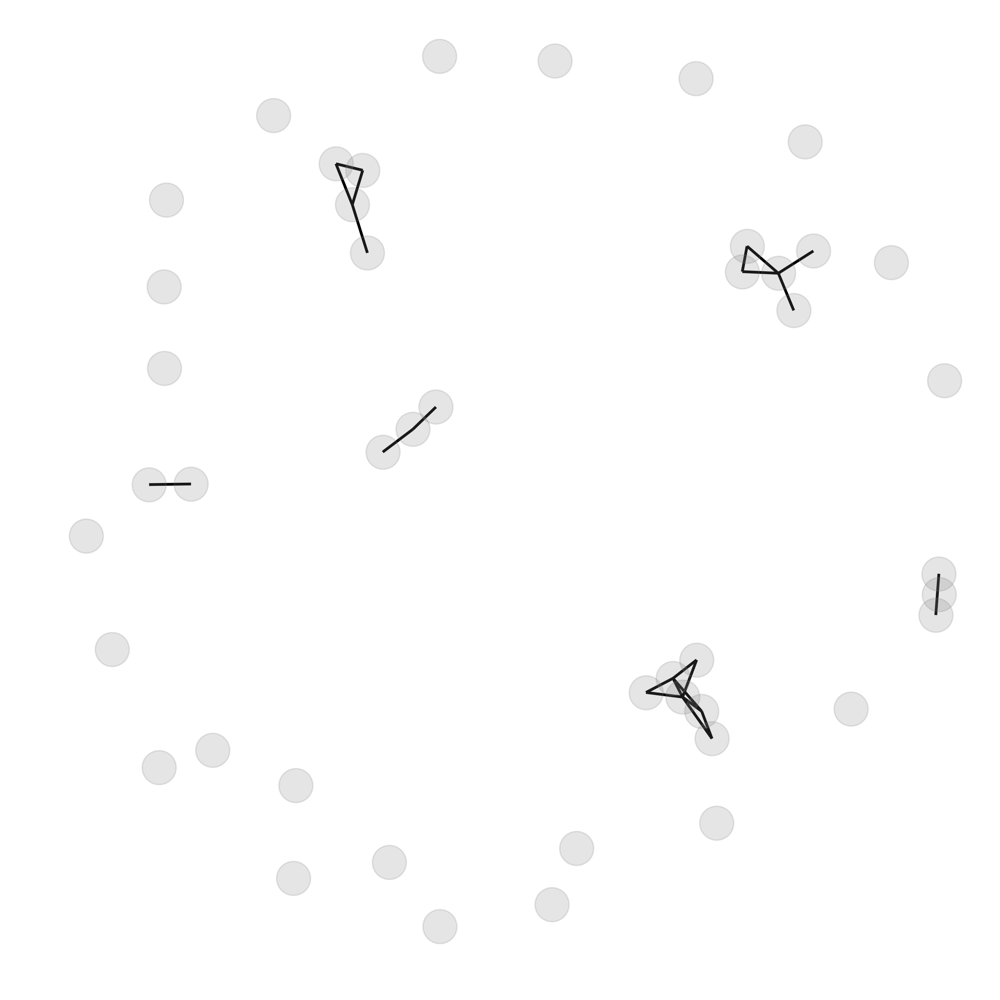

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Ctx


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


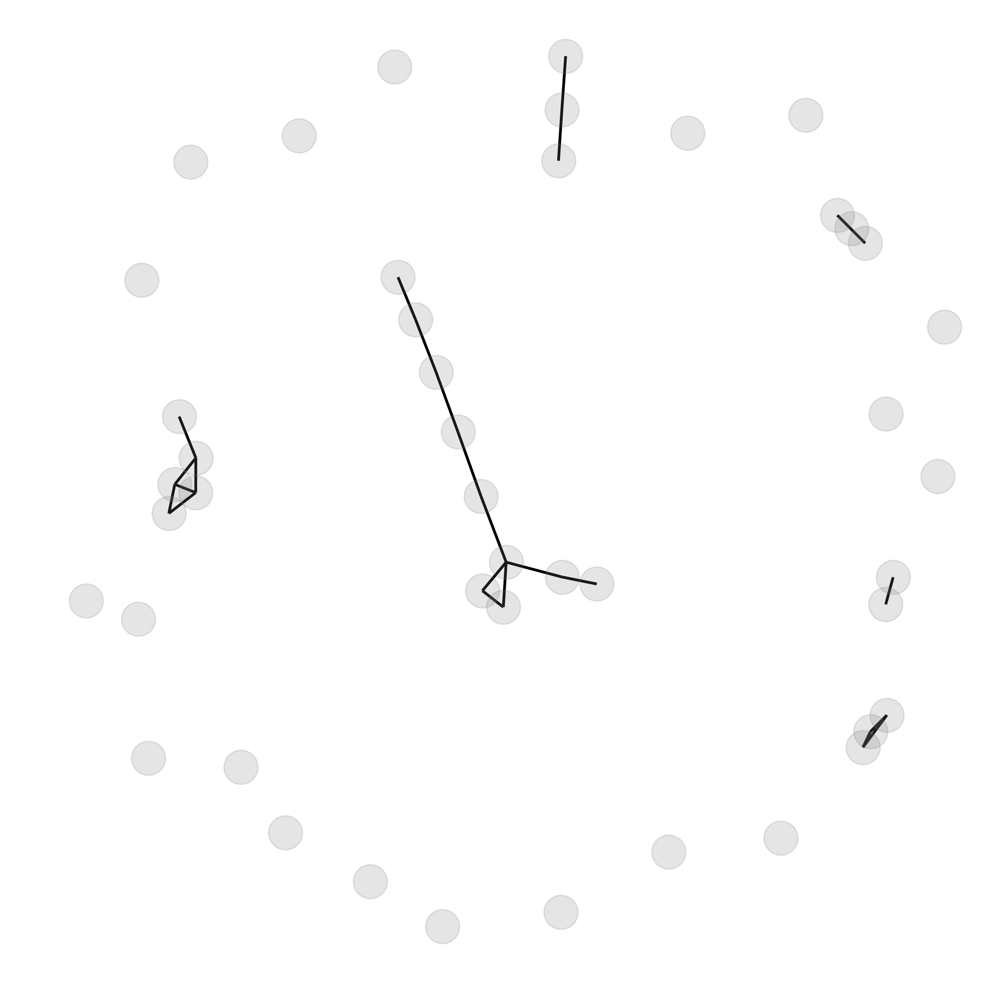

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Tone


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


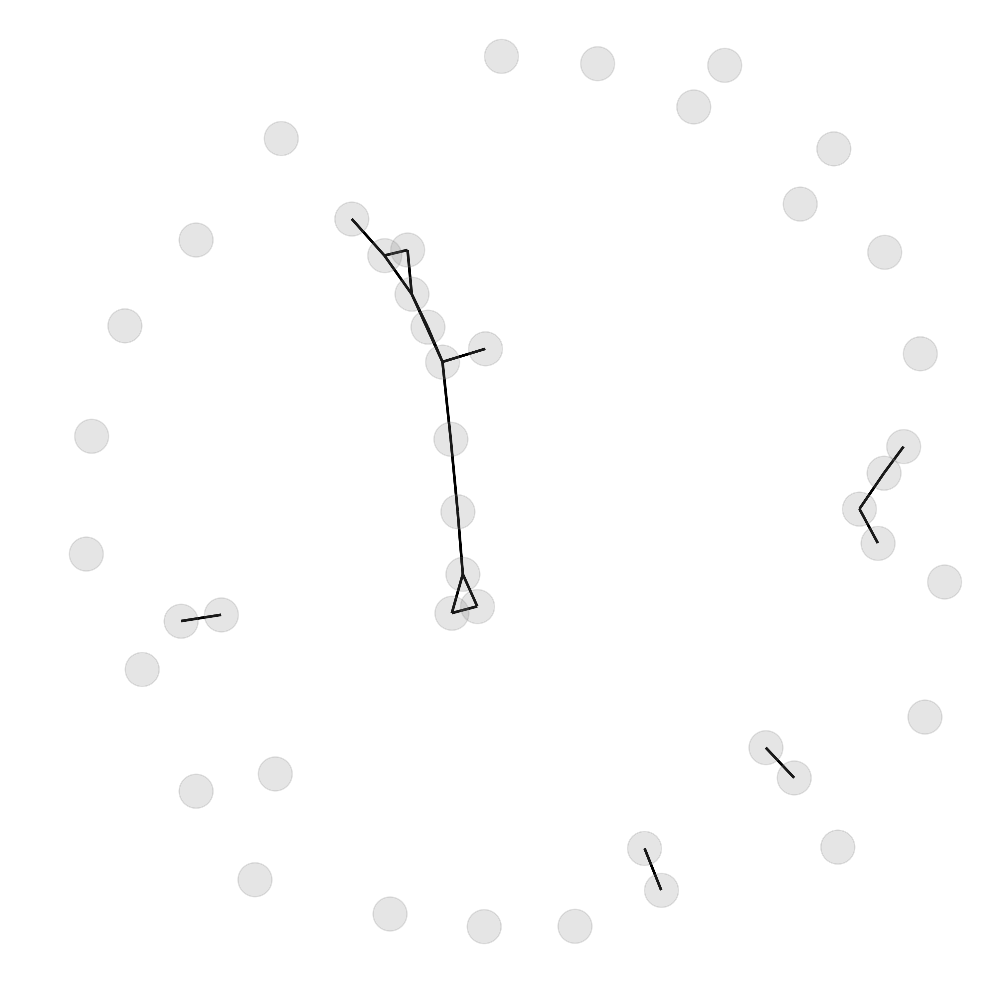

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

mouse_35
D1


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


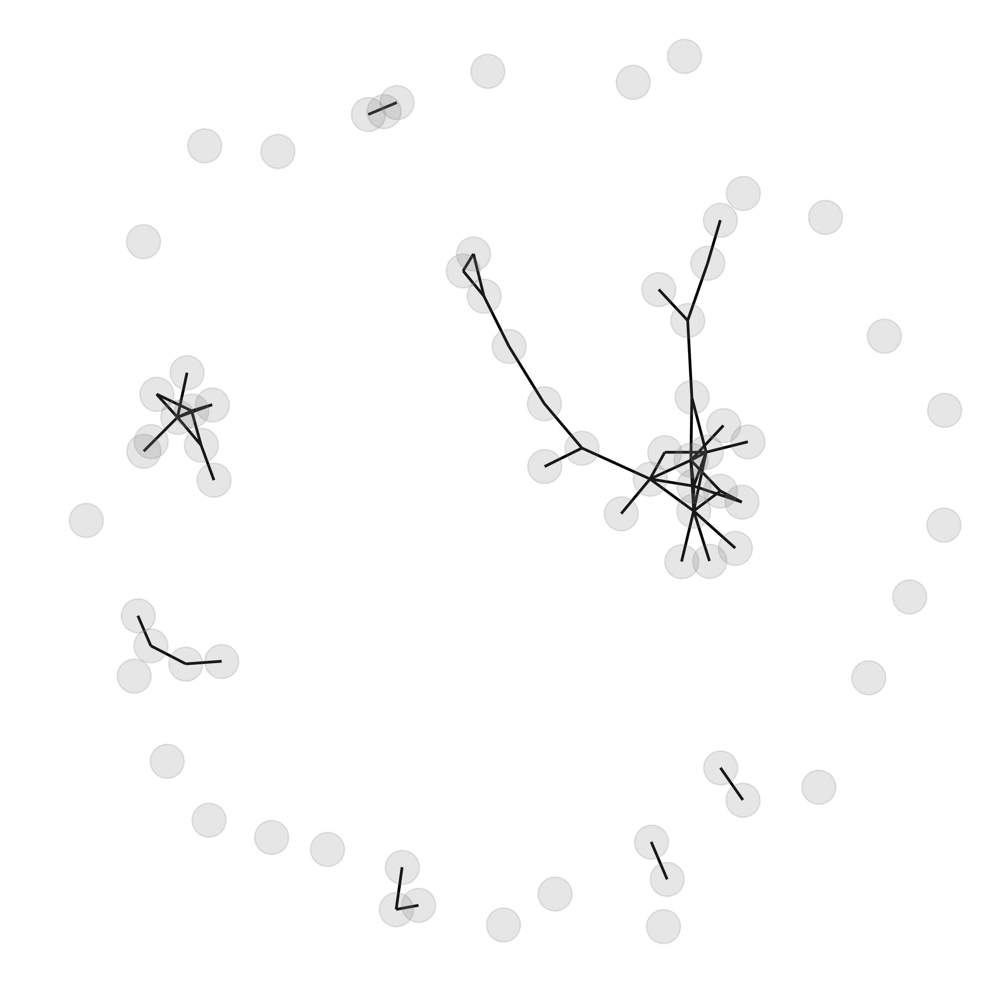

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D2


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


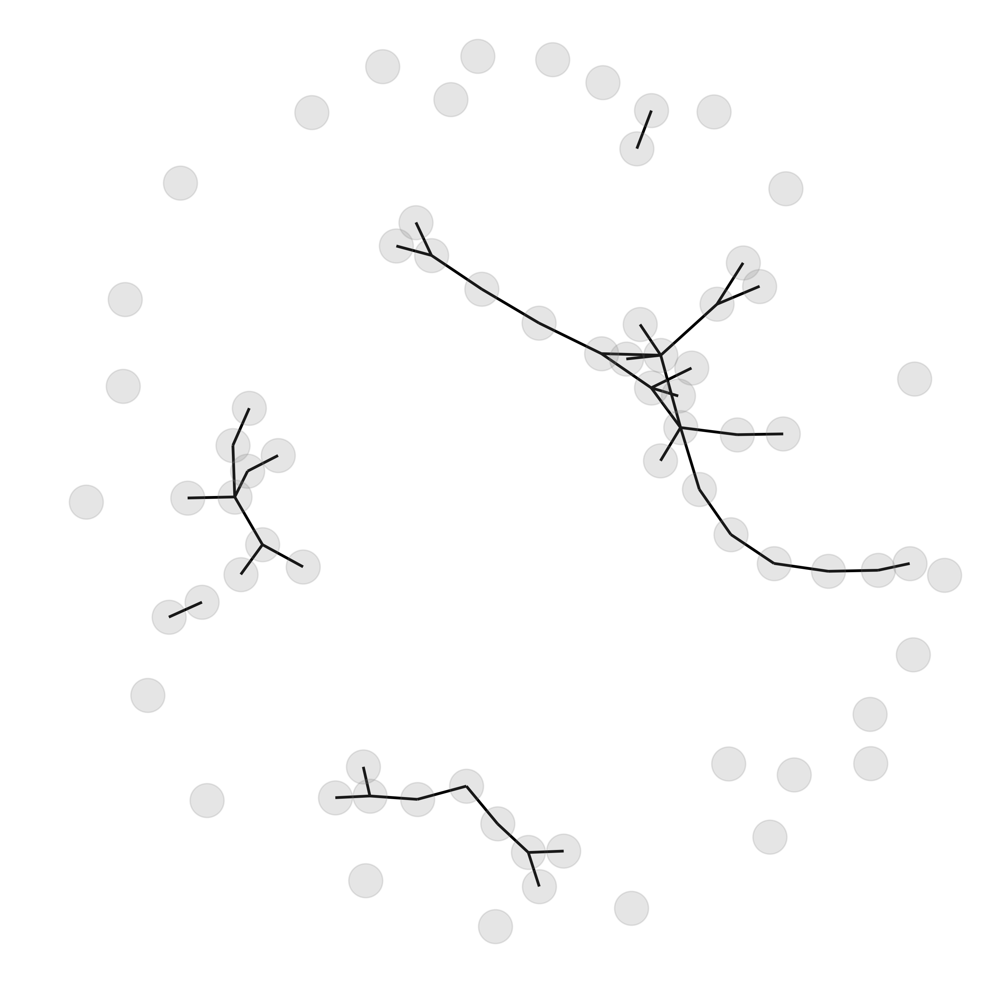

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Ctx


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


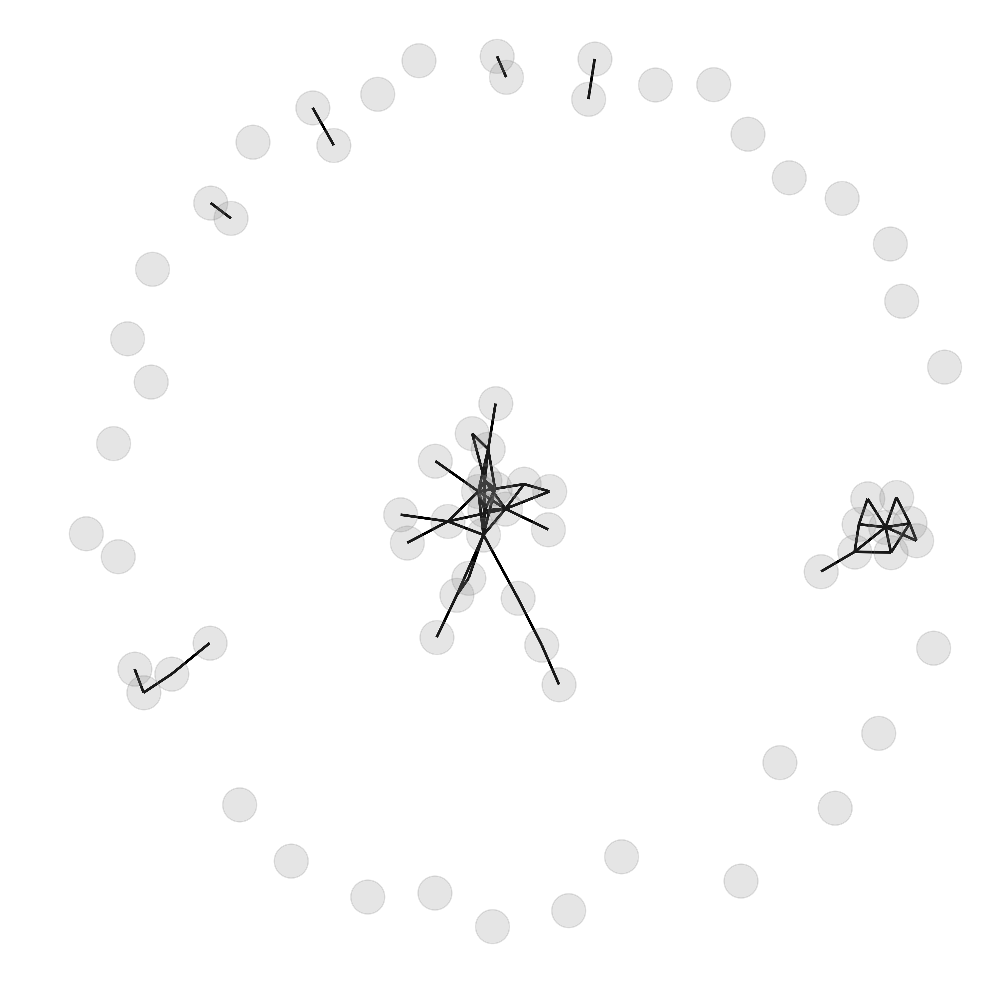

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Tone


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


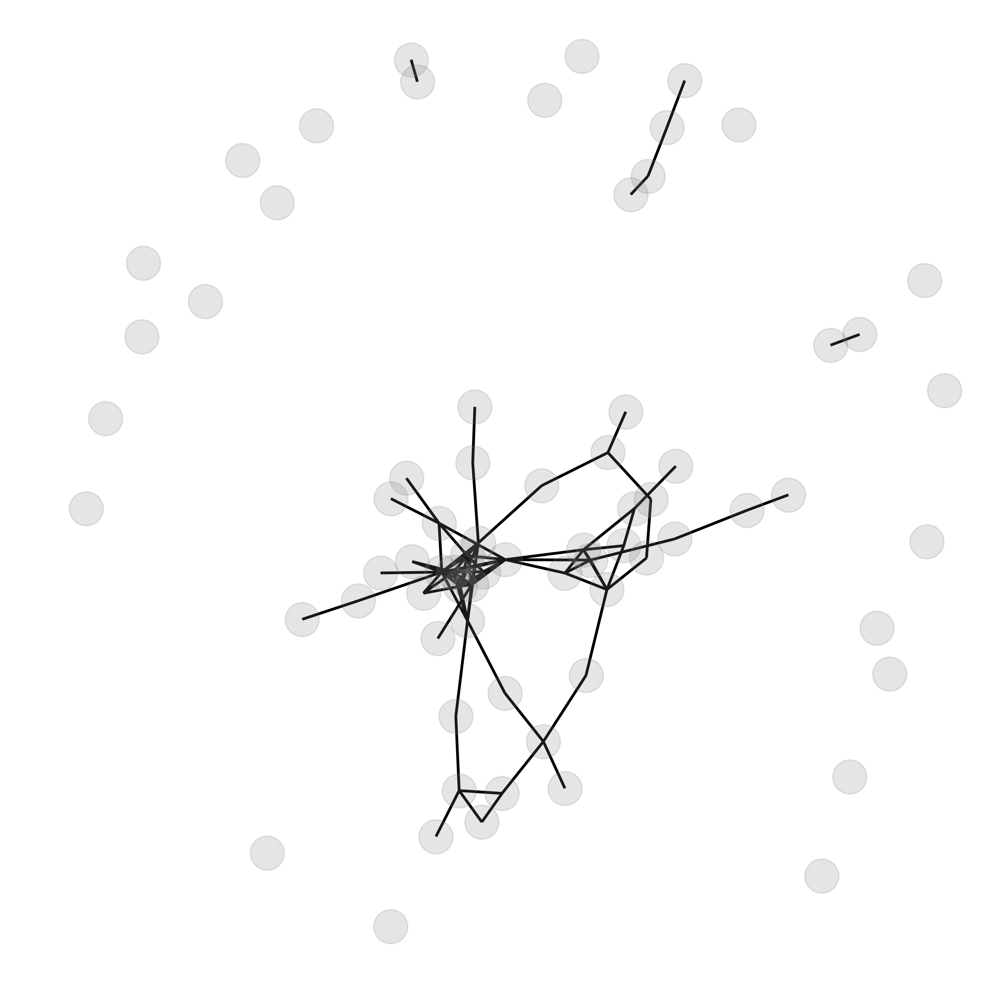

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

mouse_16
D1


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


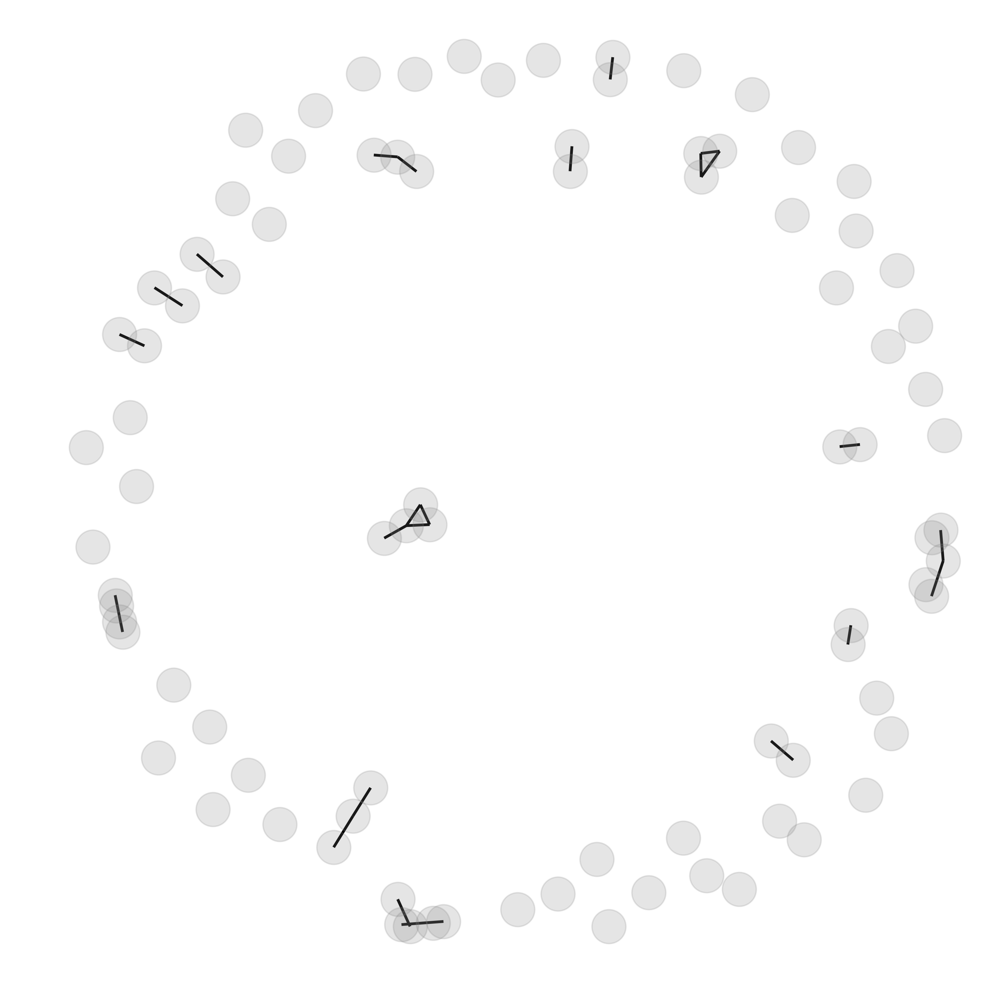

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D2


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


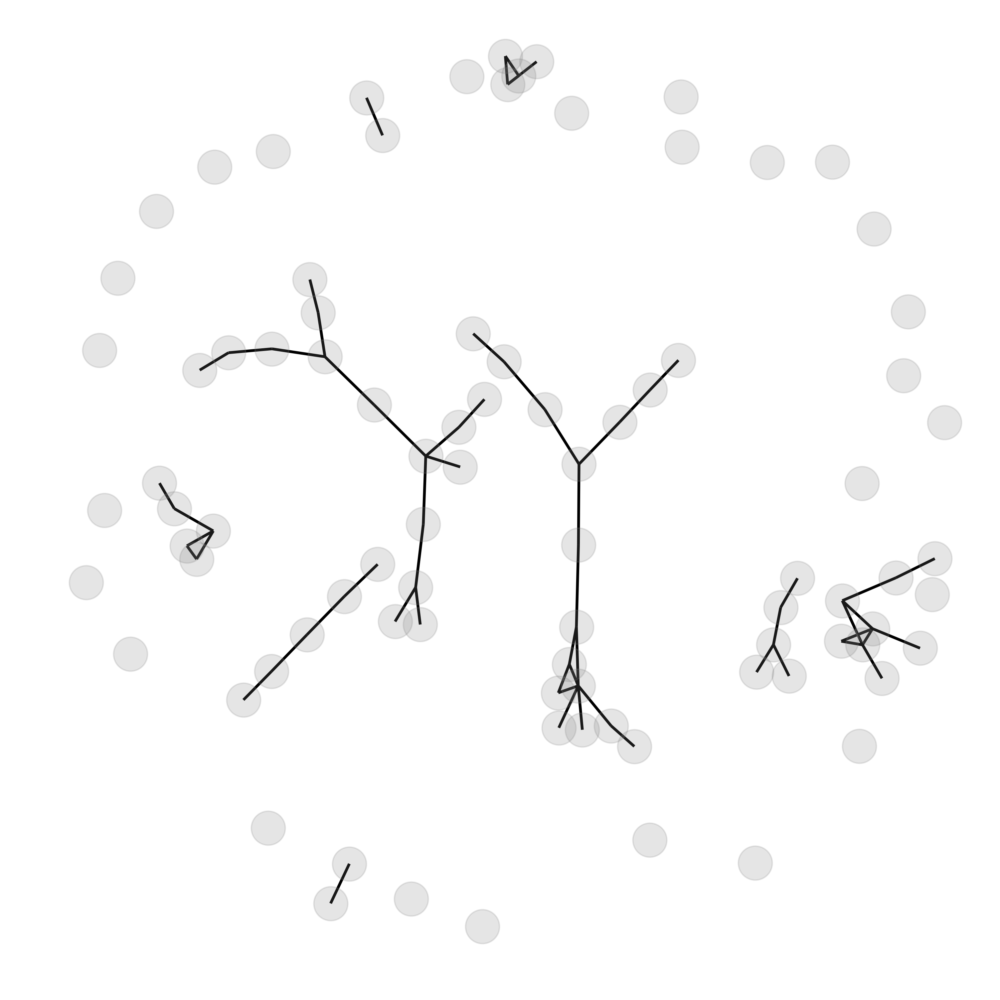

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Ctx


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


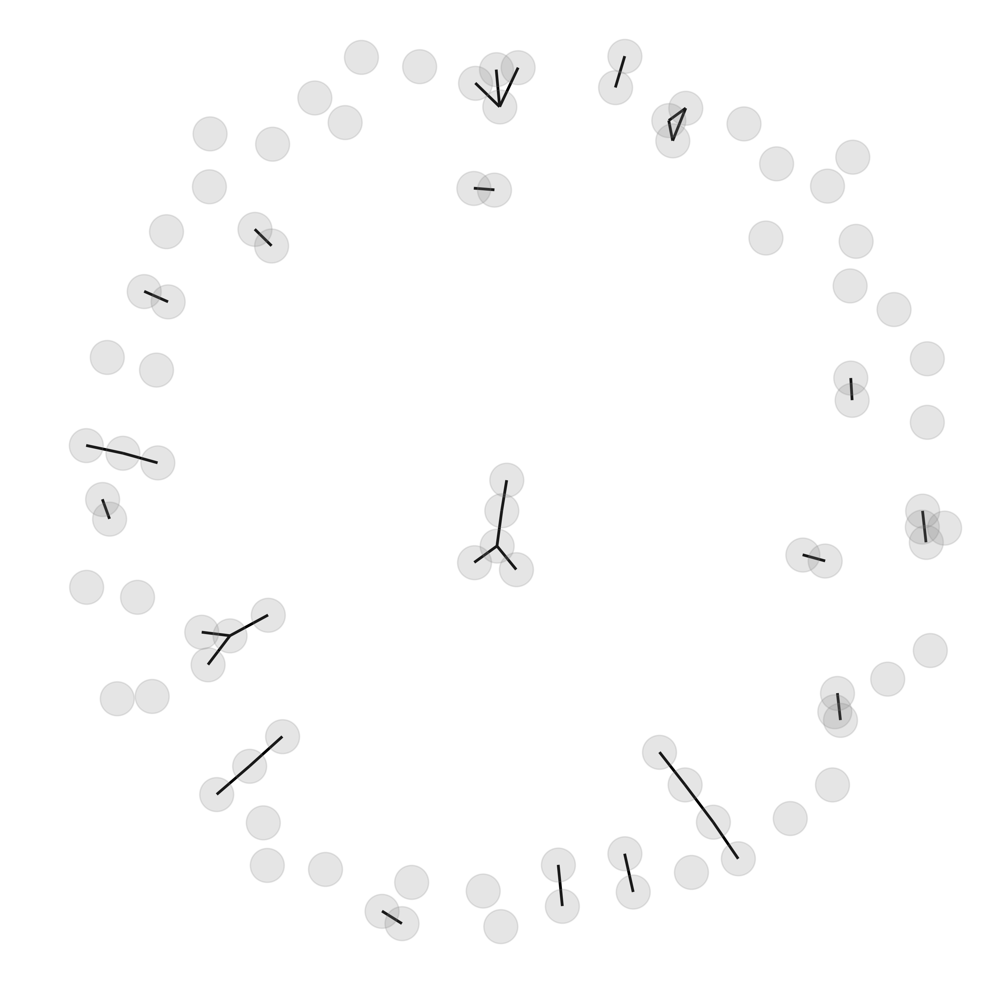

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Tone


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


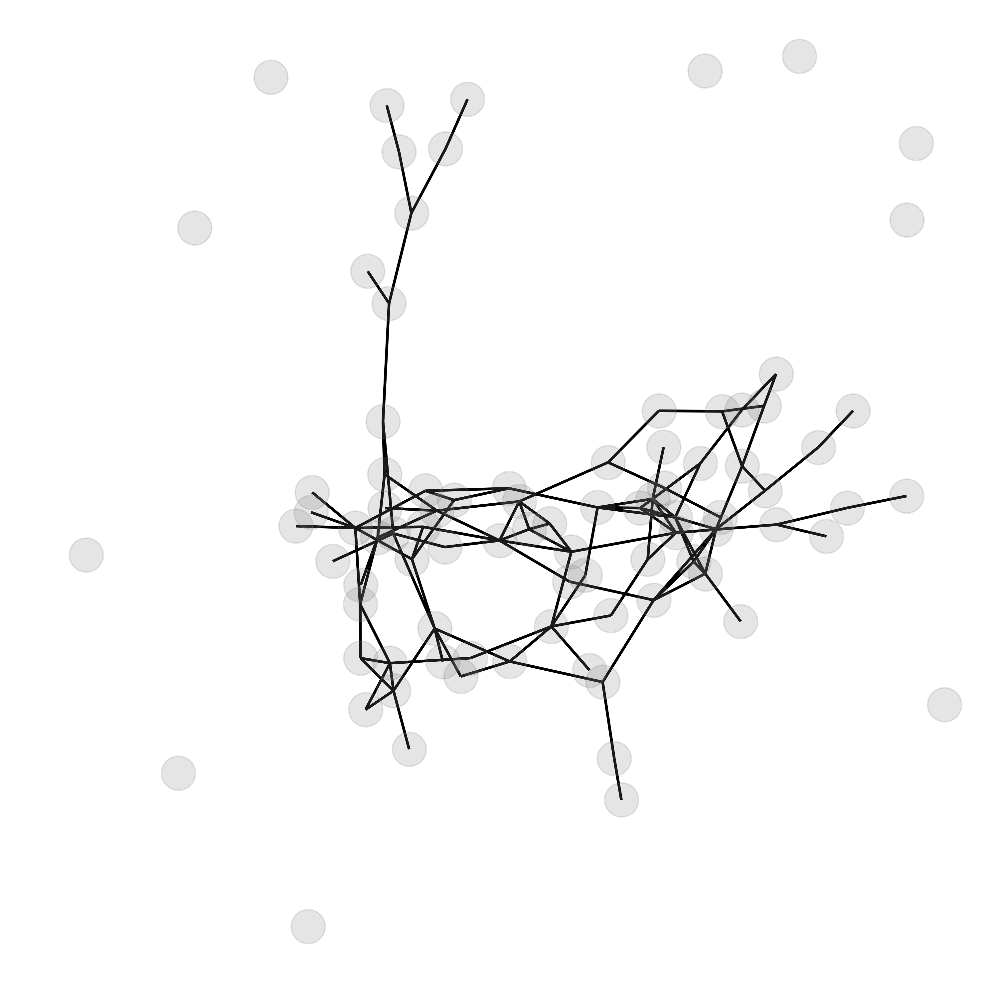

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

mouse_212
D1


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


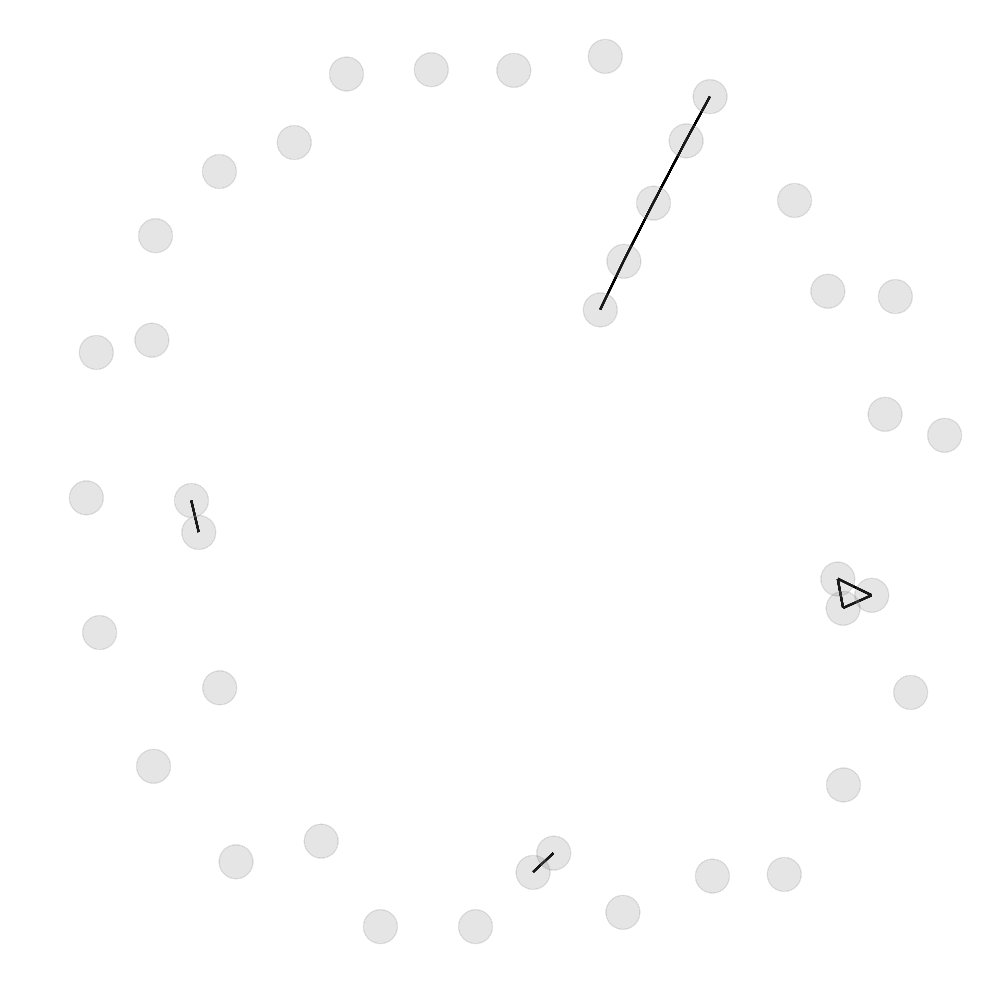

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D2


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


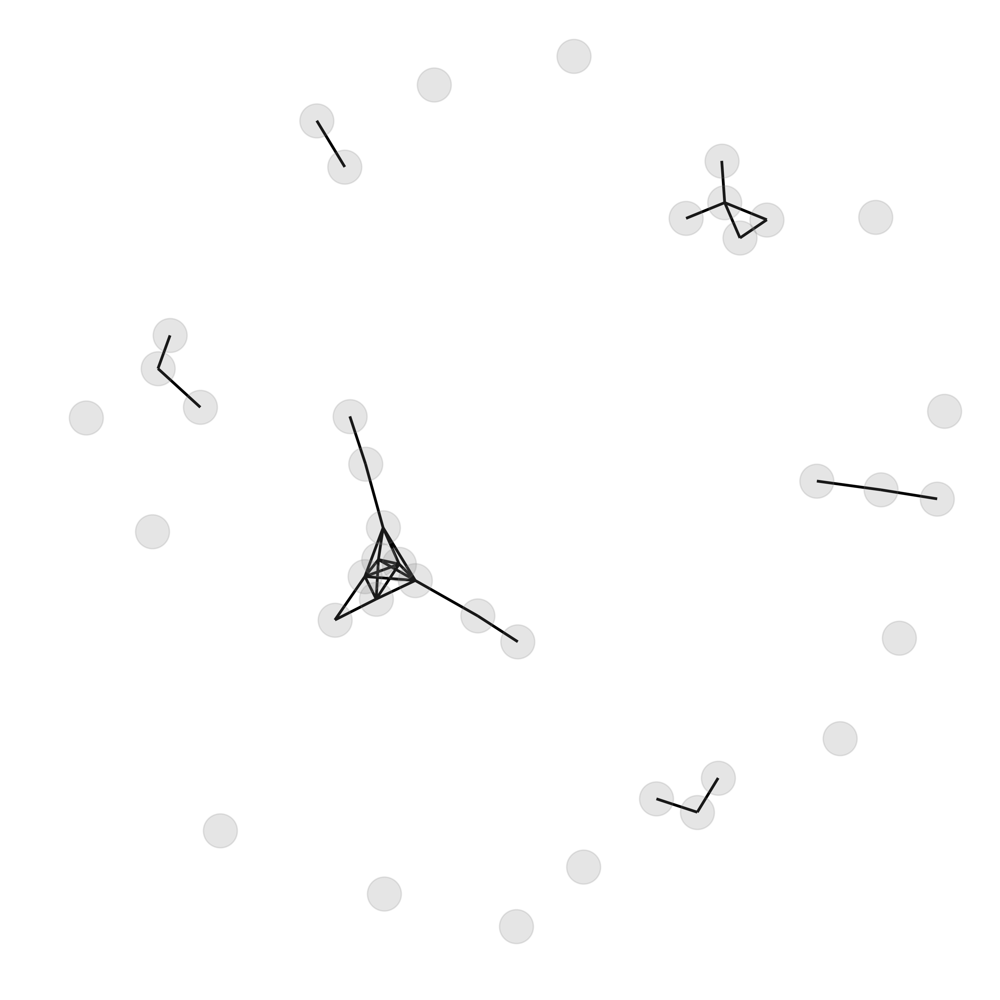

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Ctx


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


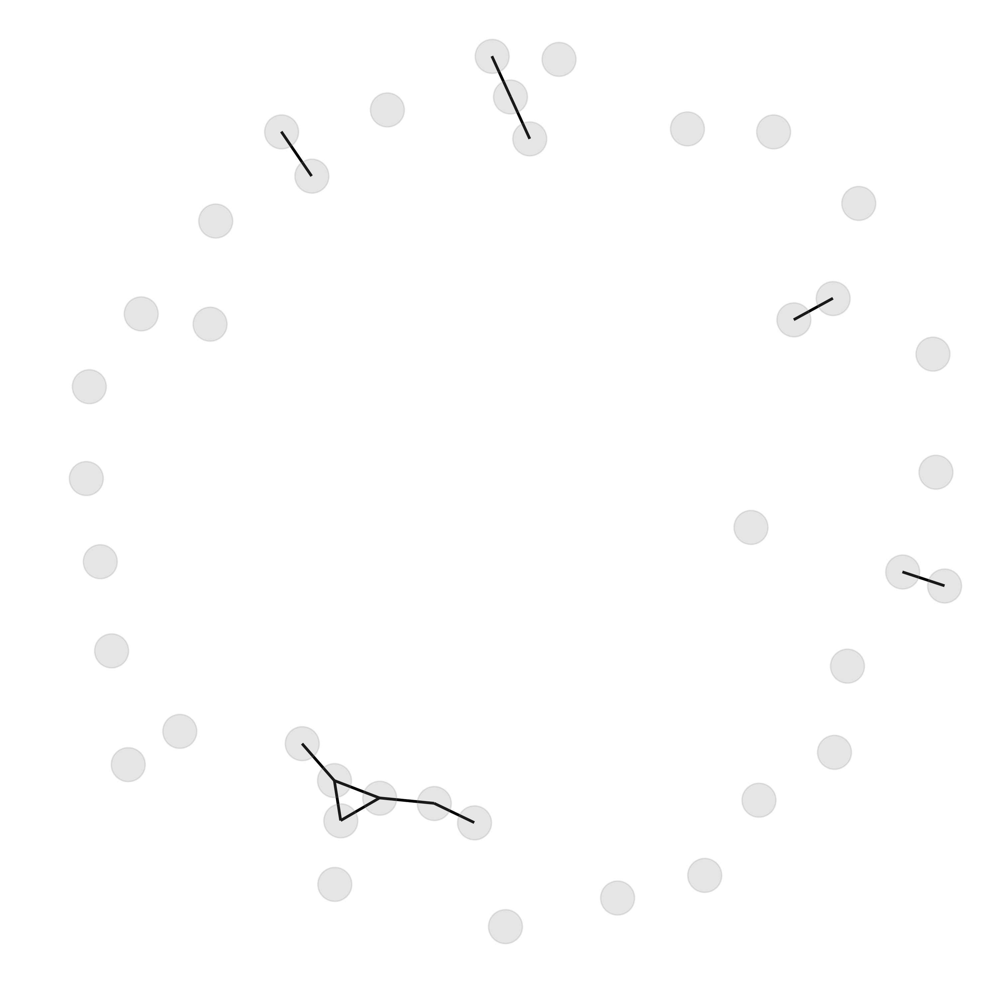

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Tone


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


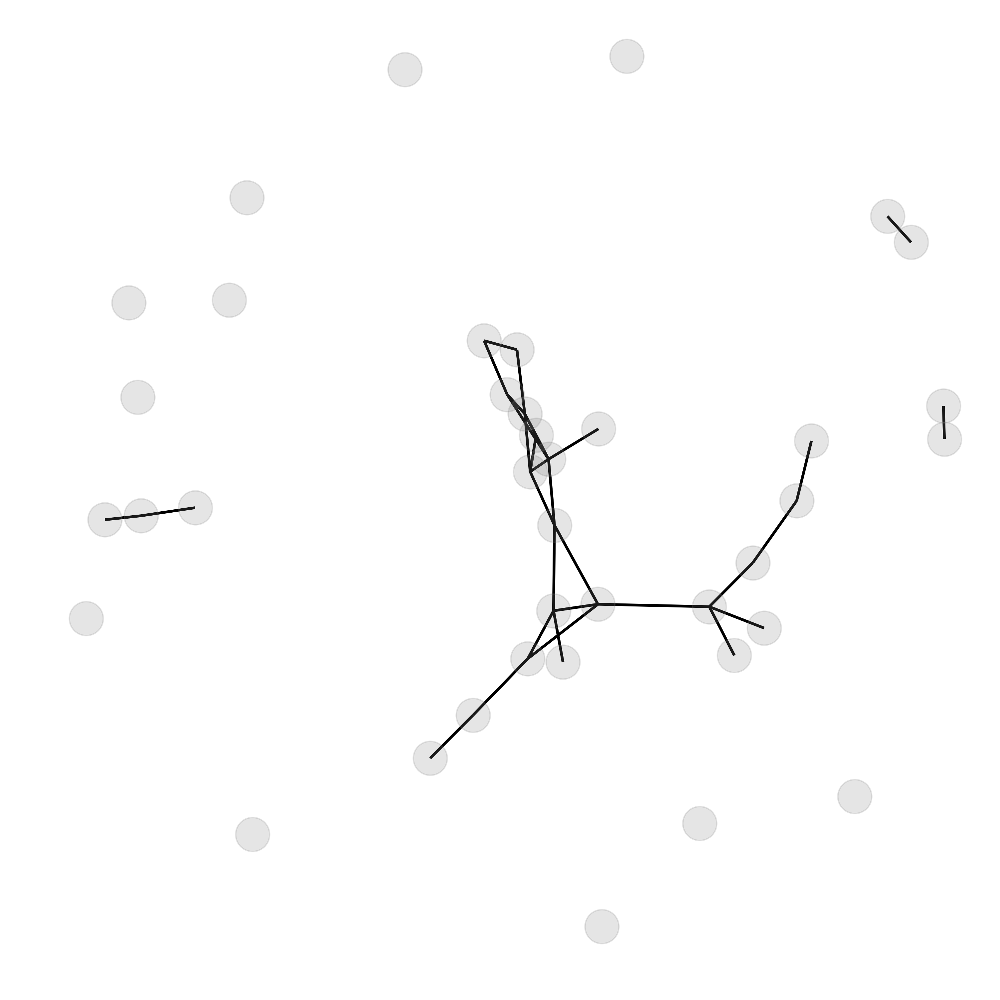

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

mouse_22
D1


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


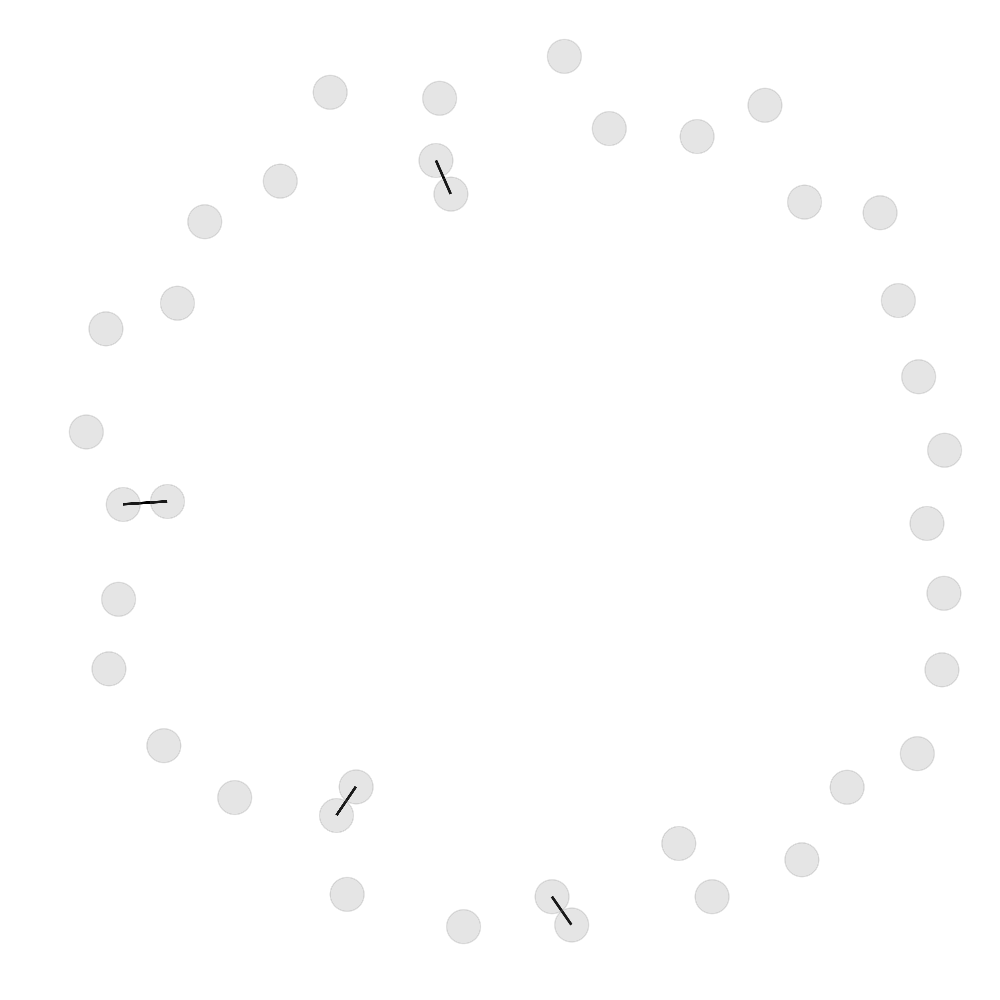

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D2


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


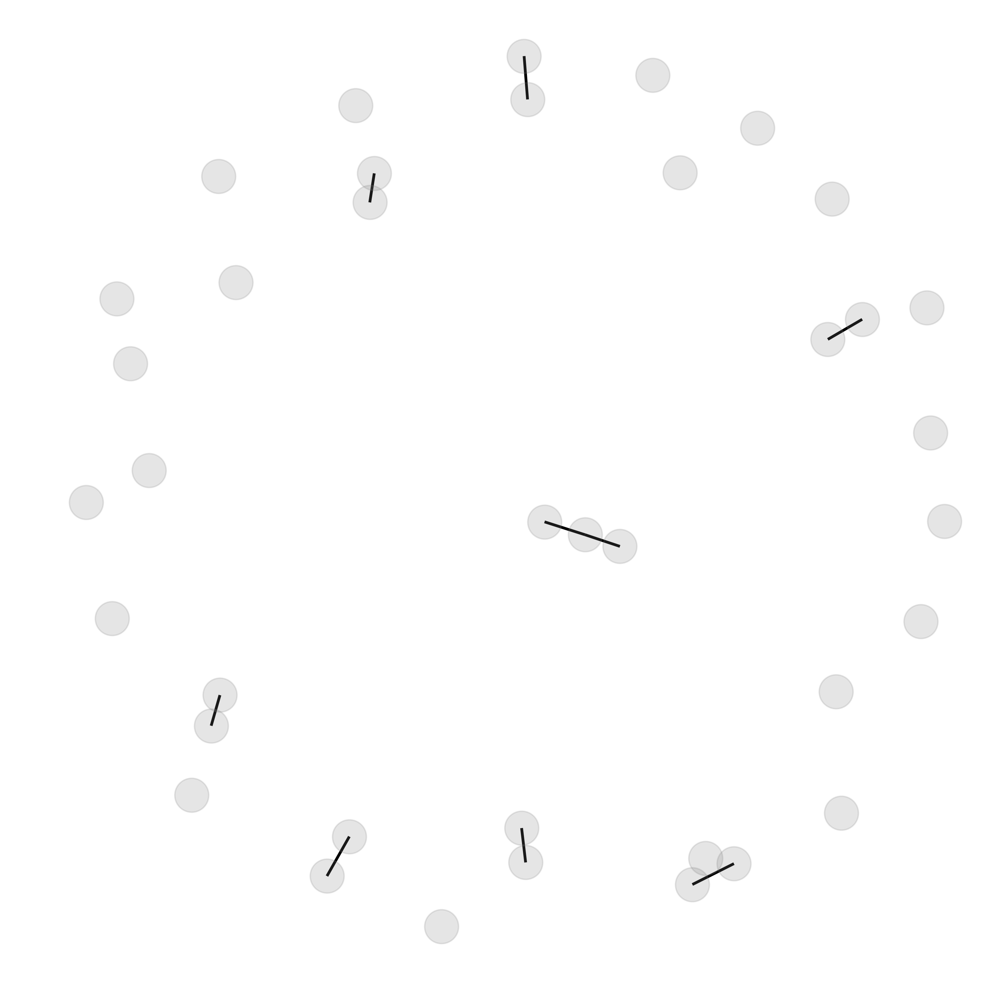

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Ctx


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


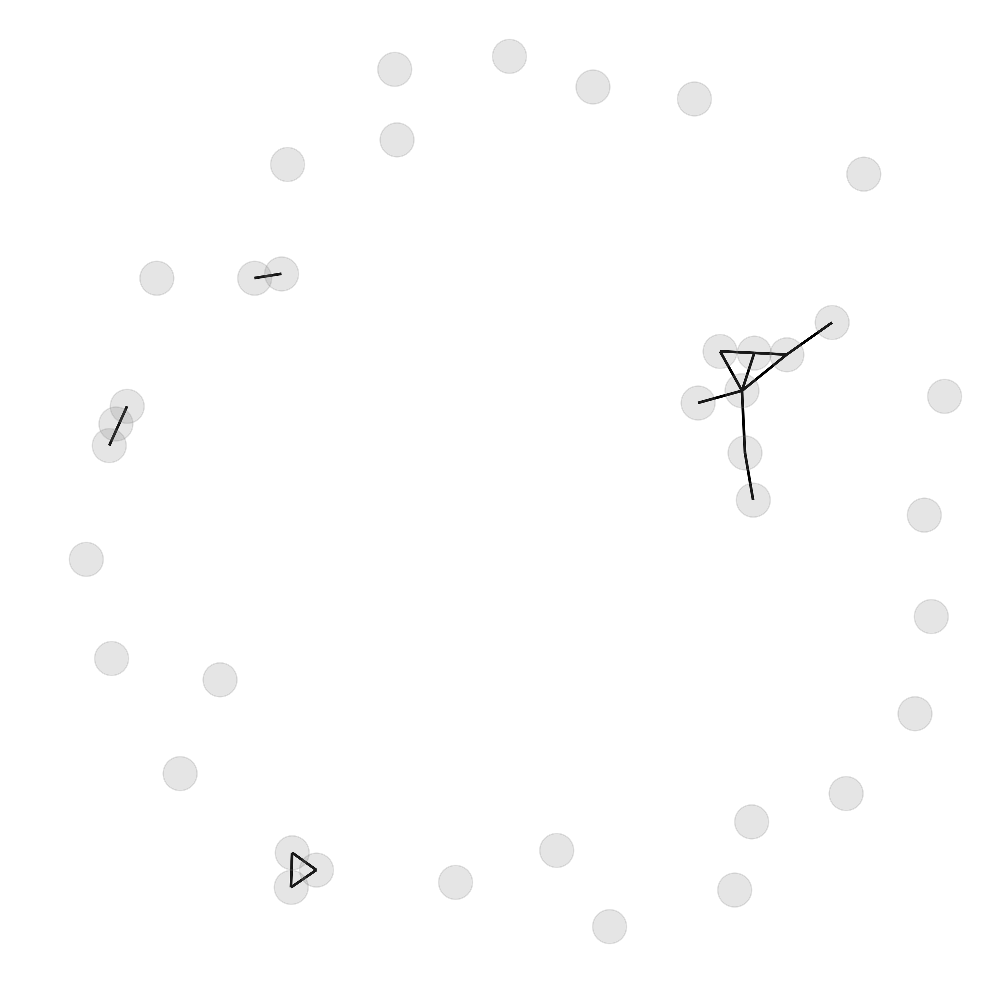

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Tone


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


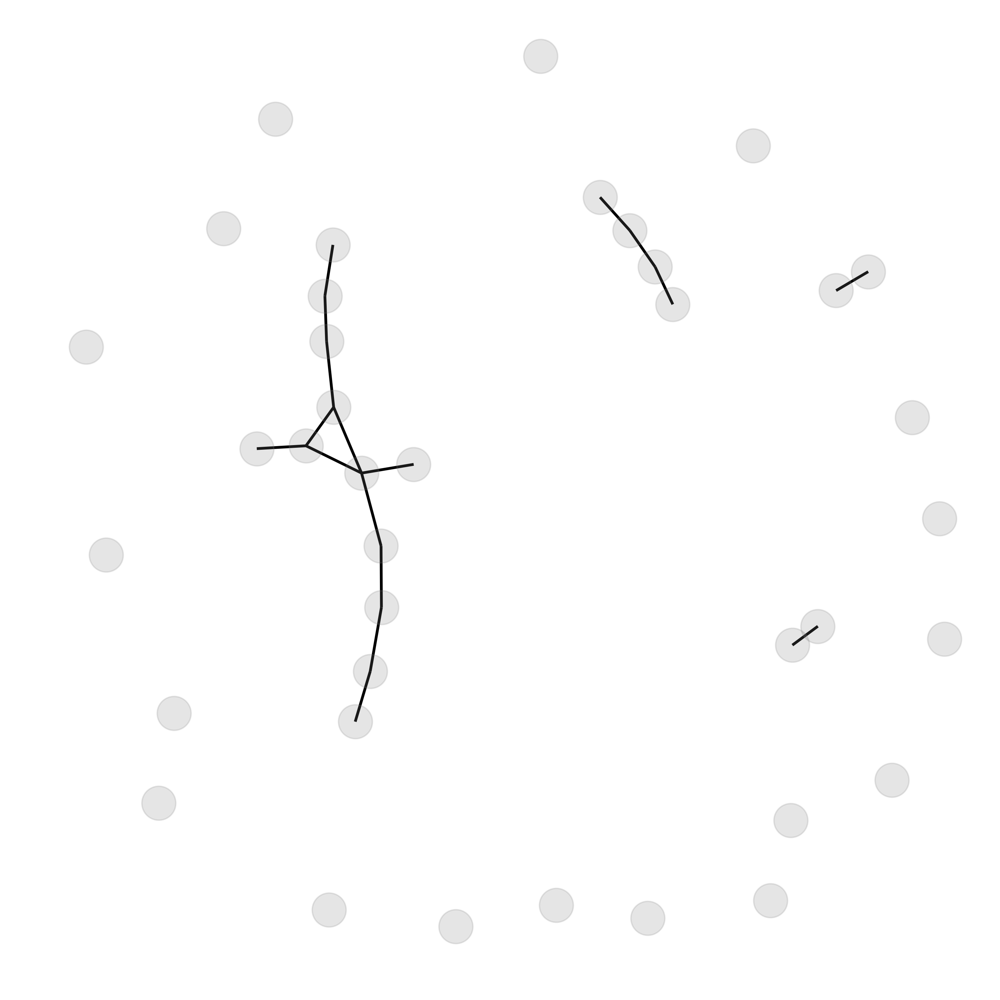

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

mouse_32
D1


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


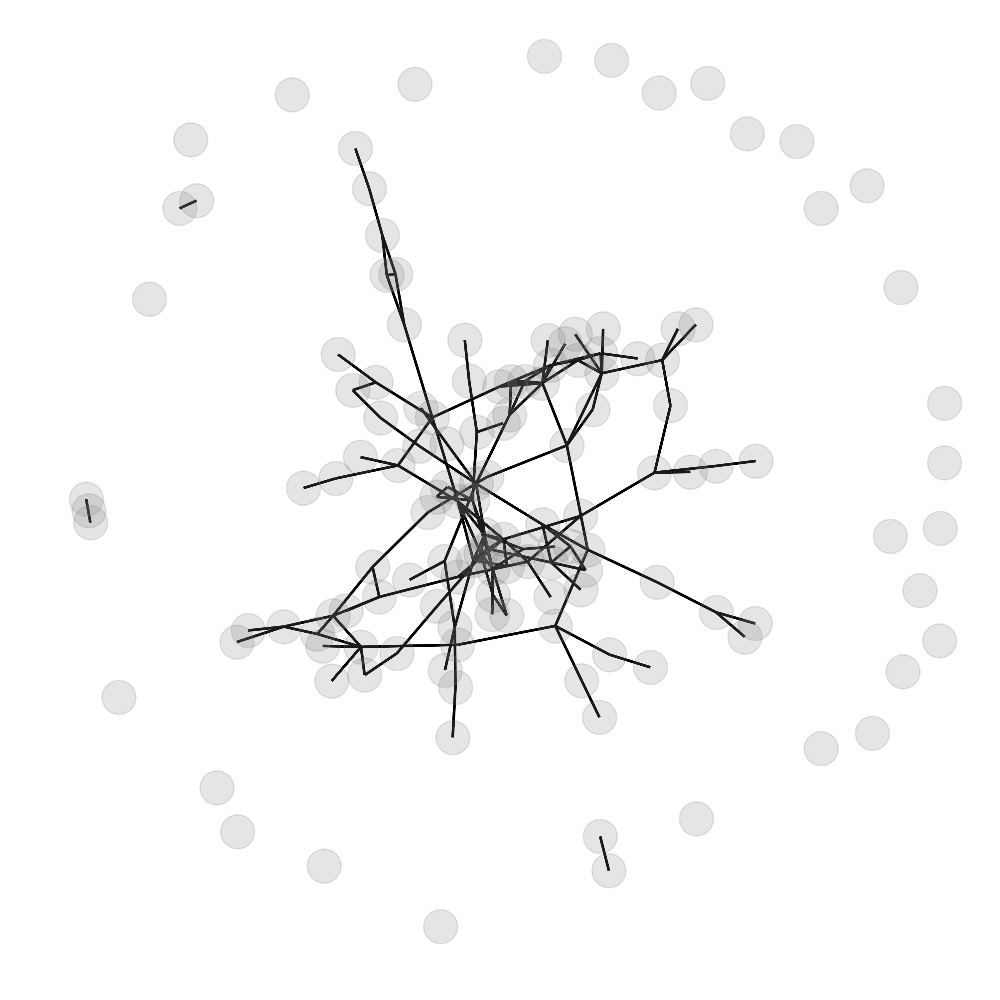

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D2


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


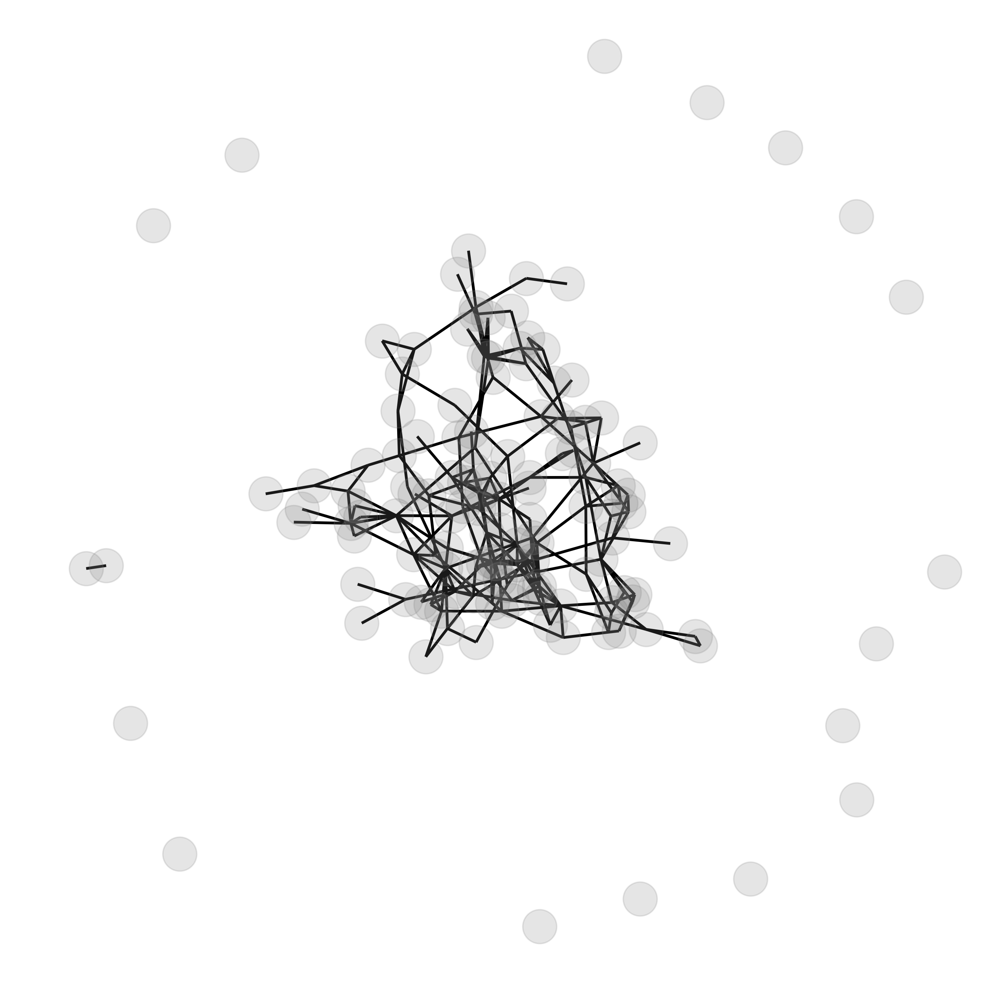

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Ctx


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


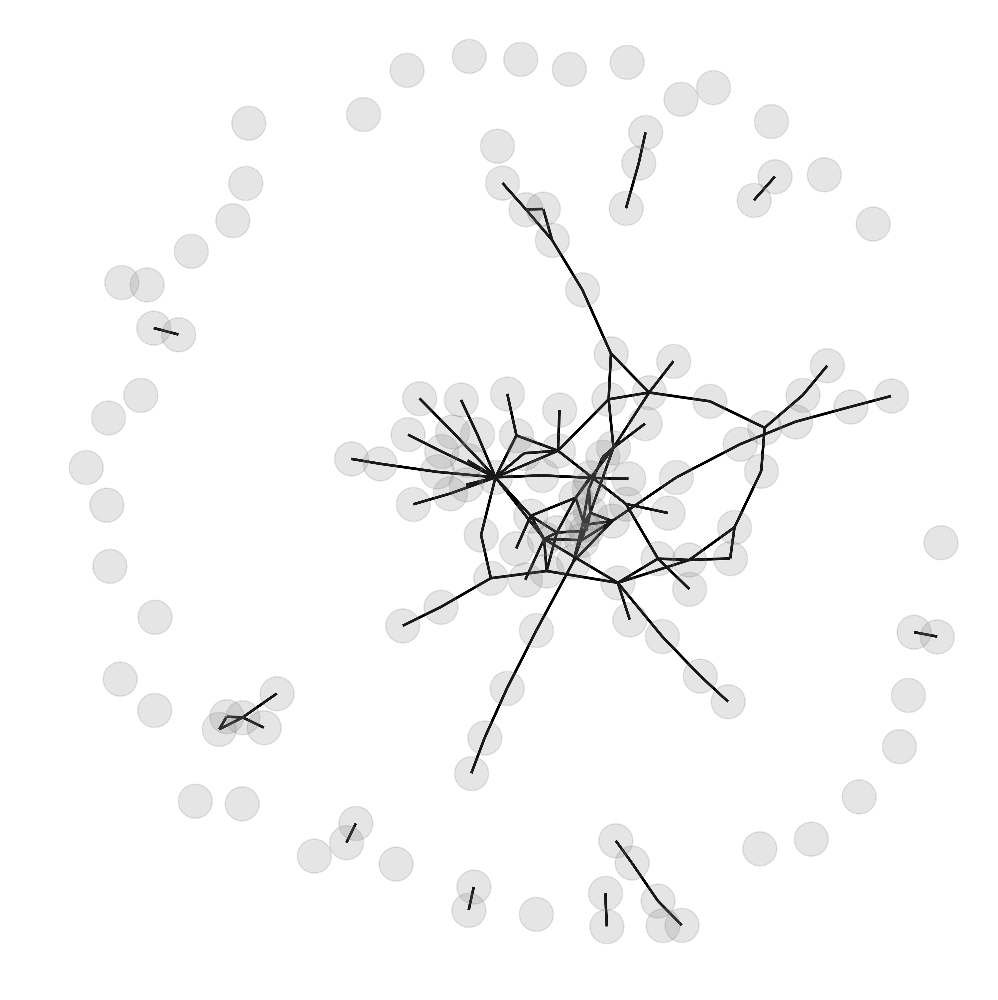

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Tone


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


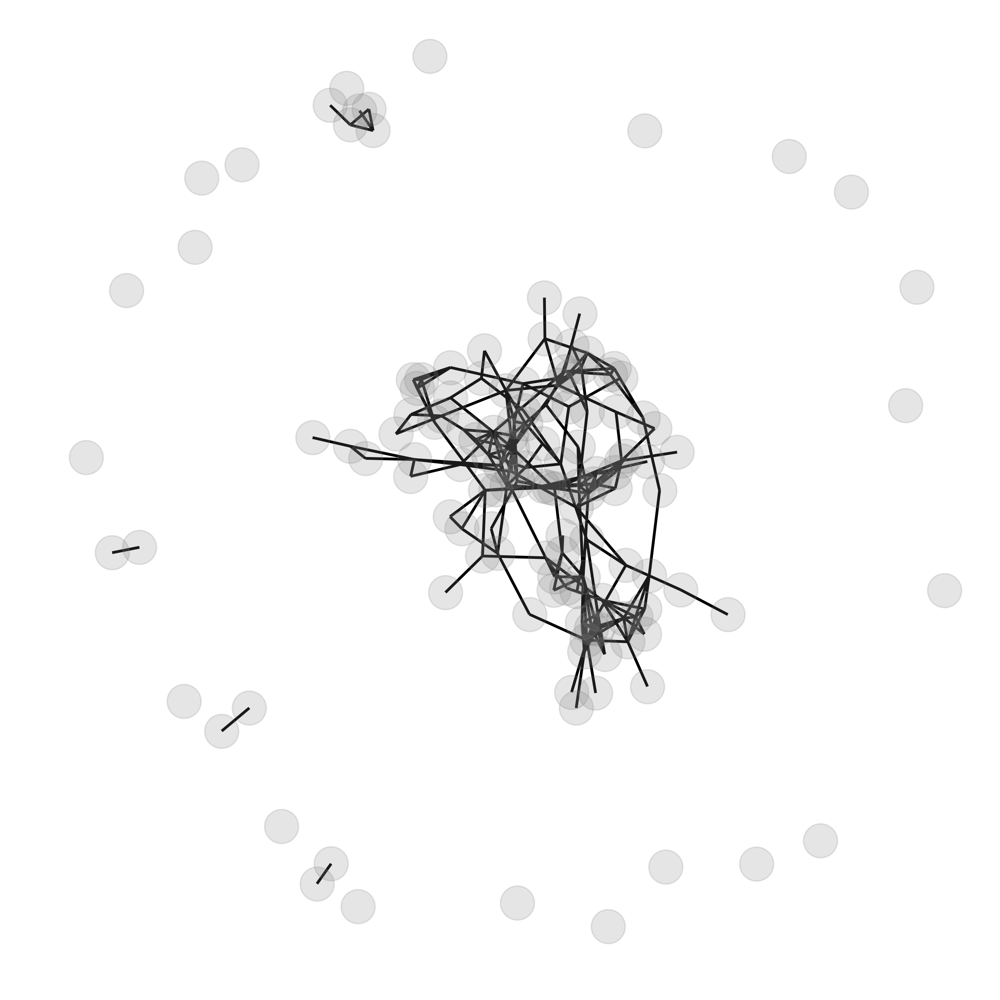

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

mouse_33
D1


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


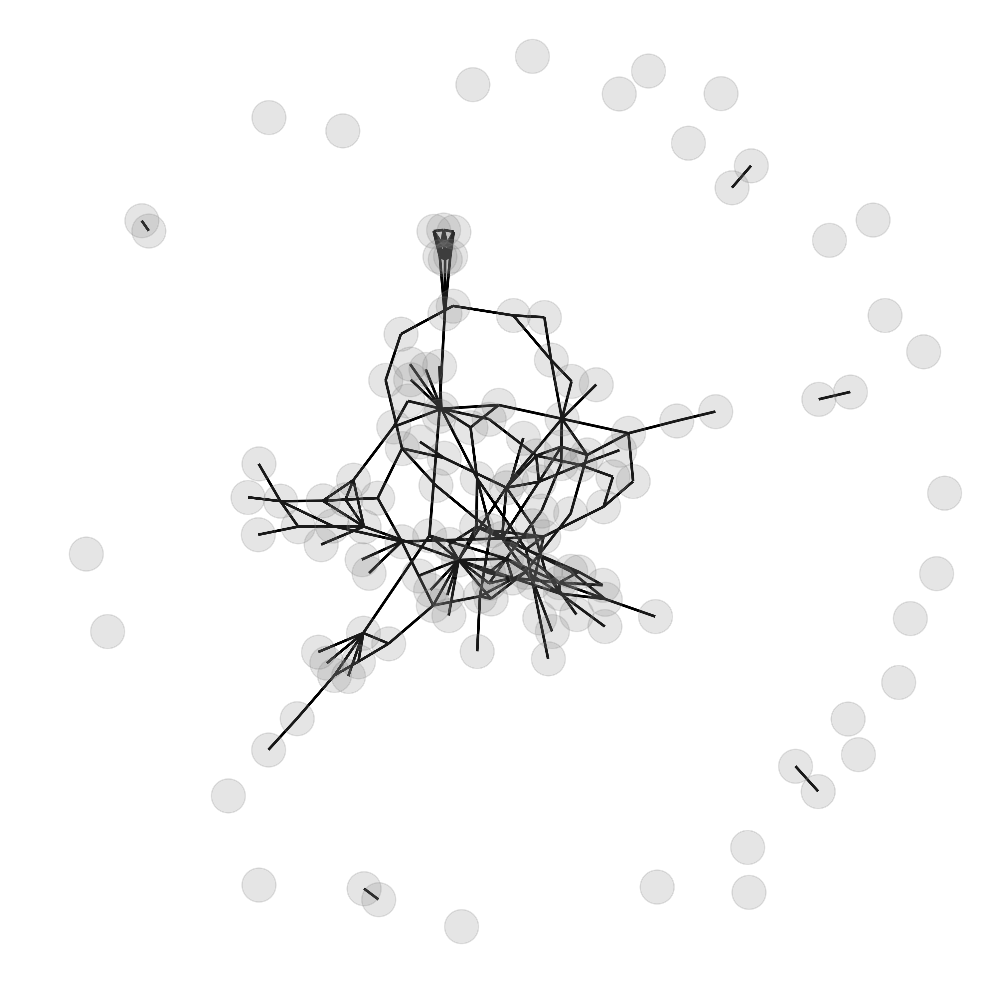

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D2


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


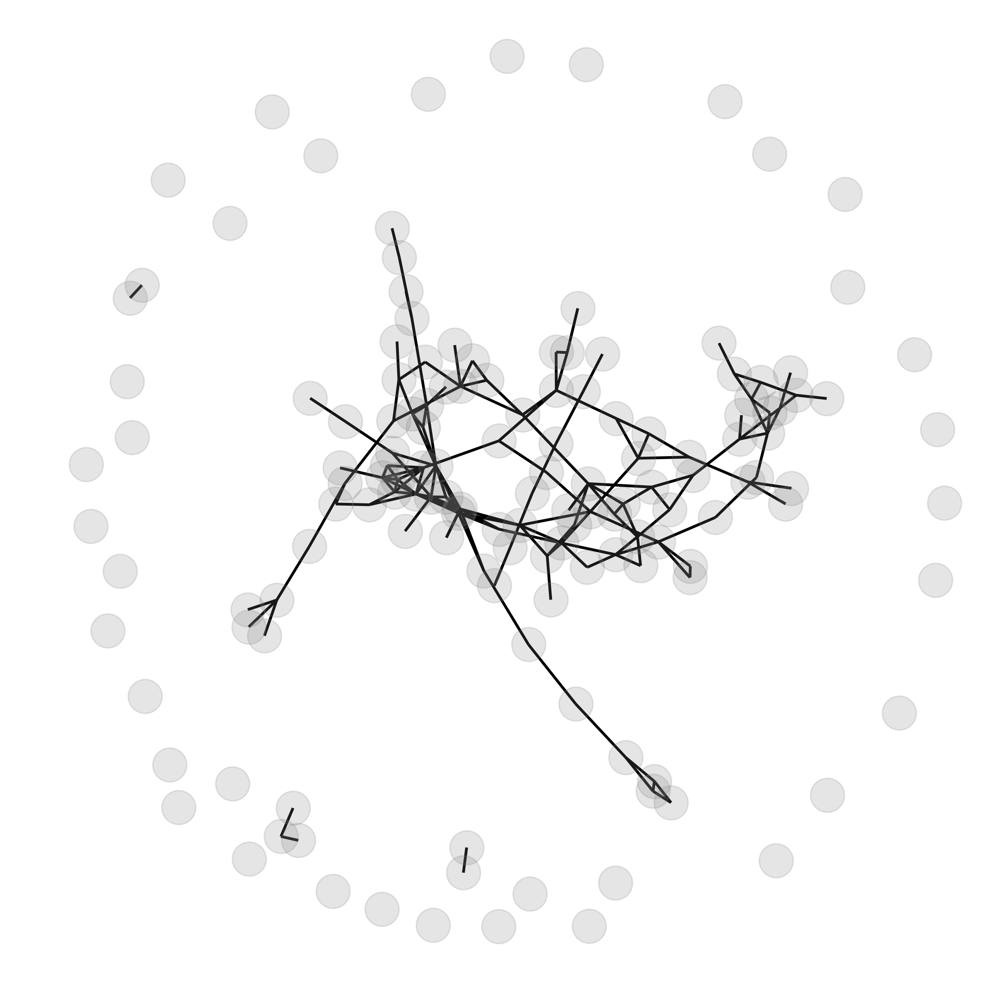

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Ctx


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


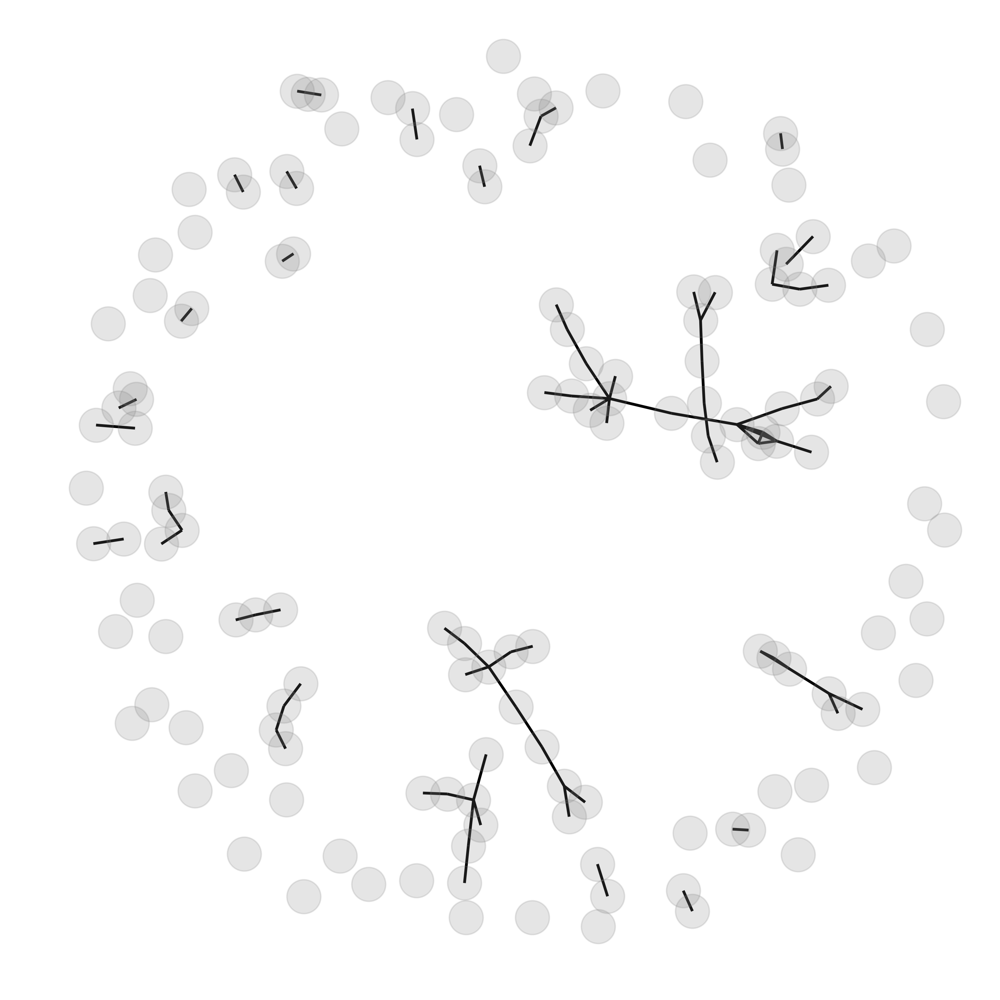

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Tone


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


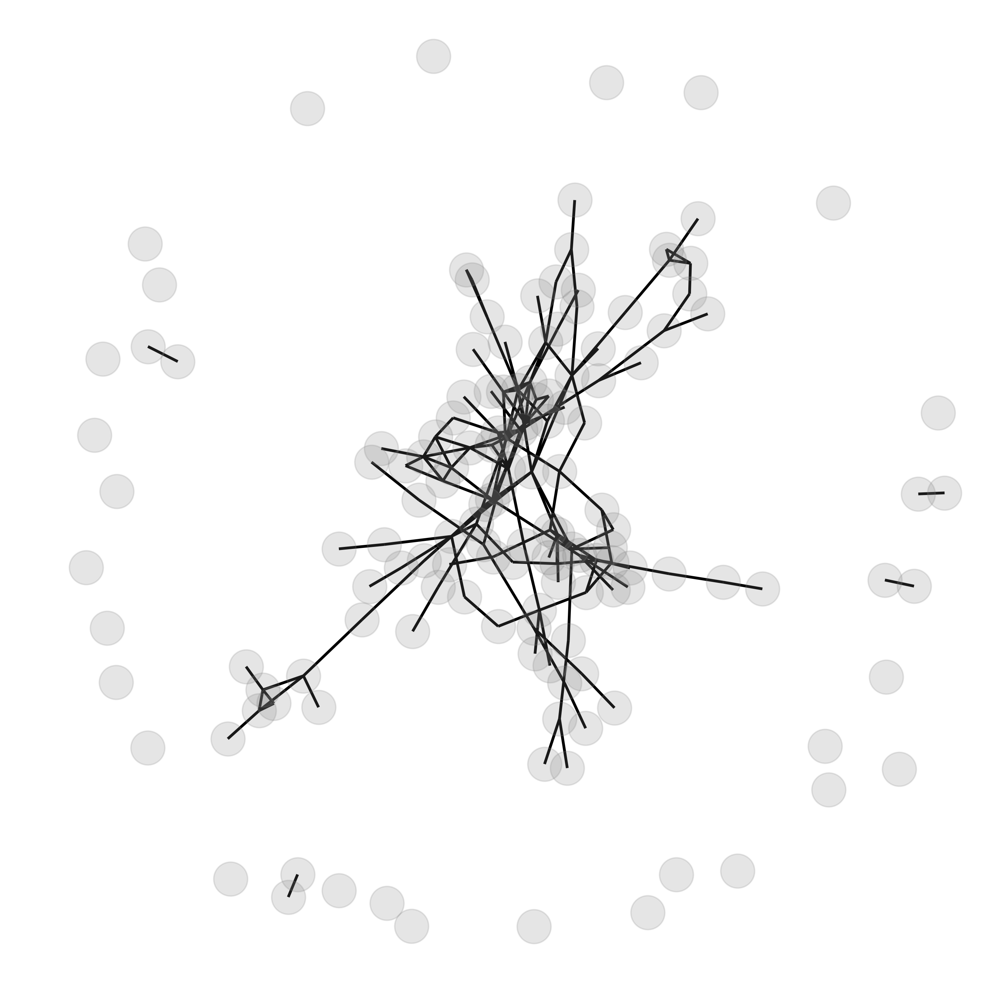

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

mouse_40
D1


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


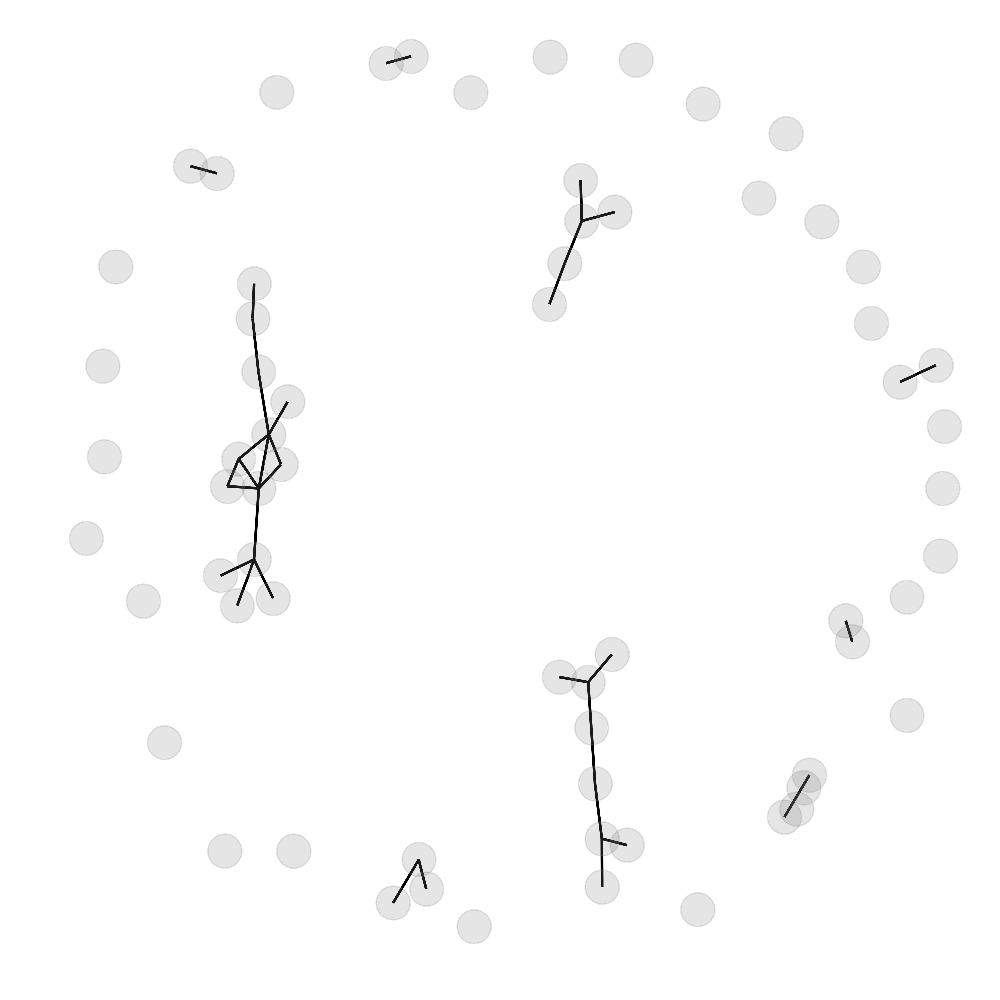

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D2


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


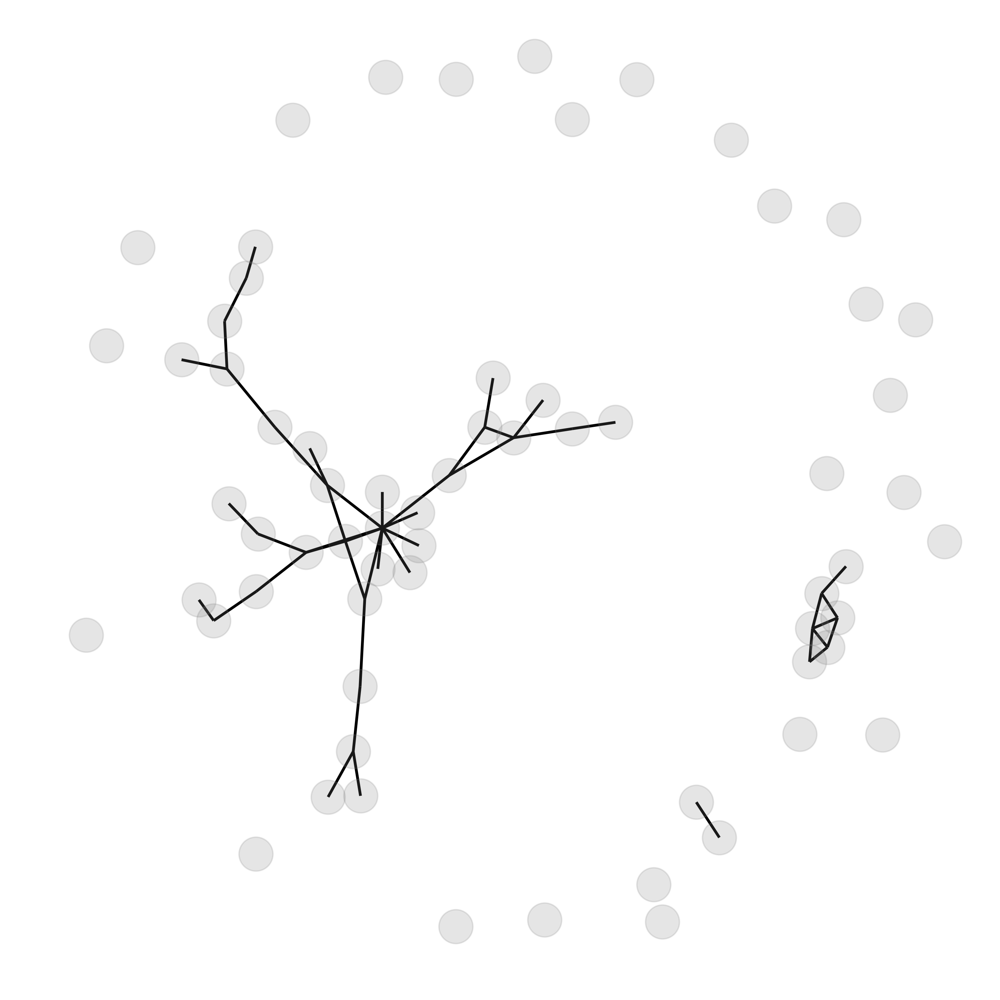

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Ctx


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


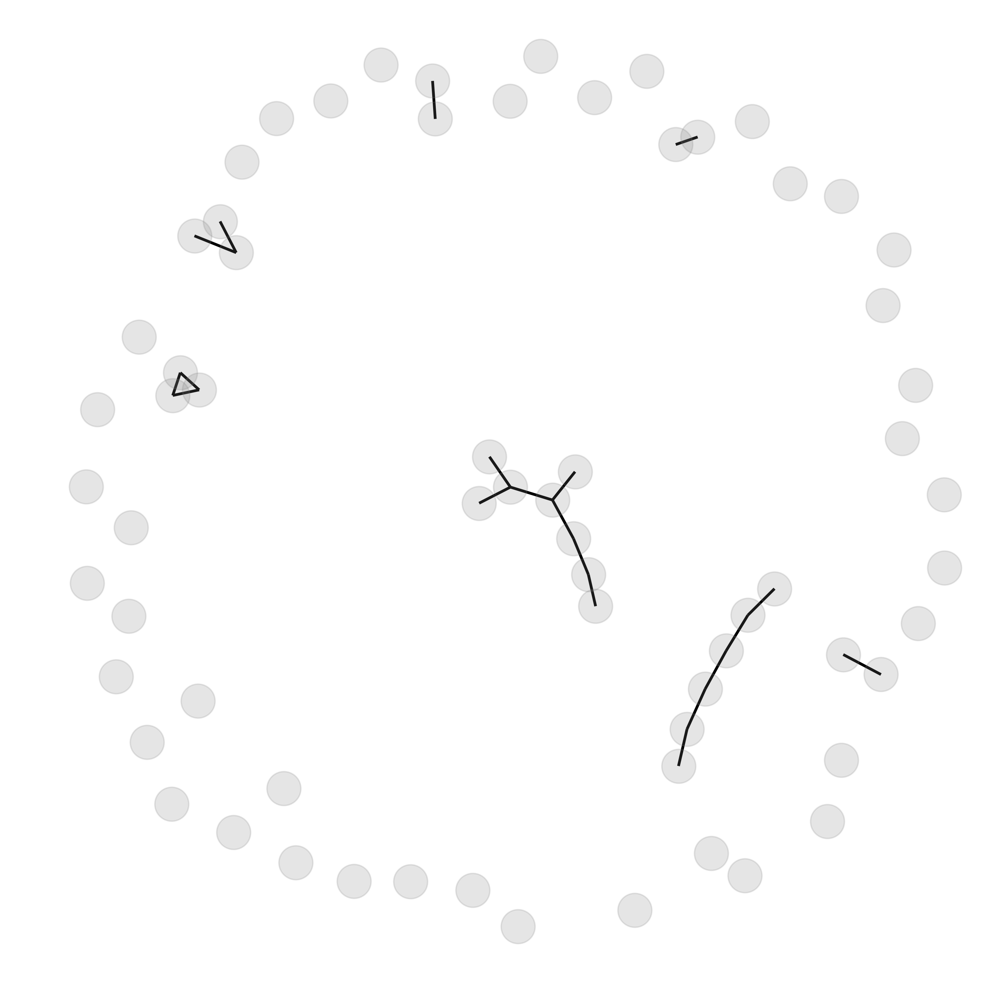

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Tone


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


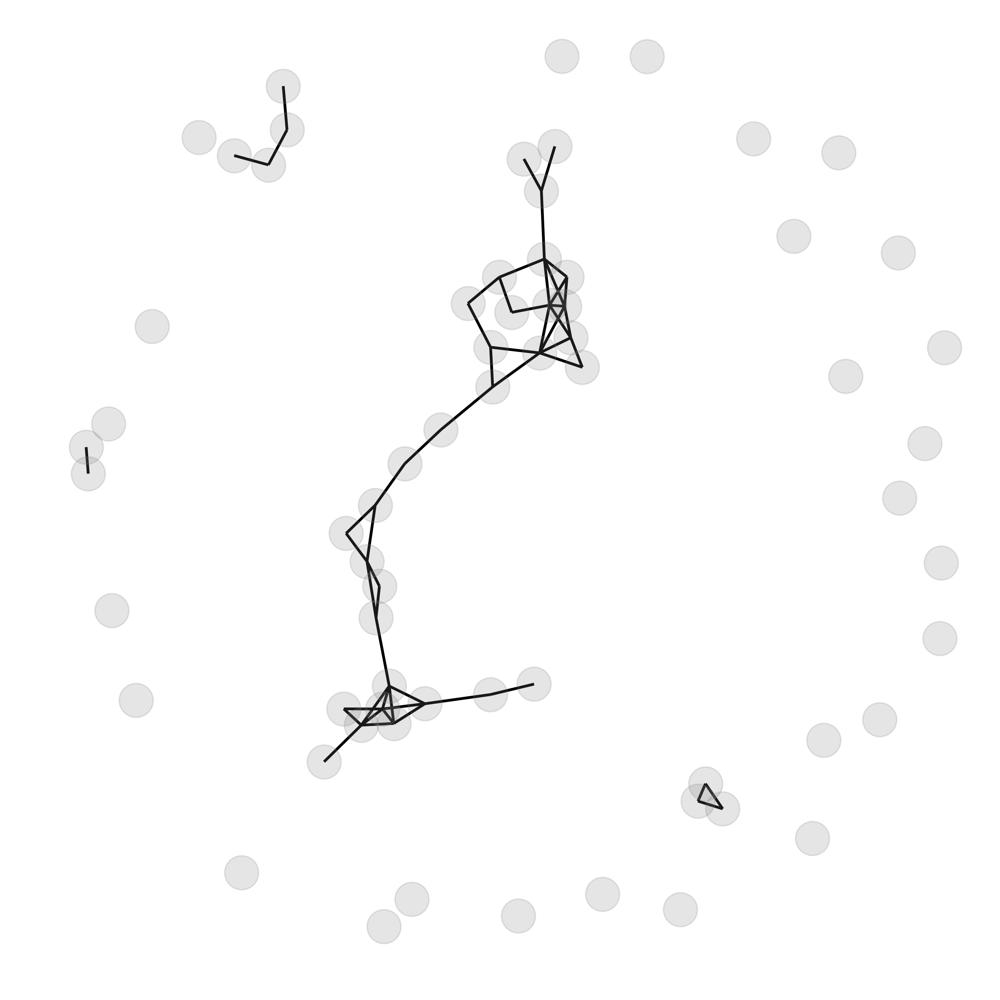

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

mouse_41
D1


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


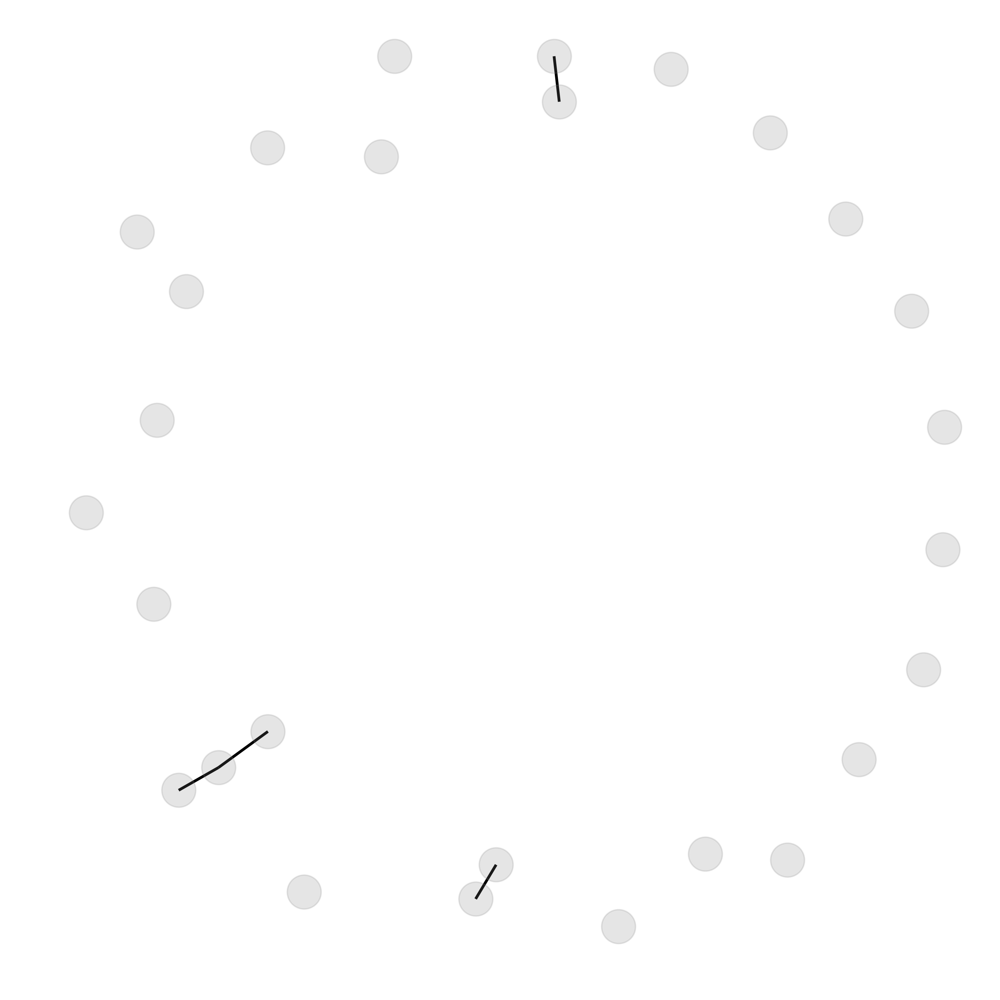

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D2


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


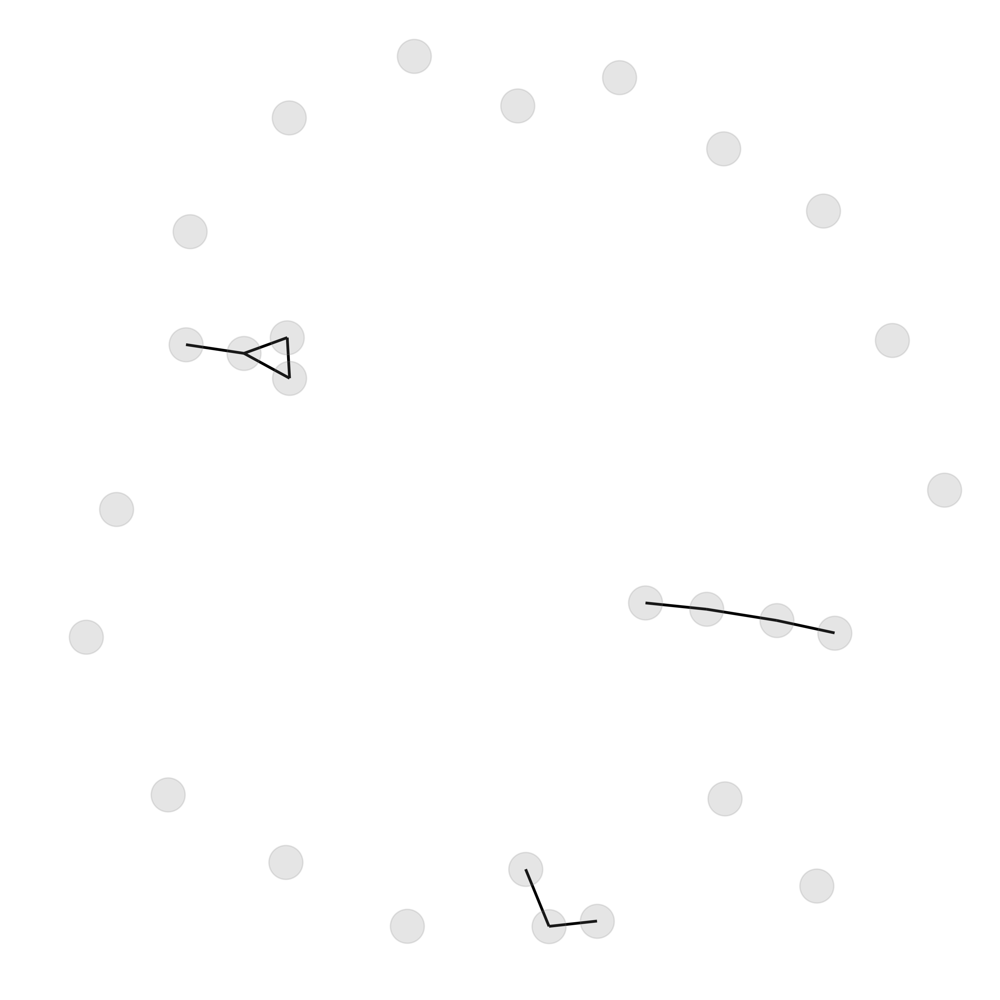

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Ctx


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


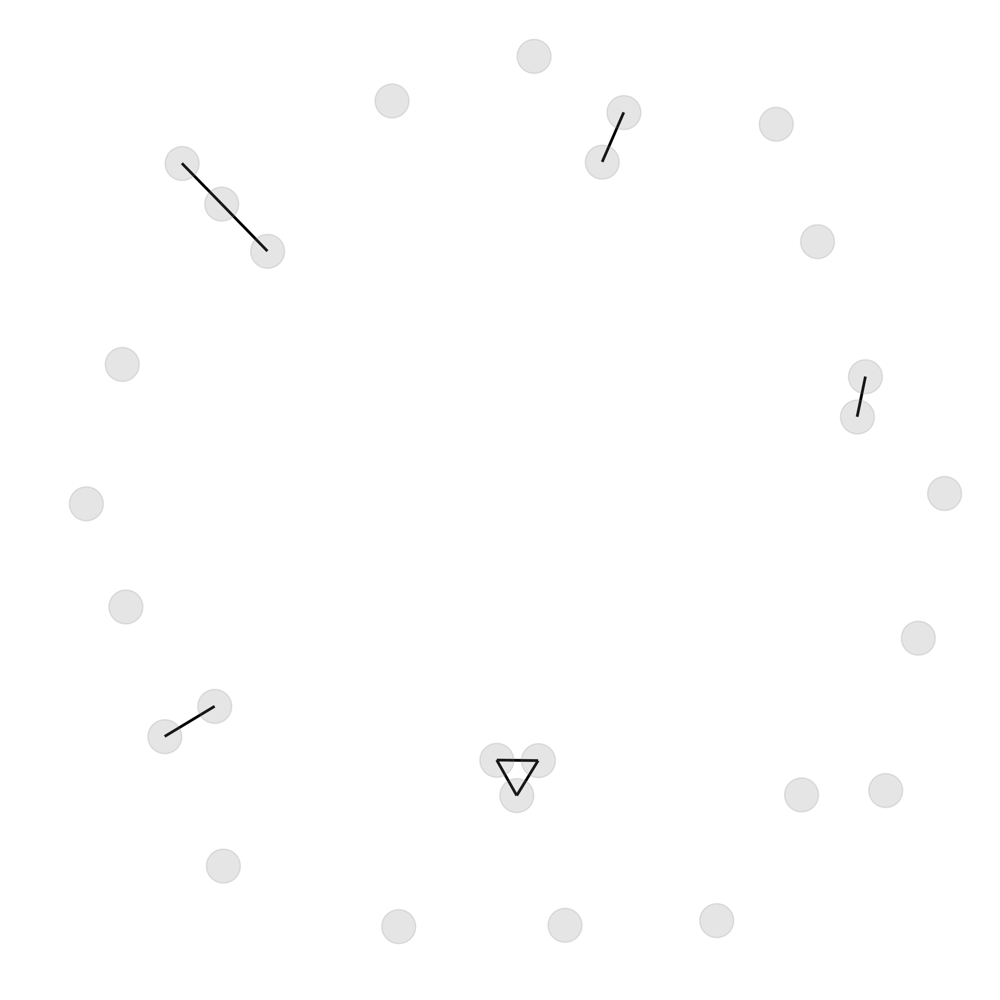

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Tone


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


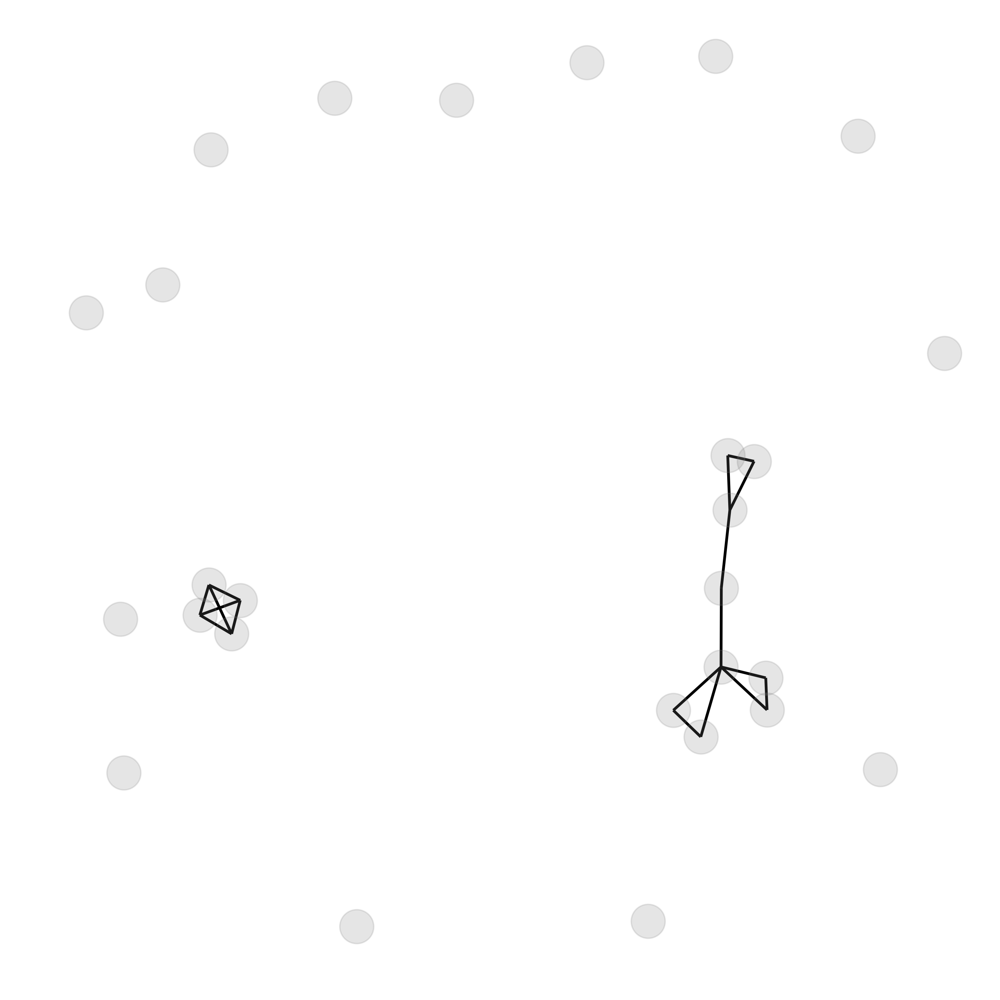

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

mouse_43
D1


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


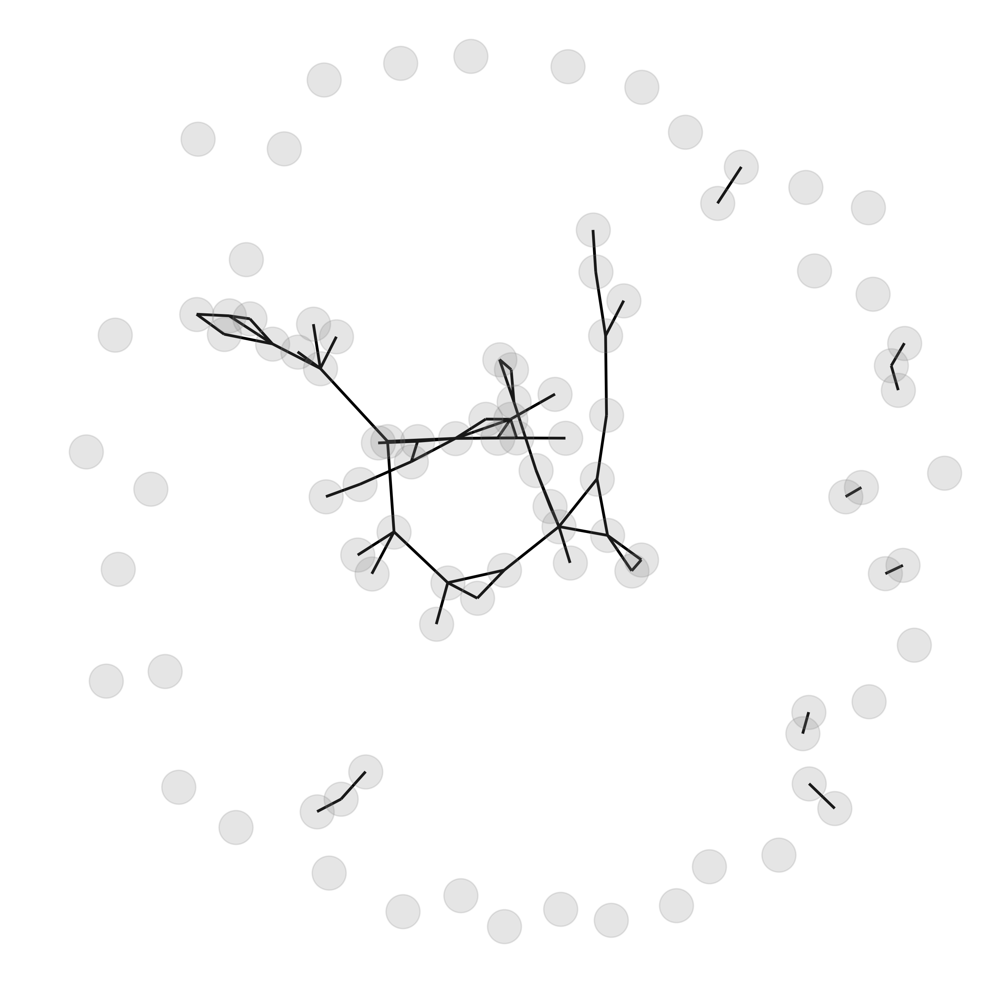

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D2


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


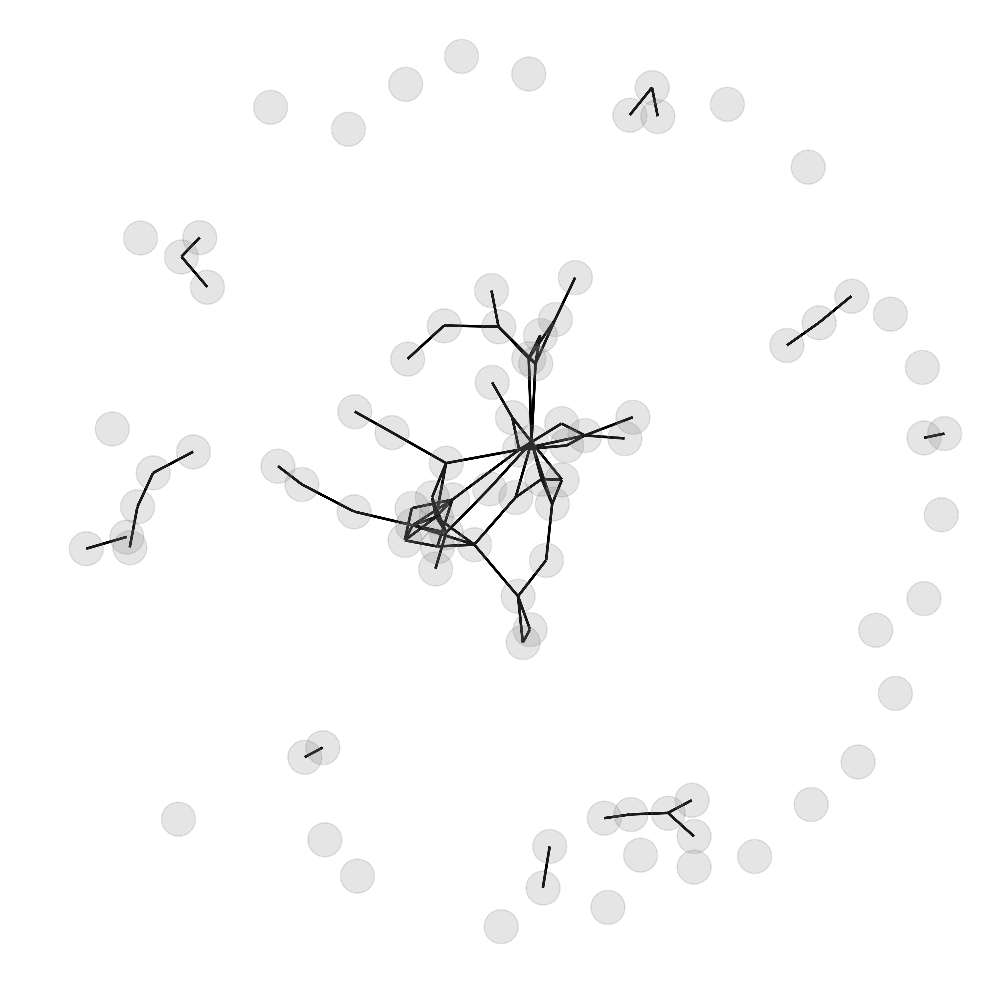

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Ctx


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


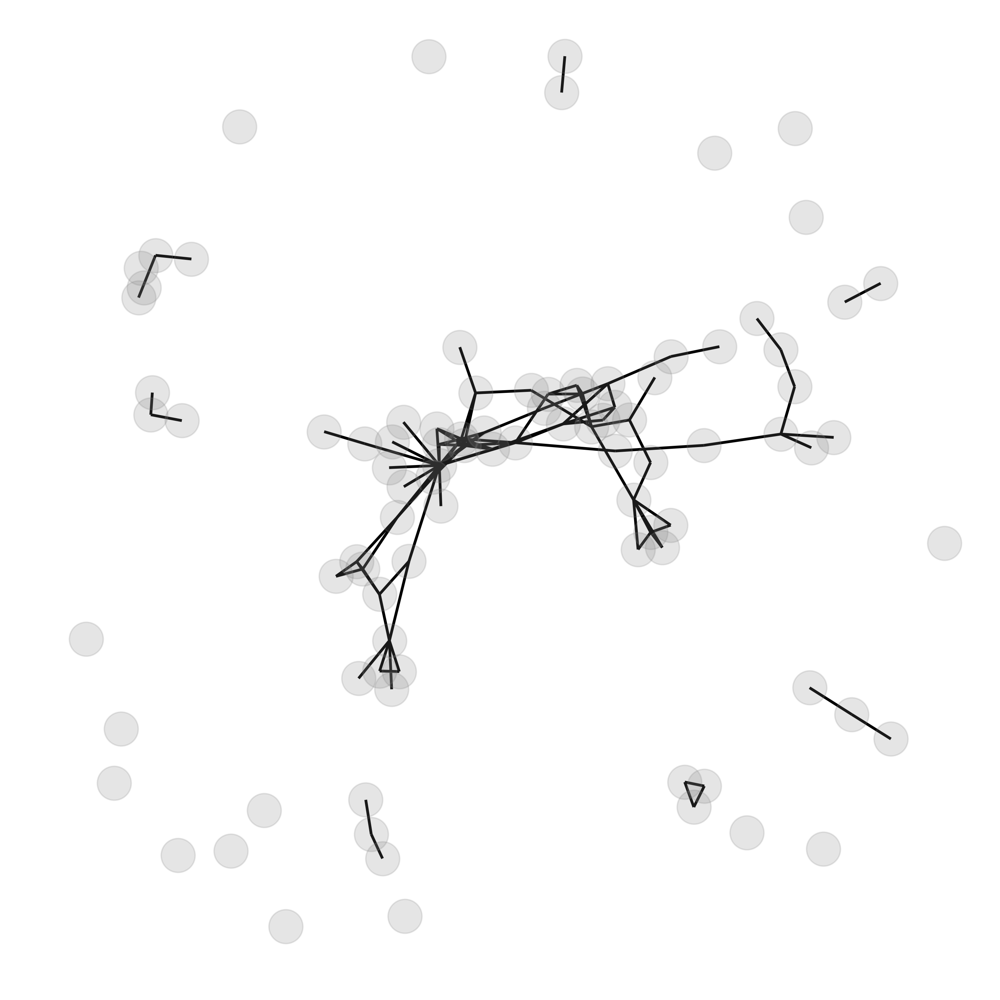

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Tone


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


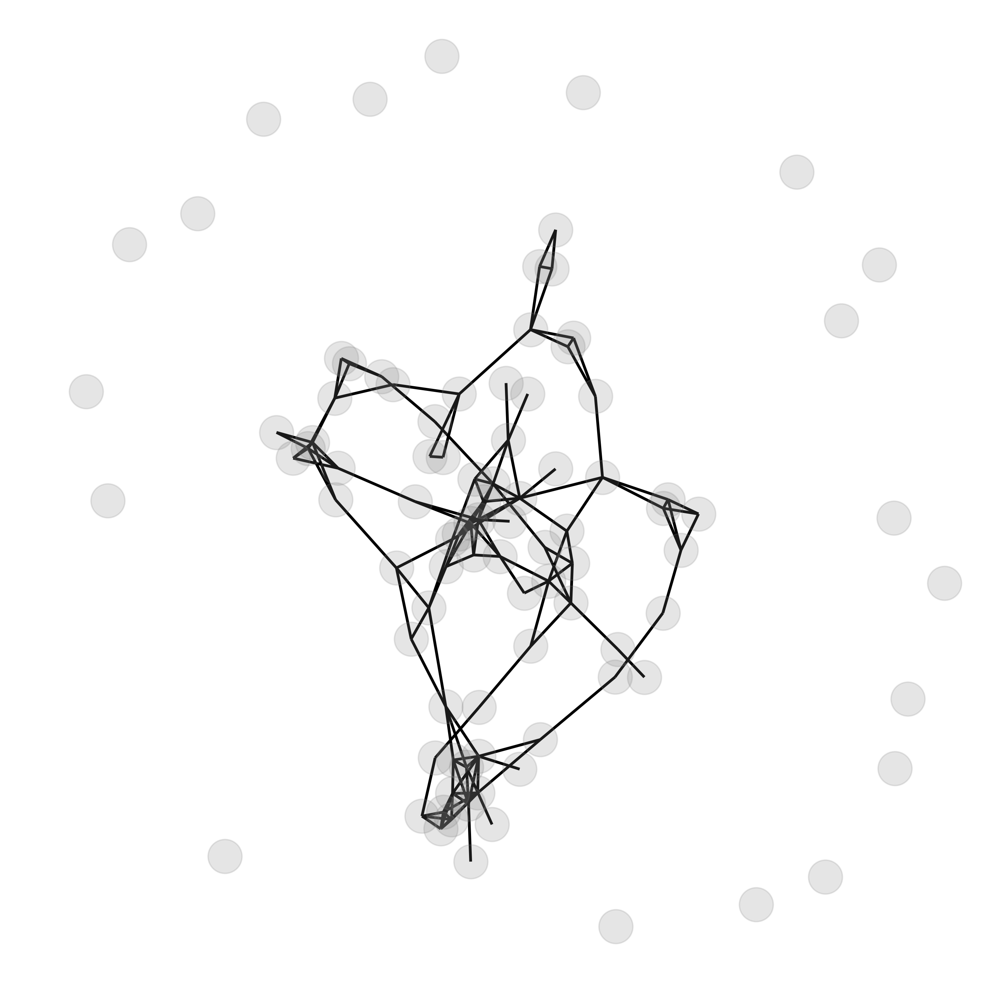

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

mouse_45
D1


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


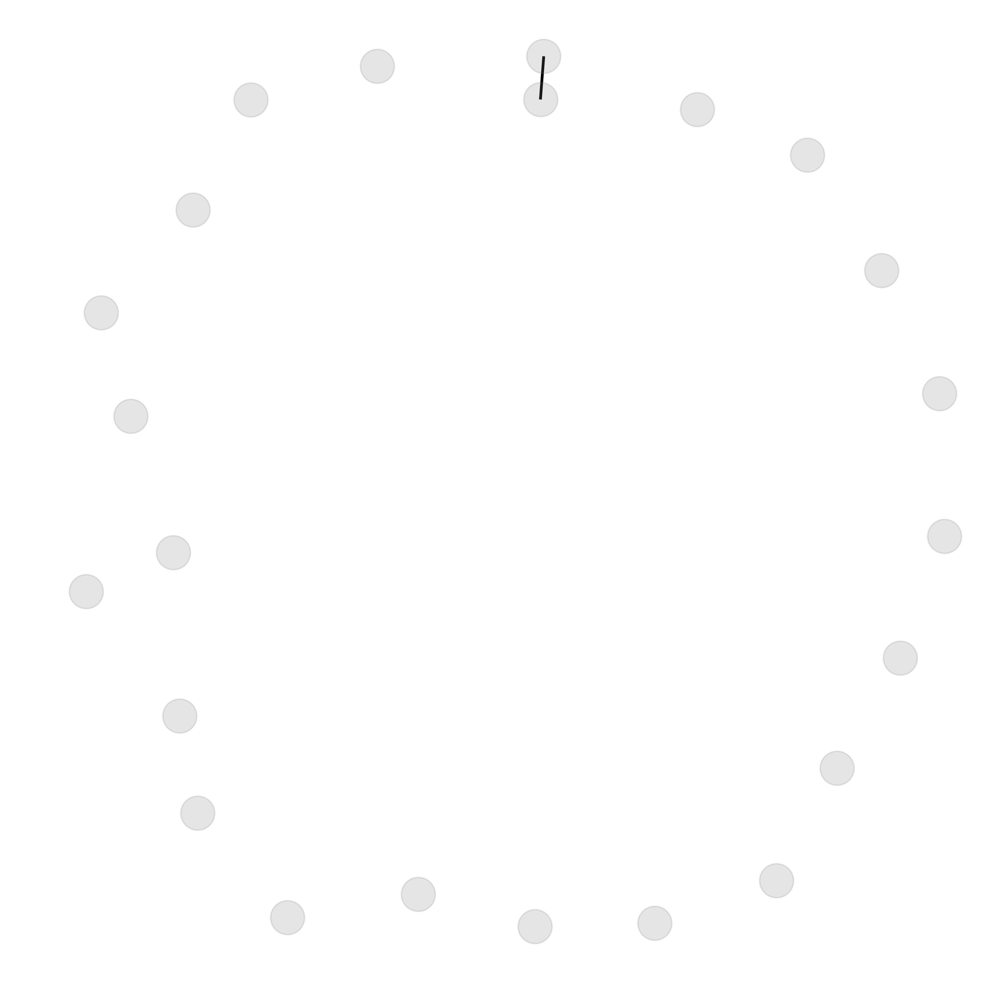

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D2


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


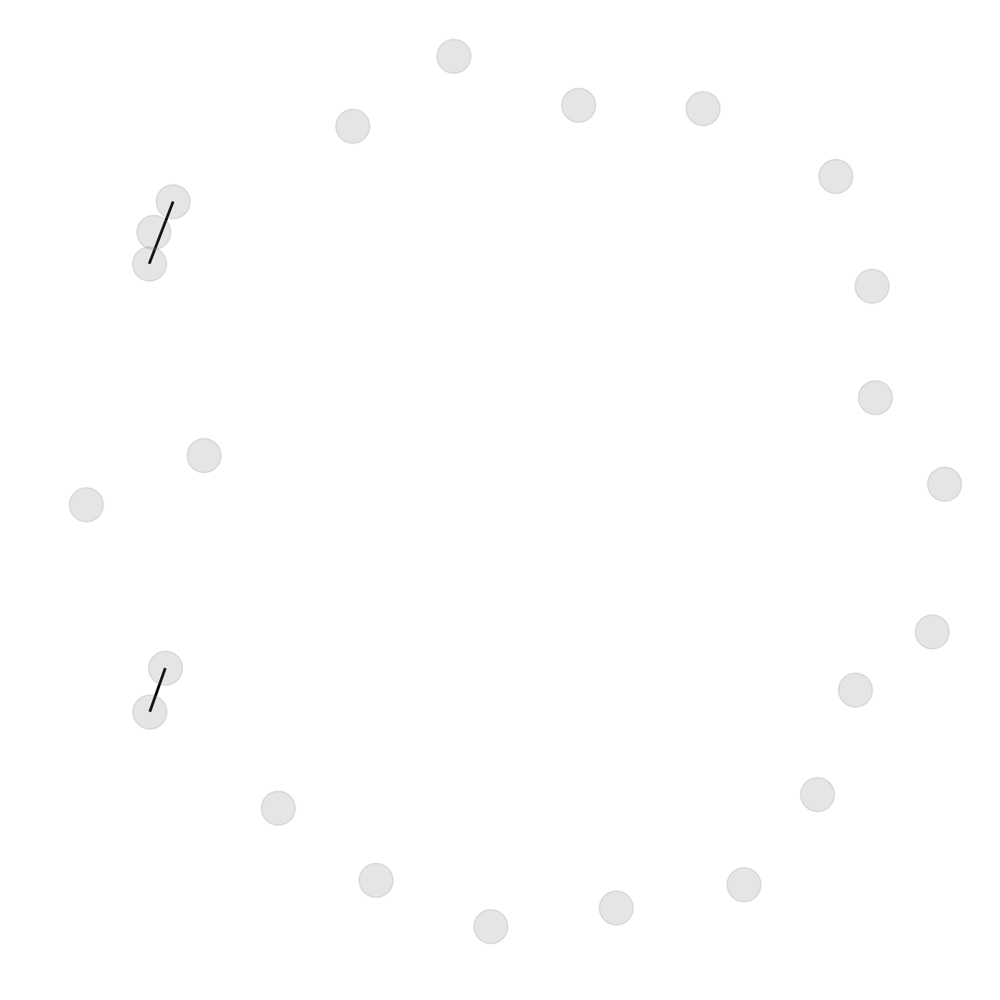

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Ctx


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


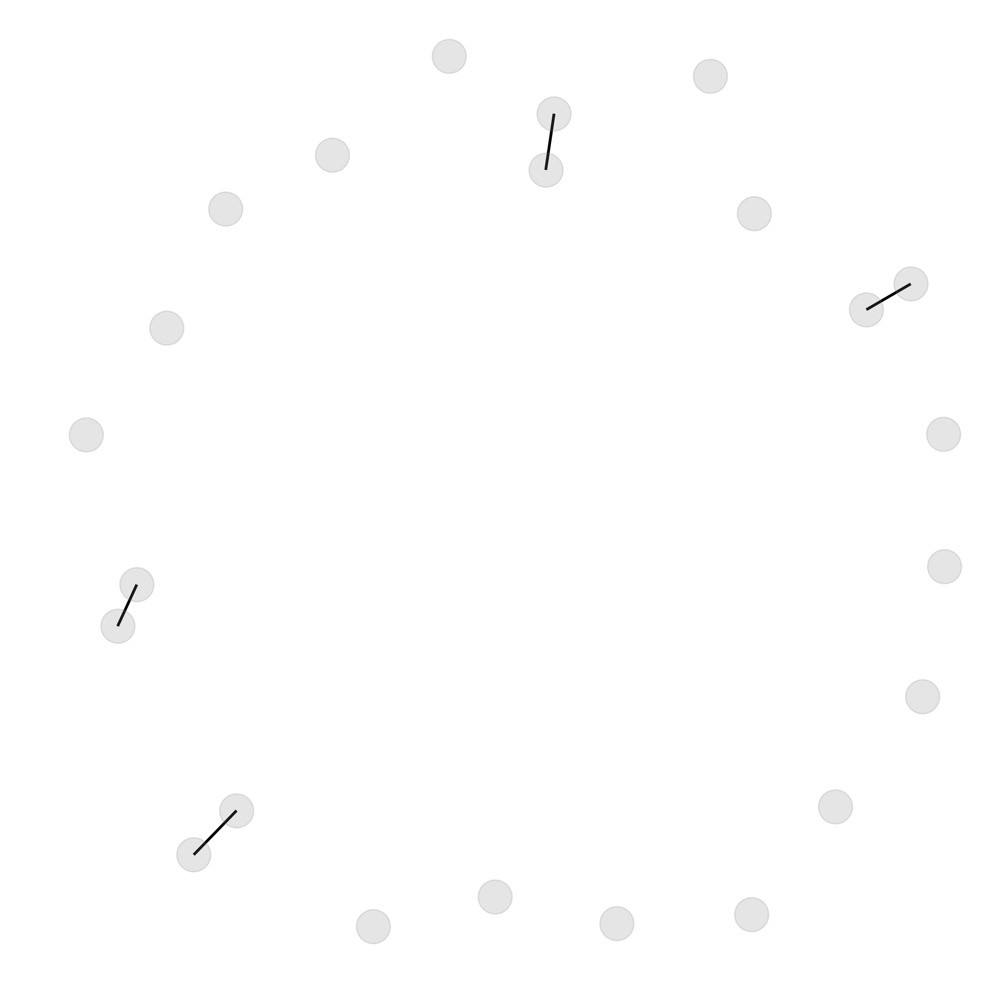

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

D3_Tone


You did not provide a neuron position dictionary. The spring layout function will be used to plot the network


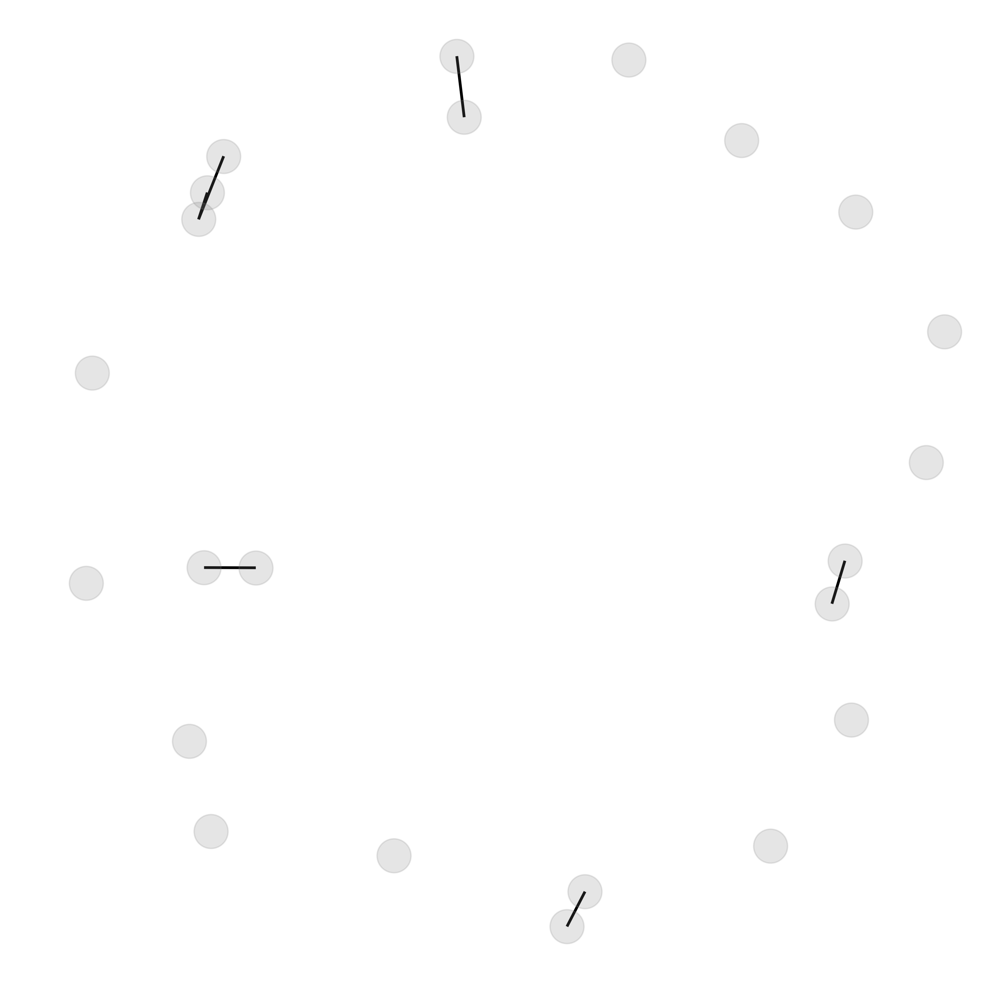

"\n            #Ctx Shock Related\n            print('Ctx Shock Related')\n            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);\n            \n            #Tone Shock Related\n            print('Tone Shock Related')\n            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           \n            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',\n                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);\n            \n            #Ctx_Only and Tone_Only Neighbors\n            print('Ctx_Only and Tone_Only Neighbors')\n            filename = fi

In [66]:
save_fig = False; #Save figures or not?

for m in fear_tone_mice_ids:
    if m in fear_ctx_mice_ids:
        mouse_name = 'mouse_' + m
       # c_list_ctx = label_list(neurons[mouse_name],ctx_shock_cells[mouse_name],ctx_shock_neighbors[mouse_name],labels=['red','blue','grey'],both='red') #color ctx shock cells and neighbors
        #c_list = label_list(neurons[mouse_name],ctx_only_shock_cells[mouse_name],tone_only_shock_cells[mouse_name],labels=['red','green','grey']) #color ctx_selective and tone_selective
       # c_list_tone = label_list(neurons[mouse_name],tone_shock_cells[mouse_name],tone_shock_neighbors[mouse_name],labels=['red','blue','grey'],both='red') #color tone shock cells and neighbors
       # c_list_engram = label_list(neurons[mouse_name],ctx_only_shock_neighbors[mouse_name],tone_only_shock_neighbors[mouse_name],labels=['blue','orange','grey'],both='green') #color tone shock cells and neighbors
        print(mouse_name)
        filename_base = 'C:/Users/berryja/Hen_Lab/Jess_CFC_all/Graphs/Vgat_Chrimson/Jess_CFC_'+mouse_name
        
        for k in corr_dict[mouse_name].keys():
            print(k)
            
            #All Grey
            filename = filename_base + '_nocolor_'+k+'.png'
            positions = graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',
                                      dpi=300,figsize=(10,10),node_colors = 'grey');
            """
            #Ctx Shock Related
            print('Ctx Shock Related')
            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           
            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',
                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);
            
            #Tone Shock Related
            print('Tone Shock Related')
            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           
            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',
                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);
            
            #Ctx_Only and Tone_Only Neighbors
            print('Ctx_Only and Tone_Only Neighbors')
            filename = filename_base + '_ctx_only_tone_only_4color_'+k+'.svg'           
            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',
                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_engram, pos=positions);
                                      
            """

### Fear Ctx Fear Tone Mice

In [ ]:
"""
4 versions of each graph:
1: all grey, no labels
2: ctx shock related (red, blue and grey)
3: tone shock related (red, blue and grey)
4: ctx_only neighbors (blue), tone_only neighbors(orange), overlapping neighbors (brown) and all else grey

"""
save_fig = False; #Save figures or not?

for m in fear_tone_mice_ids:
    if m in fear_ctx_mice_ids:
        mouse_name = 'mouse_' + m
        c_list_ctx = label_list(neurons[mouse_name],ctx_shock_cells[mouse_name],ctx_shock_neighbors[mouse_name],labels=['red','blue','grey'],both='red') #color ctx shock cells and neighbors
        #c_list = label_list(neurons[mouse_name],ctx_only_shock_cells[mouse_name],tone_only_shock_cells[mouse_name],labels=['red','green','grey']) #color ctx_selective and tone_selective
        c_list_tone = label_list(neurons[mouse_name],tone_shock_cells[mouse_name],tone_shock_neighbors[mouse_name],labels=['red','blue','grey'],both='red') #color tone shock cells and neighbors
        c_list_engram = label_list(neurons[mouse_name],ctx_only_shock_neighbors[mouse_name],tone_only_shock_neighbors[mouse_name],labels=['blue','orange','grey'],both='green') #color tone shock cells and neighbors
        print(mouse_name)
        filename_base = 'C:/Users/berryja/Hen_Lab/Jess_CFC_all/Graphs/Fear_Ctx_Fear_Tone/Same_Positions/Jess_CFC_'+mouse_name
        
        for k in corr_dict[mouse_name].keys():
            print(k)
            
            #All Grey
            filename = filename_base + '_nocolor_'+k+'.svg'
            positions = graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',
                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = 'grey');
            
            #Ctx Shock Related
            print('Ctx Shock Related')
            filename = filename_base + '_ctx_shock_related_3color_'+k+'.svg'           
            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',
                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_ctx, pos=positions);
            
            #Tone Shock Related
            print('Tone Shock Related')
            filename = filename_base + '_tone_shock_related_3color_'+k+'.svg'           
            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',
                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_tone, pos=positions);
            
            #Ctx_Only and Tone_Only Neighbors
            print('Ctx_Only and Tone_Only Neighbors')
            filename = filename_base + '_ctx_only_tone_only_4color_'+k+'.svg'           
            graph[mouse_name][k].plot(save=save_fig,file_name = filename,linewidths=2,label_nodes=False,a=.2,edgeweight=2,edgecolor='k',
                                      dpi=300,format = 'svg',figsize=(10,10),node_colors = c_list_engram, pos=positions);

### Neutral Ctx Fear Tone Mice

In [ ]:
for m in fear_tone_mice_ids:
    if m in neutral_ctx_mice_ids:
        mouse_name = 'mouse_' + m
        c_list = label_list(neurons[mouse_name],tone_shock_cells[mouse_name],labels=['green','blue'])
        print(mouse_name)
        for k in corr_dict[mouse_name].keys():
            filename = 'C:/Users/berryja/Hen_Lab/Jess_CFC_all/Graphs/Neutral_Ctx_Fear_Tone/Jess_CFC_'+mouse_name+"_"+k+'_nocolor_nolabels.svg'
            print(k)
            graph[mouse_name][k].plot(save=True,file_name = filename,linewidths=2,a=.2, edgecolor='k',label_nodes=False,dpi=300,format = 'svg',figsize=(10,10),node_colors = 'grey',node_size=600);


### Neutral Ctx Neutral Tone Mice

In [ ]:
for m in neutral_tone_mice_ids:
    mouse_name = 'mouse_' + m   
    print(mouse_name)
    for k in corr_dict[mouse_name].keys():
        filename = 'C:/Users/berryja/Hen_Lab/Jess_CFC_all/Graphs/Neutral_Ctx_Neutral_Tone/'+mouse_name+"_"+k+'nolabels_nocolors.svg'
        print(k)
        graph[mouse_name][k].plot(save=True,file_name = filename, a=.2,edgecolor='k',label_nodes=False,linewidths=2,dpi=300,format='svg',figsize=(10,10),node_colors = 'grey',node_size=600)

In [11]:
#computations relating to components 

def num_elements_component(comps):
    #input: list of sets (output from nx.connected_components)
    #output: number of nodes in the components
    
    num_nodes = 0
    
    for c in comps:
        num_nodes += len(c)
    
    return num_nodes
    
def frac_nodes_in_component(g,threshold):
    """inputs
            g: graph
            threshold: minimum size of component
            
        output
            fraction of nodes that are in a connected component larger than threshold
    """
    comps = list(nx.connected_components(g))
    big_comps = [c for c in comps if len(c) > threshold]
    #print(sorted(big_comps, key=len))
    num_nodes = num_elements_component(big_comps)
    
    return num_nodes / len(g)
    
    
def is_component_member(g,neuron,threshold):
    """
    inputs
        g: graph
        neuron: name of cell to test whether its in component
        threshold: minimum component size
    output:
        0 if node is not in a component, 1 if node is in component
    
    """
    comps = list(nx.connected_components(g))
    big_comps = [c for c in comps if len(c) > threshold]
    #print(big_comps)
    for c in big_comps:
        if neuron in c: return 1
    return 0

def is_shock_component_member(g,neuron,threshold,shock_cells):
    """
    inputs
        g: graph
        neuron: name of cell to test whether its in a shock cell-containing component
        threshold: minimun component size
        shock_cells: list of cells that must be found in a component
    
    output
        0 if node is not in a shock-containing component, 1 if node is in component
    """
    comps = list(nx.connected_components(g))
    big_comps = [c for c in comps if len(c) > threshold]
    shock_comps = [c for c in big_comps if (not c.isdisjoint(shock_cells))]
    #print(big_comps)
    for c in shock_comps:
        if neuron in c: return 1
    return 0

In [13]:
this_cell=87
is_shock_component_member(graph['mouse_16']['D2'].network,this_cell,2,ctx_shock_cells['mouse_16'])
is_component_member(graph['mouse_16']['D2'].network,this_cell,2)

KeyError: 'mouse_16'

### Compute graph measures

In [12]:
import networkx as nx

graph_measures_dict = dict()
mouse_graph_measures_dict = dict()

#mouse_name = 'mouse_43'

for m in mice_ids:
    mouse_name = 'mouse_'+m
    
    

    graph_measures_dict[mouse_name] = dict()
    
    
    for k in graph[mouse_name].keys():
        
        mouse_col = []
        neuron_col = []
        day_col = []
        mouse_group_col = []
        
        ctx_selectivity_col = []
        ctx_shock_neighbor_col = []
        ctx_shock_related_col = []  #Not shock related (not shock selective or neighbor)
        ctx_shock_component_col = [] #is cell in a component that contains a ctx shock selective cell?
        ctx_only_shock_component_col = [] # is cell in a component that contains a ctx_only shock cell?
        ctx_group_col = []
        
        tone_selectivity_col = []
        tone_shock_neighbor_col = []
        tone_shock_related_col = []  #Not shock related (not shock selective or neighbor)
        tone_shock_component_col = [] #is cell in a component that contains a tone shock selective cell?       
        tone_only_shock_component_col = [] # is cell in a component that contains a tone_only shock cell?
        tone_group_col = []        
        
        # Related to specific type of shock cell? (tone only, ctx only, or ss)
        ctx_only_shock_related_col = [] #related to ctx_only cell
        tone_only_shock_related_col = [] #related to tone_only cell?
        ctx_tone_shock_related_col = [] #is cell ss_shock, ss_shock neighbor, or ss_unrelated?
        
        component_col = [] #is neuron in a component on current day?
        ctx_tone_shock_component_col = [] #is cell in a component that contains a ctx_tone shock cell?
        
        g=graph[mouse_name][k]
        g_size = nx.number_of_nodes(g.network) #number of nodes/neurons
        mouse_col.extend(np.tile(mouse_name,g_size))
        neuron_col.extend(range(1,1+g_size))
        
        if m in vgat_chrim_mice_ids:
            mouse_group_col.extend(np.tile('Vgat_Chrim',g_size))
        else:
            mouse_group_col.extend(np.tile('Vgat_mCherry',g_size))
        #if m in fear_tone_mice_ids:
        
        if m in list(set(fear_tone_mice_ids) - set(vgat_chrim_mice_ids) - set(vgat_mcherry_mice_ids)):
            tone_selectivity_col = label_list(neurons[mouse_name],tone_shock_cells[mouse_name],labels=['Tone_Shock','No Tone_Shock'])
            tone_shock_neighbor_col = label_list(neurons[mouse_name],tone_shock_neighbors[mouse_name],labels=['Tone_Shock Neighbor','Not Tone_Shock Neighbor'])
            
            #one column for all shock relatedness
            tone_shock_related_col = label_list(neurons[mouse_name],list(tone_shock_cells[mouse_name]), list(tone_shock_neighbors[mouse_name]),
                                            labels=['Tone_Shock Selective','Tone_Shock Neighbor','Tone_Shock Unrelated'],both="Tone_Shock Selective")
            
        else:
            tone_selectivity_col.extend(np.tile('NaN',g_size))
            tone_shock_neighbor_col.extend(np.tile('NaN',g_size))
            tone_shock_related_col.extend(np.tile('NaN',g_size))

        if m in list(set(fear_tone_mice_ids)):
            tone_group_col.extend(np.tile('Fear_Tone',g_size))
        else:
            tone_group_col.extend(np.tile('Neutral_Tone',g_size))
           
            
            
        #if m in fear_ctx_mice_ids:
        if m in list(set(fear_ctx_mice_ids) - set(vgat_chrim_mice_ids) - set(vgat_mcherry_mice_ids)):
            ctx_selectivity_col = label_list(neurons[mouse_name],ctx_shock_cells[mouse_name],labels=['Ctx_Shock','Not Ctx_Shock'])
            ctx_shock_neighbor_col = label_list(neurons[mouse_name],ctx_shock_neighbors[mouse_name],labels=['Ctx_Shock Neighbor','Not Ctx_Shock Neighbor'])
                   
            #one column for all shock relatedness
            ctx_shock_related_col = label_list(neurons[mouse_name],list(ctx_shock_cells[mouse_name]), list(ctx_shock_neighbors[mouse_name]),
                                            labels=['Ctx_Shock Selective','Ctx_Shock Neighbor','Ctx_Shock Unrelated'],both="Ctx_Shock Selective")
            #ctx_tone (SS) shock related
            ctx_tone_shock_related_col = label_list(neurons[mouse_name],list(ctx_tone_shock_cells[mouse_name]), list(ctx_tone_shock_neighbors[mouse_name]),
                                            labels=['Ctx_Tone Shock Selective','Ctx_Tone Shock Neighbor','Ctx_Tone Shock Unrelated'],both="Ctx_Tone Shock Selective")
            
            ctx_only_shock_related_col = label_list(neurons[mouse_name],list(ctx_only_shock_cells[mouse_name]), list(ctx_only_shock_neighbors[mouse_name]),
                                            labels=['Ctx_Only Shock Selective','Ctx_Only Shock Neighbor','Ctx_Only Shock Unrelated'],both="Ctx_Only Shock Selective")

            tone_only_shock_related_col = label_list(neurons[mouse_name],list(tone_only_shock_cells[mouse_name]), list(tone_only_shock_neighbors[mouse_name]),
                                            labels=['Tone_Only Shock Selective','Tone_Only Shock Neighbor','Tone_Only Shock Unrelated'],both="Tone_Only Shock Selective")
            
        else:
            ctx_selectivity_col.extend(np.tile('NaN',g_size))
            ctx_shock_neighbor_col.extend(np.tile('NaN',g_size))
            ctx_shock_related_col.extend(np.tile('NaN',g_size))
                        
            ctx_tone_shock_related_col.extend(np.tile('Nan',g_size))
            ctx_only_shock_related_col.extend(np.tile('Nan',g_size))
            tone_only_shock_related_col.extend(np.tile('Nan',g_size))
        day_col.extend(np.tile(k,g_size))
        
        if m in list(set(fear_ctx_mice_ids)):
            ctx_group_col.extend(np.tile('Fear_Ctx',g_size))
        else:
            ctx_group_col.extend(np.tile('Neutral_Ctx',g_size))
            
            
        #weighted clustering coefficient
        cc = pd.Series(data=nx.clustering(g.network,weight = "weight"))

        #weighted degree (sum of weights / total number of nodes)
        d = list(dict(g.network.degree(weight='weight')).values())
    
        d = [x/g_size for x in d]                  
        w_degree = pd.Series(data = d,index=range(1,g_size+1))

    
        #degree centrality (unweighted degree- requires thresholding)
        dc = list(nx.degree_centrality(g.network).values())
        degree_cent = pd.Series(data=nx.degree_centrality(g.network))
    
        #unweighted clustering coefficient
        uw_cc = pd.Series(data=nx.clustering(g.network))
        
        #Neurons with 0 or 1 neighbors have undefined CC (see Kaiser, 2008, arxiv)
        #for now, just set isolated nodes to nan
        #this throws out all/most cells for some mice. for now just use the networkx default
        #uw_cc[degree_cent ==0] = np.NaN
        
        #katz centrality, unweighted
        katz_cent=degree_cent #placeholder to keep from failing
        #katz_cent = pd.Series(data=nx.katz_centrality(g.network))
    
        #betweenness_centrality, unweighted
        bet_cent = pd.Series(data=nx.betweenness_centrality(g.network))
    
        # is componenet member
        
        for n in g.neurons:
            #component_d2_col.append(is_component_member(graph[mouse_name]['D2'].network,n,2))
            component_col.append(is_component_member(g.network,n,2))
            
            #check for shock_containing component
            
            #if m in fear_tone_mice_ids:
            if m in list(set(fear_tone_mice_ids) - set(vgat_chrim_mice_ids) - set(vgat_mcherry_mice_ids)):
                tone_shock_component_col.append(is_shock_component_member(g.network,n,2,tone_shock_cells[mouse_name]))
                
            else:
                tone_shock_component_col.append(np.NaN)
                
                                                
            #if m in fear_ctx_mice_ids:
            if m in list(set(fear_ctx_mice_ids) - set(vgat_chrim_mice_ids) - set(vgat_mcherry_mice_ids)): 
                ctx_shock_component_col.append(is_shock_component_member(g.network,n,2,ctx_shock_cells[mouse_name]))
                ctx_only_shock_component_col.append(is_shock_component_member(g.network,n,2,ctx_only_shock_cells[mouse_name]))
                tone_only_shock_component_col.append(is_shock_component_member(g.network,n,2,tone_only_shock_cells[mouse_name]))
                ctx_tone_shock_component_col.append(is_shock_component_member(g.network,n,2,ctx_tone_shock_cells[mouse_name]))
            else:
                ctx_shock_component_col.append(np.NaN)
                ctx_only_shock_component_col.append(np.NaN)
                tone_only_shock_component_col.append(np.NaN)
                ctx_tone_shock_component_col.append(np.NaN)
        in_comp = pd.Series(data=component_col)
        
        
        #make dataframe
        graph_measures_dict[mouse_name][k] = pd.concat([cc,uw_cc,w_degree,degree_cent,katz_cent,bet_cent],axis=1)
        graph_measures_dict[mouse_name][k].columns = ['Clustering_Coeff','Unweighted_CC','Weighted_Degree','Degree_Centrality','Katz_Centrality','Betweenness_Centrality']
        #graph_measures_dict[mouse_name][k]
        graph_measures_dict[mouse_name][k].loc[:,"Mouse"] = mouse_col
        graph_measures_dict[mouse_name][k].loc[:,"Neuron"] = neuron_col
        
        #graph_measures_dict[mouse_name][k].loc[:,"Ctx_Shock_Selective"] = ctx_selectivity_col
        #graph_measures_dict[mouse_name][k].loc[:,"Ctx_Shock_Neighbor"] = ctx_shock_neighbor_col
        graph_measures_dict[mouse_name][k].loc[:,"Ctx_Shock_Related"] = ctx_shock_related_col
        
        #graph_measures_dict[mouse_name][k].loc[:,"Tone_Shock_Selective"] = tone_selectivity_col
        #graph_measures_dict[mouse_name][k].loc[:,"Tone_Shock_Neighbor"] = tone_shock_neighbor_col
        graph_measures_dict[mouse_name][k].loc[:,"Tone_Shock_Related"] = tone_shock_related_col
        
        graph_measures_dict[mouse_name][k].loc[:,"Ctx_Tone_Shock_Related"] = ctx_tone_shock_related_col
        graph_measures_dict[mouse_name][k].loc[:,"Ctx_Only_Shock_Related"] = ctx_only_shock_related_col
        graph_measures_dict[mouse_name][k].loc[:,"Tone_Only_Shock_Related"] = tone_only_shock_related_col
        
        
        graph_measures_dict[mouse_name][k].loc[:,"Day"] = day_col
        graph_measures_dict[mouse_name][k].loc[:,"Mouse_Group"] = mouse_group_col
        graph_measures_dict[mouse_name][k].loc[:,"Tone_Group"] = tone_group_col
        graph_measures_dict[mouse_name][k].loc[:,"Ctx_Group"] = ctx_group_col   
        graph_measures_dict[mouse_name][k].loc[:,"Tone_Shock_Component_Member"] = tone_shock_component_col
        graph_measures_dict[mouse_name][k].loc[:,"Ctx_Shock_Component_Member"] = ctx_shock_component_col
        graph_measures_dict[mouse_name][k].loc[:,"Tone_Only_Shock_Component_Member"] = tone_only_shock_component_col
        graph_measures_dict[mouse_name][k].loc[:,"Ctx_Only_Shock_Component_Member"] = ctx_only_shock_component_col
        graph_measures_dict[mouse_name][k].loc[:,"Ctx_Tone_Shock_Component_Member"] = ctx_tone_shock_component_col
        graph_measures_dict[mouse_name][k].loc[:,"Component_Member"] = component_col
        #graph_measures_dict[mouse_name][k].loc[:,"Component_D2_Member"] = component_d2_col
        
    #make dict of df's for 1 mouse
    
    mouse_graph_measures_dict[mouse_name] = pd.concat([v for k,v in graph_measures_dict[mouse_name].items()])
        
#graph_measures_dict['mouse_41']
graph_measures_df = pd.concat([v for k,v in mouse_graph_measures_dict.items()])
#graph_measures_df[graph_measures_df.Mouse=='mouse_43']


#save to csv
file_path = 'C:/Users/berryja/Hen_Lab/Jess_CFC_all/Graph_Data/'
file_name = 'Neuron_Graph_Data_vgat_chrim_mcherry_20190506.xls'
#graph_measures_df.to_excel(file_path + file_name,index=False)

In [13]:
df=graph_measures_df.copy()
#df[df.Tone_Only_Shock_Component_Member == 1]

### Per Cell Statistics

In [ ]:
import scipy.stats as ss

df = graph_measures_df

#split df into fear and neutral
df_f = df[df.Tone_Group=='Fear_Tone']
df_n = df[df.Tone_Group == 'Neutral_Tone']

#split into day 1 and day 2

df_f_d1 = df_f[df_f.Day=='D3_Ctx']
df_f_d2 = df_f[df_f.Day=='D3_Tone']

df_n_d1 = df_n[df_n.Day=='D3_Ctx']
df_n_d2 = df_n[df_n.Day=='D3_Tone']

#stats for d1-d2 change (fear and neutral)
ss.wilcoxon(df_f_d1.Degree_Centrality,df_f_d2.Degree_Centrality)
ss.wilcoxon(df_n_d1.Degree_Centrality,df_n_d2.Degree_Centrality)

ss.wilcoxon(df_f_d1.Betweenness_Centrality,df_f_d2.Betweenness_Centrality)
ss.wilcoxon(df_n_d1.Betweenness_Centrality,df_n_d2.Betweenness_Centrality)

ss.wilcoxon(df_f_d1.Unweighted_CC,df_f_d2.Unweighted_CC)
ss.wilcoxon(df_n_d1.Unweighted_CC,df_n_d2.Unweighted_CC)

ss.wilcoxon(df_f_d1.Component_Member,df_f_d2.Component_Member)
ss.wilcoxon(df_n_d1.Component_Member,df_n_d2.Component_Member)


#stats for fear vs neutral, on day 2

ss.ranksums(df_f_d2.Degree_Centrality,df_n_d2.Degree_Centrality)
ss.ranksums(df_f_d2.Betweenness_Centrality,df_n_d2.Betweenness_Centrality)
ss.ranksums(df_f_d2.Unweighted_CC,df_n_d2.Unweighted_CC)
ss.ranksums(df_f_d2.Katz_Centrality,df_n_d2.Katz_Centrality)
ss.ranksums(df_f_d2.Component_Member,df_n_d2.Component_Member)

## Plot Quantitative Per Cell Measures

<ErrorbarContainer object of 3 artists>

<ErrorbarContainer object of 3 artists>

Text(0.5, 1.0, 'Degree_Centrality')

Text(0.5, 0, 'Day')

Text(0, 0.5, 'Degree_Centrality')

<ErrorbarContainer object of 3 artists>

<ErrorbarContainer object of 3 artists>

Text(0.5, 1.0, 'Weighted_Degree')

Text(0.5, 0, 'Day')

Text(0, 0.5, 'Weighted_Degree')

<ErrorbarContainer object of 3 artists>

<ErrorbarContainer object of 3 artists>

Text(0.5, 1.0, 'Component_Member')

Text(0.5, 0, 'Day')

Text(0, 0.5, 'Component_Member')

<ErrorbarContainer object of 3 artists>

<ErrorbarContainer object of 3 artists>

Text(0.5, 1.0, 'Betweenness_Centrality')

Text(0.5, 0, 'Day')

Text(0, 0.5, 'Betweenness_Centrality')

<ErrorbarContainer object of 3 artists>

<ErrorbarContainer object of 3 artists>

Text(0.5, 1.0, 'Unweighted_CC')

Text(0.5, 0, 'Day')

Text(0, 0.5, 'Unweighted_CC')

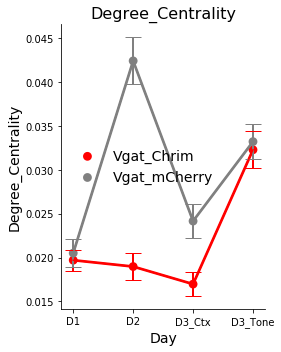

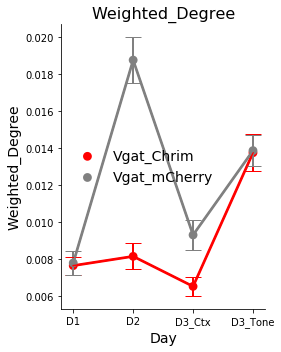

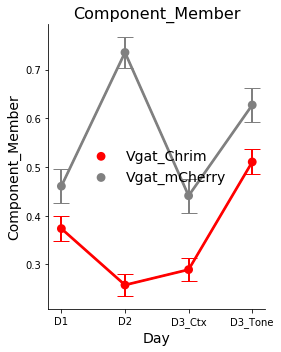

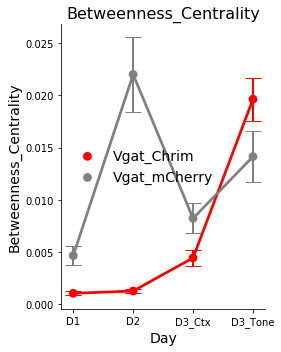

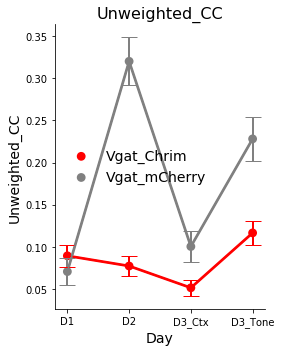

In [20]:

df=graph_measures_df[graph_measures_df.Ctx_Group=='Fear_Ctx'].copy()
df = df[df.Mouse != 'mouse_3']
varlist = ['Degree_Centrality','Weighted_Degree','Component_Member','Betweenness_Centrality','Unweighted_CC']

for var in varlist:
    f,ax = plt.subplots(figsize=(4,5));
    sns.pointplot(x='Day',y=var,data=df,ci=None,hue = 'Mouse_Group', hue_order = ['Vgat_Chrim','Vgat_mCherry'],palette=sns.color_palette(['red','grey']));
    plt.legend(fontsize=14,frameon=False);
    
    #calculate means and se for error bar
    fear_df = df[df.Mouse_Group=='Vgat_Chrim']
    #fear_df = fear_df[~fear_df.Mouse.isin(['mouse_7'])]
    neutral_df = df[df.Mouse_Group=='Vgat_mCherry']
    #neutral_df = neutral_df[~neutral_df.Mouse.isin(['mouse_10','mouse_55'])]
    fear_means= fear_df.groupby('Day')[var].mean()
    neutral_means= neutral_df.groupby('Day')[var].mean()

    fear_se = fear_df.groupby('Day')[var].std() / np.sqrt(len(fear_df)/2)
    neutral_se = neutral_df.groupby('Day')[var].std() / np.sqrt(len(neutral_df)/2)
    
    
    xax = [0,1,2,3]
    plt.errorbar(x=xax,y=fear_means,yerr = fear_se,color='red',capsize=8,elinewidth=2);
    plt.errorbar(x=xax,y=neutral_means,yerr = neutral_se,color='grey',capsize=8,elinewidth=2);
    plt.title(var,fontsize=16);
    plt.xlabel('Day',fontsize=14);
    plt.ylabel(var,fontsize=14);
    sns.despine();
    
    plt.tight_layout()
    file_path = 'C:/Users/berryja/Hen_Lab/Jess_CFC_all/Data_Plots/Chrim/'
    if not os.path.isdir(file_path):
        os.makedirs(file_path)
    file_name = 'Chrim_vs_mCherry_D1D2D3_'+var+'.png'
    plt.savefig(file_path+file_name, dpi=300,facecolor='w');


### Calculate Statistics for Inter-Session pairwise changes

In [ ]:
df = graph_measures_df[graph_measures_df.Tone_Group=='Fear_Tone'].copy()
df = df[df.Ctx_Group == 'Neutral_Ctx']
#df=df[(df.Component_D2_Member == 1)]
df_s = df[df.Tone_Shock_Related == 'Tone_Shock Selective']
varlist=['Unweighted_CC','Degree_Centrality','Component_Member']

#days to compare pairwise:
day1 = 'D3_Ctx'
day2 = 'D3_Tone'
for var in varlist:
    print(var)
    
    print('tone_shock cells')
    ss.ttest_rel(df_s[df_s.Day==day1][var],df_s[df_s.Day==day2][var])
    ss.wilcoxon(df_s[df_s.Day==day1][var],df_s[df_s.Day==day2][var])

    df_sn = df[df.Tone_Shock_Related == 'Tone_Shock Neighbor']
    var='Unweighted_CC'
    print('tone_shock neighbor')
    ss.ttest_rel(df_sn[df_sn.Day==day1][var],df_sn[df_sn.Day==day2][var])
    ss.wilcoxon(df_sn[df_sn.Day==day1][var],df_sn[df_sn.Day==day2][var])


    df_ns = df[df.Tone_Shock_Related == 'Tone_Shock Unrelated']
    print('tone_shock unrelated')
    ss.wilcoxon(df_ns[df_ns.Day==day1][var],df_ns[df_ns.Day==day2][var])

### Plot Distributions of a measure for different Shock_Related Groups

In [ ]:
var='Unweighted_CC'
df = graph_measures_df[graph_measures_df.Tone_Group=='Fear_Tone']
df = df[df.Day=='D3_Tone']
plt.subplots(figsize=(7,7));
a=df[df.Tone_Shock_Related=='Tone_Shock Selective'].loc[:,'Unweighted_CC']
b=df[df.Tone_Shock_Related=='Tone_Shock Neighbor'].loc[:,'Unweighted_CC']
c = df.loc[:,'Unweighted_CC']
#sns.distplot(a,bins=10,kde=False,norm_hist=True)
#sns.distplot(b,bins=10,kde=False,norm_hist=True)
#sns.distplot(c,bins=10,kde=False,norm_hist=True)
h='Tone_Shock_Related'
sns.violinplot(x='Day',y=var,data=df,hue = h,cut=0,bw=.5);
sns.despine();
plt.tight_layout();
file_name = h+'_'+var+'3groups.png';
#plt.savefig(file_path+file_name, dpi=300,facecolor='w');

## Check for correlations between Correlated Activity and Freezing

#### Load Freezing Behavior data

In [ ]:
behavior = pd.read_csv(find_file("Hen_Lab/Jess_CFC_all/Mice_Tones", "Freezing_Percent_AllDays.csv"), header=0)
#behavior = pd.read_csv(find_file("Hen_Lab/Jess_CFC_all/", "Freezing_Percent_D2.csv"), header=0)

#add 'mouse_' to mouse names to make consistent with graph dataframes
mice_nums = list(behavior.Mouse)
mice_names = ['mouse_'+ str(i) for i in mice_nums]
behavior.Mouse = pd.Series(data=mice_names)
behavior.loc[:,'D3_Increase'] = behavior.D3_Tone - behavior.D2
behavior.loc[:,'D2_Increase'] = behavior.D2 - behavior.D1
behavior

###  Make DataFrame of measures to compare with behavior

In [ ]:
#to try
    # avg cell measures:all vs shock vs neighbor vs 'shock related' change in: degree, component member, betweenness, unweighted_cc
    # graph measures: global efficiency, small worldness (?)

#to try
    # avg cell measures:all vs shock vs neighbor vs 'shock related' change in: degree, component member, betweenness, unweighted_cc
    # graph measures: global efficiency, small worldness (?)


mouse_names = fear_ctx_mice_ids
measures = ['Unweighted_CC','Degree_Centrality','Component_Member','Betweenness_Centrality','D2_D3Tone_Comp_Overlap'] #Columns in graph_measures_df
tone_cell_identities = ['Tone_Shock Selective','Tone_Shock Neighbor','Tone_Shock Unrelated'] #values in Tone_Shock_Related column
ctx_cell_identities = ['Ctx_Shock Selective','Ctx_Shock Neighbor','Ctx_Shock Unrelated'] #values in Ctx_Shock_Related column

ctx_tone_cell_identities = ['Ctx_Tone Shock Selective', 'Ctx_Tone Shock Neighbor', 'Ctx_Tone Shock Unrelated']
ctx_only_cell_identities = ['Ctx_Only Shock Selective', 'Ctx_Only Shock Neighbor', 'Ctx_Only Shock Unrelated']
tone_only_cell_identities = ['Tone_Only Shock Selective', 'Tone_Only Shock Neighbor', 'Tone_Only Shock Unrelated']

day1 = 'D1'
day2 = 'D2'


measures_dict = dict()
for m in measures:
    measures_dict[m] = dict()
    measures_dict[m]['All'] = dict()
    measures_dict[m]['Tone_Shock_Related'] = dict()
    measures_dict[m]['Ctx_Shock_Related'] = dict()
    measures_dict[m]['Tone_Only_Shock_Related'] = dict()
    measures_dict[m]['Ctx_Only_Shock_Related'] = dict()
    measures_dict[m]['Ctx_Tone_Shock_Related'] = dict()
    #All cells
    for mouse in mouse_names:
        mouse_name = 'mouse_' + mouse
        df=graph_measures_df.copy()
        df = df[df.Mouse==mouse_name] 
        
        if m == 'D2_D3Tone_Comp_Overlap':
            df1 = df[df.Day=='D2']
            df2 = df[df.Day == 'D3_Tone']
            sum_df = list(df1.Component_Member + df2.Component_Member)
            sum_df = [int(i/2) for i in sum_df]
            measures_dict[m]['All'][mouse_name] = sum(sum_df)/float(len(sum_df))

        else:       
            df1 = df[df.Day==day1] #Day 1 Graph Measure df
            df2 = df[df.Day==day2] #Day 2 Graph Measure df
            diffs = df2[m] - df1[m]
            if len(diffs>0):
                measures_dict[m]['All'][mouse_name] = sum(diffs)/float(len(diffs))    
            else:
                measures_dict[m]['All'][mouse_name] = np.NaN

            
    #Tone_Shock Related cells
    for mouse in mouse_names:
        mouse_name = 'mouse_' + mouse
        df=graph_measures_df.copy()
        df = df[df.Mouse==mouse_name] 
        
        if m == 'D2_D3Tone_Comp_Overlap':
            df1 = df[df.Day=='D2']
            df2 = df[df.Day == 'D3_Tone']
            
            df1_r = df1[df1.Tone_Shock_Related != 'Tone_Shock Unrelated']
            df2_r = df2[df2.Tone_Shock_Related != 'Tone_Shock Unrelated']
            
            sum_df = list(df1_r.Component_Member + df2_r.Component_Member)
            sum_df = [int(i/2) for i in sum_df]
            measures_dict[m]['Tone_Shock_Related'][mouse_name] = sum(sum_df)/float(len(sum_df))
        
        else:
            df1 = df[df.Day==day1] #Day 1 Graph Measure df
            df2 = df[df.Day==day2] #Day 2 Graph Measure df

            df1_r = df1[df1.Tone_Shock_Related != 'Tone_Shock Unrelated']
            df2_r = df2[df2.Tone_Shock_Related != 'Tone_Shock Unrelated']
            diffs = df2_r[m] - df1_r[m]

            if len(diffs>0):
                measures_dict[m]['Tone_Shock_Related'][mouse_name] = sum(diffs)/float(len(diffs))    
            else:
                measures_dict[m]['Tone_Shock_Related'][mouse_name] = np.NaN

    #Ctx_Shock Related cells
    for mouse in mouse_names:
        mouse_name = 'mouse_' + mouse
        df=graph_measures_df.copy()
        df = df[df.Mouse==mouse_name] 
        
        if m == 'D2_D3Tone_Comp_Overlap':
            df1 = df[df.Day=='D2']
            df2 = df[df.Day == 'D3_Tone']
            
            df1_r = df1[df1.Ctx_Shock_Related != 'Ctx_Shock Unrelated']
            df2_r = df2[df2.Ctx_Shock_Related != 'Ctx_Shock Unrelated']
            
            sum_df = list(df1_r.Component_Member + df2_r.Component_Member)
            sum_df = [int(i/2) for i in sum_df]
            measures_dict[m]['Ctx_Shock_Related'][mouse_name] = sum(sum_df)/float(len(sum_df))
        
        else:
            df1 = df[df.Day==day1] #Day 1 Graph Measure df
            df2 = df[df.Day==day2] #Day 2 Graph Measure df

            df1_r = df1[df1.Ctx_Shock_Related != 'Ctx_Shock Unrelated']
            df2_r = df2[df2.Ctx_Shock_Related != 'Ctx_Shock Unrelated']
            diffs = df2_r[m] - df1_r[m]

            if len(diffs)>0:
                measures_dict[m]['Ctx_Shock_Related'][mouse_name] = sum(diffs)/float(len(diffs))    
            else:
                measures_dict[m]['Ctx_Shock_Related'][mouse_name] = np.NaN
                
    #Tone ONLY Shock Selective cells
    for mouse in mouse_names:
        mouse_name = 'mouse_' + mouse
        df=graph_measures_df.copy()
        df = df[df.Mouse==mouse_name] 
        df = df[df.Tone_Only_Shock_Related != 'Tone_Only Shock Unrelated']
        if m == 'D2_D3Tone_Comp_Overlap':
            df1 = df[df.Day=='D2']
            df2 = df[df.Day == 'D3_Tone']
            
            sum_df = list(df1.Component_Member + df2.Component_Member)
            sum_df = [int(i/2) for i in sum_df]
            measures_dict[m]['Tone_Only_Shock_Related'][mouse_name] = sum(sum_df)/float(len(sum_df))
        
        else:
            df1 = df[df.Day==day1] #Day 1 Graph Measure df
            df2 = df[df.Day==day2] #Day 2 Graph Measure df

            diffs = df2[m] - df1[m]

            if len(diffs)>0:
                measures_dict[m]['Tone_Only_Shock_Related'][mouse_name] = sum(diffs)/float(len(diffs))    
            else:
                measures_dict[m]['Tone_Only_Shock_Related'][mouse_name] = np.NaN

    #Ctx ONLY Shock Related cells
    for mouse in mouse_names:
        mouse_name = 'mouse_' + mouse
        df=graph_measures_df.copy()
        df = df[df.Mouse==mouse_name] 
        df = df[df.Ctx_Only_Shock_Related != 'Ctx_Only Shock Unrelated']
        if m == 'D2_D3Tone_Comp_Overlap':
            df1 = df[df.Day=='D2']
            df2 = df[df.Day == 'D3_Tone']
            
            sum_df = list(df1.Component_Member + df2.Component_Member)
            sum_df = [int(i/2) for i in sum_df]
            
            if len(sum_df)>0:
                measures_dict[m]['Ctx_Only_Shock_Related'][mouse_name] = sum(sum_df)/float(len(sum_df))
            else:
                measures_dict[m]['Ctx_Only_Shock_Related'][mouse_name] = np.NaN
        
        else:
            df1 = df[df.Day==day1] #Day 1 Graph Measure df
            df2 = df[df.Day==day2] #Day 2 Graph Measure df

            diffs = df2[m] - df1[m]

            if len(diffs)>0:
                measures_dict[m]['Ctx_Only_Shock_Related'][mouse_name] = sum(diffs)/float(len(diffs))    
            else:
                measures_dict[m]['Ctx_Only_Shock_Related'][mouse_name] = np.NaN

   
    #Ctx_Tone Shock Related (SS) cells
    for mouse in mouse_names:
        mouse_name = 'mouse_' + mouse
        df=graph_measures_df.copy()
        df = df[df.Mouse==mouse_name] 
        df = df[df.Ctx_Tone_Shock_Related != 'Ctx_Tone Shock Unrelated']
        if m == 'D2_D3Tone_Comp_Overlap':
            df1 = df[df.Day=='D2']
            df2 = df[df.Day == 'D3_Tone']
            
            sum_df = list(df1.Component_Member + df2.Component_Member)
            sum_df = [int(i/2) for i in sum_df]
            
            if len(sum_df)>0:
                measures_dict[m]['Ctx_Tone_Shock_Related'][mouse_name] = sum(sum_df)/float(len(sum_df))
            else:
                measures_dict[m]['Ctx_Tone_Shock_Related'][mouse_name] = np.NaN
        
        else:
            df1 = df[df.Day==day1] #Day 1 Graph Measure df
            df2 = df[df.Day==day2] #Day 2 Graph Measure df

            diffs = df2[m] - df1[m]

            if len(diffs)>0:
                measures_dict[m]['Ctx_Tone_Shock_Related'][mouse_name] = sum(diffs)/float(len(diffs))    
            else:
                measures_dict[m]['Ctx_Tone_Shock_Related'][mouse_name] = np.NaN


                
    #for 'Tone Shock Selective', 'Tone Shock Neighbor', and 'Tone Shock Unrelated'
    for c in tone_cell_identities:
        measures_dict[m][c] = dict()
        for mouse in mouse_names:
            mouse_name = 'mouse_' + mouse
            df=graph_measures_df.copy()
            df = df[df.Mouse==mouse_name] 
                 
            if m == 'D2_D3Tone_Comp_Overlap':
                df1 = df[df.Day=='D2']
                df2 = df[df.Day == 'D3_Tone']
                
                df1_c = df1[df1.Tone_Shock_Related == c]
                df2_c = df2[df2.Tone_Shock_Related == c]
                
                sum_df = list(df1_c.Component_Member + df2_c.Component_Member)
                sum_df = [int(i/2) for i in sum_df]
                measures_dict[m][c][mouse_name] = sum(sum_df)/float(len(sum_df))
            else:
                df1 = df[df.Day==day1] #Day 1 Graph Measure df
                df2 = df[df.Day==day2] #Day 2 Graph Measure df
                df1_c = df1[df1.Tone_Shock_Related == c]
                df2_c = df2[df2.Tone_Shock_Related == c]
                diffs = df2_c[m] - df1_c[m]

                if len(diffs>0):
                    measures_dict[m][c][mouse_name] = sum(diffs)/float(len(diffs))    
                else:
                    measures_dict[m][c][mouse_name] = np.NaN

    #for 'Ctx_Shock Selective', 'Ctx_Shock Neighbor', and 'Ctx_Shock Unrelated'
    for c in ctx_cell_identities:
        measures_dict[m][c] = dict()
        for mouse in mouse_names:
            mouse_name = 'mouse_' + mouse
            df=graph_measures_df.copy()
            df = df[df.Mouse==mouse_name]  
            if m == 'D2_D3Tone_Comp_Overlap':
                df1 = df[df.Day=='D2']
                df2 = df[df.Day == 'D3_Tone']
                
                df1_c = df1[df1.Ctx_Shock_Related == c]
                df2_c = df2[df2.Ctx_Shock_Related == c]
                
                sum_df = list(df1_c.Component_Member + df2_c.Component_Member)
                sum_df = [int(i/2) for i in sum_df]
                
                if len(sum_df)>0:
                    measures_dict[m][c][mouse_name] = sum(sum_df)/float(len(sum_df))
                else:
                    measures_dict[m][c][mouse_name] = np.NaN
            else:
                df1 = df[df.Day==day1] #Day 1 Graph Measure df
                df2 = df[df.Day==day2] #Day 2 Graph Measure df
                df1_c = df1[df1.Ctx_Shock_Related == c]
                df2_c = df2[df2.Ctx_Shock_Related == c]
                diffs = df2_c[m] - df1_c[m]

                if len(diffs)>0:
                    measures_dict[m][c][mouse_name] = sum(diffs)/float(len(diffs))    
                else:
                    measures_dict[m][c][mouse_name] = np.NaN
                    
     #for 'Ctx_Tone Shock Selective', 'Ctx_Tone Shock Neighbor', and 'Ctx_Tone Shock Unrelated'
    for c in ctx_tone_cell_identities:
        measures_dict[m][c] = dict()
        for mouse in mouse_names:
            mouse_name = 'mouse_' + mouse
            df=graph_measures_df.copy()
            df = df[df.Mouse==mouse_name]  
            if m == 'D2_D3Tone_Comp_Overlap':
                df1 = df[df.Day=='D2']
                df2 = df[df.Day == 'D3_Tone']
                
                df1_c = df1[df1.Ctx_Tone_Shock_Related == c]
                df2_c = df2[df2.Ctx_Tone_Shock_Related == c]
                
                sum_df = list(df1_c.Component_Member + df2_c.Component_Member)
                sum_df = [int(i/2) for i in sum_df]
                
                if len(sum_df)>0:
                    measures_dict[m][c][mouse_name] = sum(sum_df)/float(len(sum_df))
                else:
                    measures_dict[m][c][mouse_name] = np.NaN
            else:
                df1 = df[df.Day==day1] #Day 1 Graph Measure df
                df2 = df[df.Day==day2] #Day 2 Graph Measure df
                df1_c = df1[df1.Ctx_Tone_Shock_Related == c]
                df2_c = df2[df2.Ctx_Tone_Shock_Related == c]
                diffs = df2_c[m] - df1_c[m]

                if len(diffs)>0:
                    measures_dict[m][c][mouse_name] = sum(diffs)/float(len(diffs))    
                else:
                    measures_dict[m][c][mouse_name] = np.NaN     
                    

    #for 'Ctx_Only Shock Selective', 'Ctx_Only Shock Neighbor', and 'Ctx_Only Shock Unrelated'
    for c in ctx_only_cell_identities:
        measures_dict[m][c] = dict()
        for mouse in mouse_names:
            mouse_name = 'mouse_' + mouse
            df=graph_measures_df.copy()
            df = df[df.Mouse==mouse_name]  
            if m == 'D2_D3Tone_Comp_Overlap':
                df1 = df[df.Day=='D2']
                df2 = df[df.Day == 'D3_Tone']
                
                df1_c = df1[df1.Ctx_Only_Shock_Related == c]
                df2_c = df2[df2.Ctx_Only_Shock_Related == c]
                
                sum_df = list(df1_c.Component_Member + df2_c.Component_Member)
                sum_df = [int(i/2) for i in sum_df]
                
                if len(sum_df)>0:
                    measures_dict[m][c][mouse_name] = sum(sum_df)/float(len(sum_df))
                else:
                    measures_dict[m][c][mouse_name] = np.NaN
            else:
                df1 = df[df.Day==day1] #Day 1 Graph Measure df
                df2 = df[df.Day==day2] #Day 2 Graph Measure df
                df1_c = df1[df1.Ctx_Only_Shock_Related == c]
                df2_c = df2[df2.Ctx_Only_Shock_Related == c]
                diffs = df2_c[m] - df1_c[m]

                if len(diffs)>0:
                    measures_dict[m][c][mouse_name] = sum(diffs)/float(len(diffs))    
                else:
                    measures_dict[m][c][mouse_name] = np.NaN    
                    

    #for 'Tone_Only Shock Selective', 'Tone_Only Shock Neighbor', and 'Tone_Only Shock Unrelated'
    for c in tone_only_cell_identities:
        measures_dict[m][c] = dict()
        for mouse in mouse_names:
            mouse_name = 'mouse_' + mouse
            df=graph_measures_df.copy()
            df = df[df.Mouse==mouse_name]  
            if m == 'D2_D3Tone_Comp_Overlap':
                df1 = df[df.Day=='D2']
                df2 = df[df.Day == 'D3_Tone']
                
                df1_c = df1[df1.Tone_Only_Shock_Related == c]
                df2_c = df2[df2.Tone_Only_Shock_Related == c]
                
                sum_df = list(df1_c.Component_Member + df2_c.Component_Member)
                sum_df = [int(i/2) for i in sum_df]
                
                if len(sum_df)>0:
                    measures_dict[m][c][mouse_name] = sum(sum_df)/float(len(sum_df))
                else:
                    measures_dict[m][c][mouse_name] = np.NaN
            else:
                df1 = df[df.Day==day1] #Day 1 Graph Measure df
                df2 = df[df.Day==day2] #Day 2 Graph Measure df
                df1_c = df1[df1.Tone_Only_Shock_Related == c]
                df2_c = df2[df2.Tone_Only_Shock_Related == c]
                diffs = df2_c[m] - df1_c[m]

                if len(diffs)>0:
                    measures_dict[m][c][mouse_name] = sum(diffs)/float(len(diffs))    
                else:
                    measures_dict[m][c][mouse_name] = np.NaN    
                    

                    
                    
#degree_df = pd.DataFrame(data=measures_dict['Degree_Centrality'])
#degree_df

In [ ]:
### Calculate R^2 and p values for Behavior againt graph metrics
import scipy.stats as ss
cell_types = ['All','Tone_Shock_Related','Tone_Shock Selective','Tone_Shock Neighbor','Tone_Shock Unrelated',
              'Ctx_Shock_Related','Ctx_Shock Selective','Ctx_Shock Neighbor','Ctx_Shock Unrelated',
              'Tone_Only_Shock_Related','Tone_Only Shock Selective','Tone_Only Shock Neighbor','Tone_Only Shock Unrelated',
              'Ctx_Only_Shock_Related','Ctx_Only Shock Selective','Ctx_Only Shock Neighbor','Ctx_Only Shock Unrelated',
              'Ctx_Tone Shock Selective','Ctx_Tone Shock Neighbor','Ctx_Tone Shock Unrelated',
              'Ctx_Tone_Shock_Related']
beh_var = 'D2_Increase'
r_squared = dict()
corr_pval = dict()
for m in measures:
    df = pd.DataFrame(data=measures_dict[m]).copy()
    df.reset_index(inplace=True)
    df.rename(columns = {'index':'Mouse'},inplace=True)
    print(m)
    df.T
    df = pd.merge(df,behavior,how='left',on='Mouse')
    #df
    r_squared[m]=dict()
    corr_pval[m]=dict()
    for c in cell_types:        
        #ignore mice with NaN 
        this_df = df[[c,beh_var]]
        this_df.dropna(inplace=True)
        r_squared[m][c] = ss.pearsonr(this_df[c],this_df[beh_var])[0]**2
        corr_pval[m][c] = ss.pearsonr(this_df[c],this_df[beh_var])[1]
#r_squared
#corr_pval
rsq_df = pd.DataFrame(data=r_squared)
corr_pval_df = pd.DataFrame(data=corr_pval)

print('R^2')
rsq_df
print('p value')
corr_pval_df

## Plot Behavior vs Graph Metrics

In [ ]:
def corr_plot(x=None,y=None,data=None,title=None,ylabel=None,xlabel='Freezing (%)'):
    f,ax = plt.subplots();
    sns.regplot(x=x,y=y,data=data);
    sns.despine();
    plt.title(title,fontsize=16);
    plt.ylabel(ylabel,fontsize=16);
    plt.xlabel(xlabel,fontsize=16);

In [ ]:
#Correlation Coefficient, Shock Related (highest correlation)
for m in measures:
    for c in cell_types:
        #m='Unweighted_CC'
        #c='Shock_Related'
        df = pd.DataFrame(data=measures_dict[m]).reset_index()
        df.rename(columns = {'index':'Mouse'},inplace=True)
        df = pd.merge(df,behavior,how='left',on='Mouse')
        #df

        corr_plot(x=beh_var,y=c,data=df,title=c,ylabel=m);